# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
generative_dist = "GMM"
GMM_components = 4
learning_rate = 0.00003
scheduler_gamma = [0.7, 0.5, 0.6, 0.6]
scheduler_milestones = [600, 800, 1000, 1300]

GMM_equally_weighted = False
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               GMM_equally_weighted=GMM_equally_weighted, GMM_components=GMM_components,
                               scheduler_gamma=scheduler_gamma, scheduler_milestones=scheduler_milestones)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM4NEW_lr3e-05_S60080010001300_07050606.pth


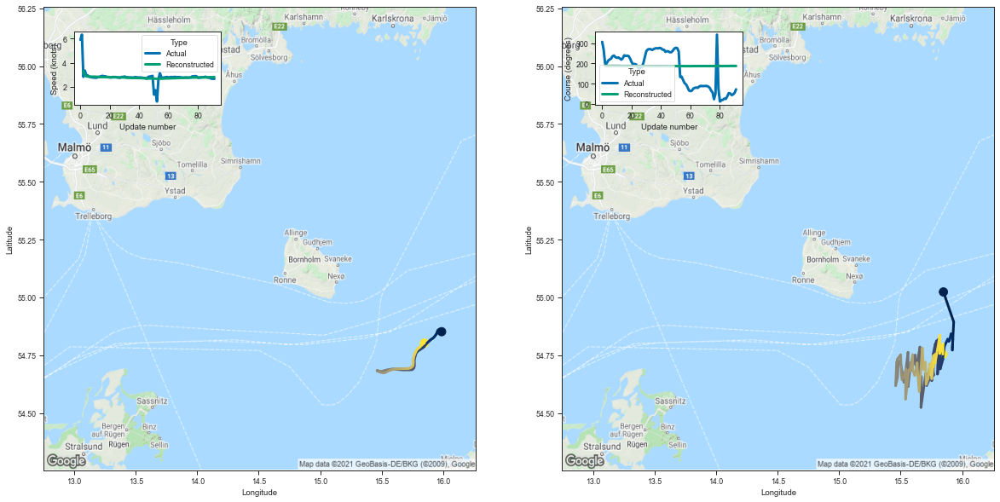

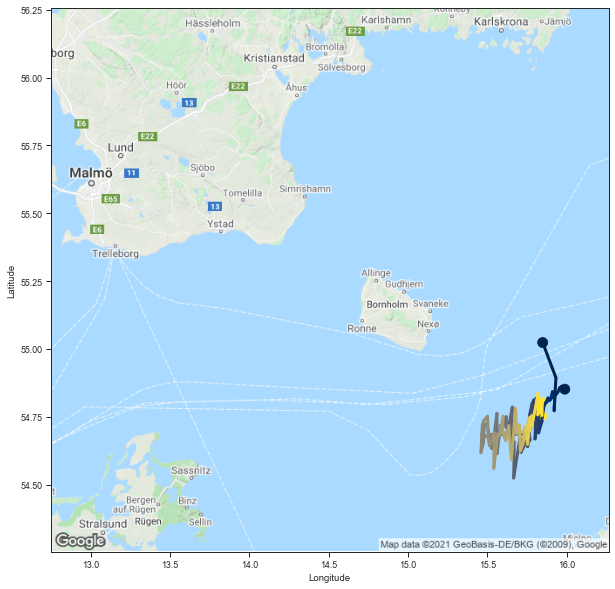

    Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                0  3713619  261003310  15.987299  54.851490  5.902778   
1                0  3713619  261003310  15.965716  54.861137  6.331859   
2                0  3713619  261003310  15.955268  54.856483  2.834615   
3                0  3713619  261003310  15.950625  54.848911  3.352083   
4                0  3713619  261003310  15.944504  54.841236  2.950617   
..             ...      ...        ...        ...        ...       ...   
87               0  3713619  261003310  15.806211  54.782978  2.762820   
88               0  3713619  261003310  15.815681  54.788219  2.748485   
89               0  3713619  261003310  15.825525  54.793762  2.676471   
90               0  3713619  261003310  15.835583  54.798729  2.679412   
91               0  3713619  261003310  15.847528  54.801979  2.667073   

        Course Ship type  Track length          Time stamp  
0   306.436096   Fishing            92 2019-06-19 

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma,Max mixing index,Max mixing probability
2,15.847976,55.023464,3.313916,187.552444,0.050632,0.160691,3.023660,100.673134,1,1.0
3,15.931691,54.893581,2.963272,187.957642,0.017360,0.067694,2.787013,101.006973,1,1.0
4,15.920946,54.785183,2.874141,187.695038,0.013554,0.057073,2.733477,100.898254,1,1.0
5,15.920496,54.771957,2.861465,187.676865,0.012861,0.054636,2.716518,100.892532,1,1.0
6,15.924603,54.820457,2.851322,187.835281,0.012851,0.053921,2.724810,100.979065,1,1.0
...,...,...,...,...,...,...,...,...,...,...
87,15.810978,54.809689,2.806529,187.623047,0.012450,0.053561,2.723763,100.845779,1,1.0
88,15.818514,54.835705,2.802154,187.675827,0.012377,0.053771,2.729371,100.876366,1,1.0
89,15.817703,54.757114,2.807120,187.531219,0.012356,0.053080,2.719222,100.794296,1,1.0
90,15.844764,54.798023,2.811436,187.634689,0.012345,0.053294,2.718297,100.862343,1,1.0


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM4NEW_lr3e-05_S60080010001300_07050606.pth


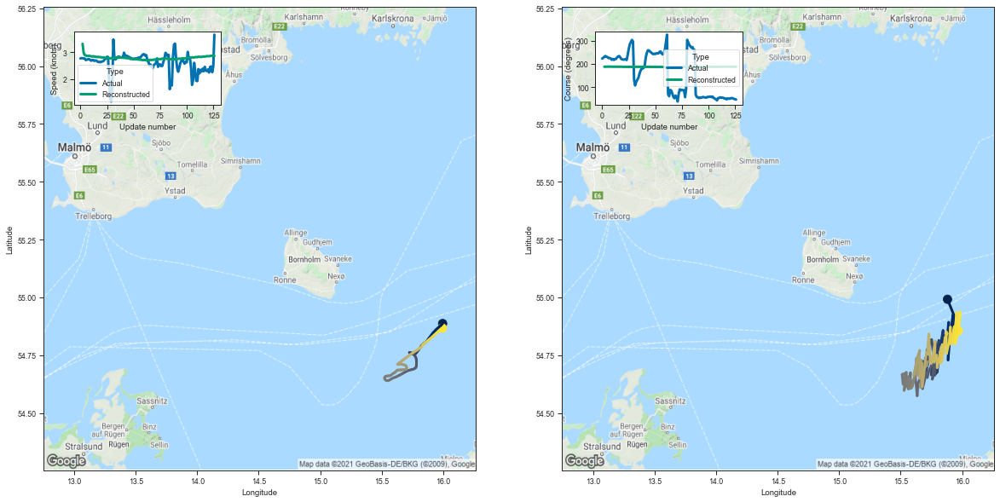

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.881177  54.991680  3.307125  187.558182         0.048621   
3    15.950941  54.899483  2.977246  187.974731         0.017376   
4    15.936555  54.821140  2.891087  187.908997         0.013606   
5    15.945425  54.849869  2.873580  188.009918         0.013108   
6    15.944013  54.911587  2.863733  188.128891         0.013019   
..         ...        ...       ...         ...              ...   
122  15.955891  54.933613  2.858099  188.248947         0.012631   
123  15.943728  54.800648  2.864011  187.864975         0.012620   
124  15.970879  54.857388  2.864423  188.004517         0.012633   
125  15.983324  54.936451  2.875514  188.236755         0.012815   
126  15.968551  54.855522  2.855563  187.990570         0.012641   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.157709     3.000726    100.673462                 1   
3          0.068826     2.788253    101.021210 

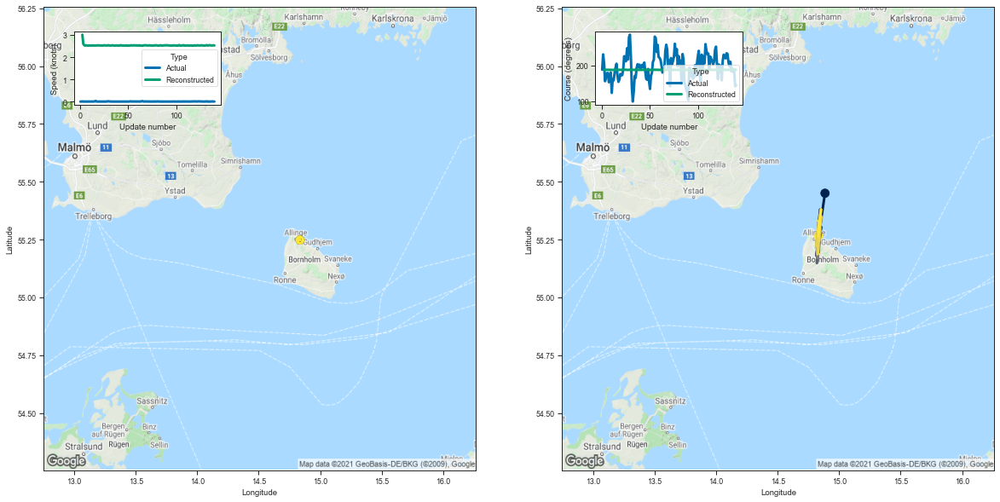

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.885225  55.450321  3.015124  187.260956         0.048753   
3    14.826366  55.239868  2.596924  187.237106         0.015963   
4    14.839127  55.296875  2.537779  187.494202         0.013318   
5    14.833789  55.299301  2.521586  187.502090         0.012833   
6    14.835841  55.325096  2.536498  187.593018         0.013001   
..         ...        ...       ...         ...              ...   
136  14.846601  55.321301  2.532991  187.623749         0.012844   
137  14.833850  55.282082  2.526029  187.457413         0.012857   
138  14.829720  55.284454  2.527241  187.450439         0.012691   
139  14.853176  55.379890  2.532957  187.752274         0.012734   
140  14.831059  55.264217  2.527400  187.417709         0.012787   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.157333     3.312030    100.401787                 1   
3          0.064267     3.084644    100.498260 

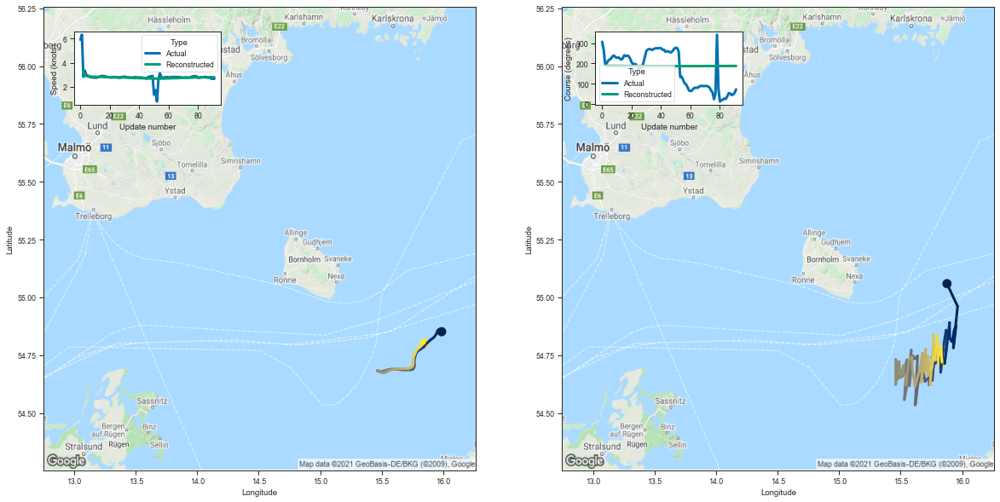

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.876880  55.059284  3.333829  187.620728         0.051005   
3   15.962973  54.961479  2.986176  188.192703         0.017587   
4   15.928833  54.781578  2.890369  187.797577         0.013548   
5   15.950992  54.876663  2.873810  188.094620         0.012967   
6   15.935728  54.860100  2.861205  187.996552         0.012813   
..        ...        ...       ...         ...              ...   
87  15.801501  54.727875  2.797960  187.347687         0.012349   
88  15.817960  54.764969  2.807643  187.536621         0.012340   
89  15.829925  54.788551  2.808509  187.614838         0.012372   
90  15.832909  54.735493  2.800771  187.362366         0.012180   
91  15.836073  54.718727  2.809230  187.409195         0.012397   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.166213     3.011683    100.711105                 1   
3         0.069508     2.789003    101.129601                

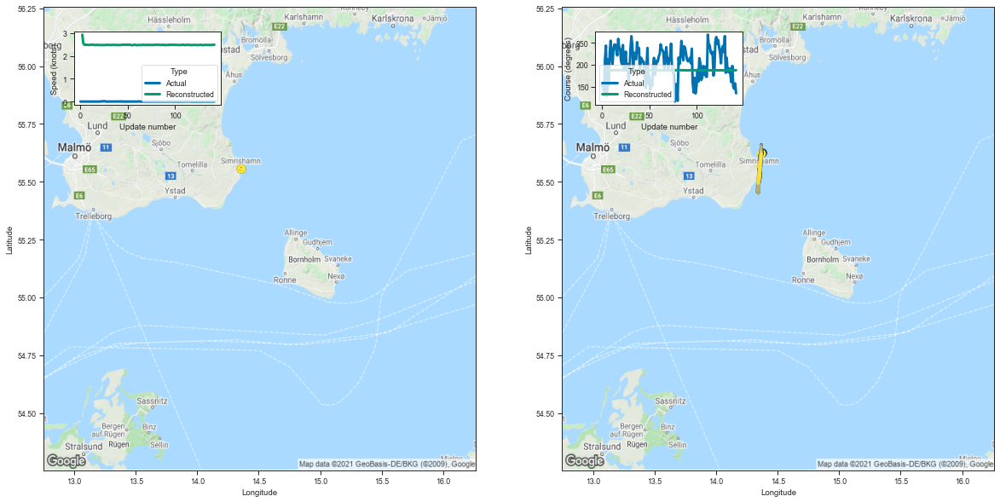

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.377148  55.624001  2.926867  187.227051         0.054025   
3    14.346671  55.562252  2.554451  187.555939         0.019387   
4    14.338816  55.453472  2.486775  187.261642         0.015745   
5    14.351688  55.499573  2.477331  187.396622         0.015335   
6    14.374162  55.637333  2.490927  187.889114         0.015480   
..         ...        ...       ...         ...              ...   
138  14.349886  55.533989  2.471267  187.499435         0.015200   
139  14.354960  55.518543  2.467372  187.489670         0.015213   
140  14.356089  55.533703  2.482970  187.543640         0.015210   
141  14.357753  55.557980  2.478680  187.596039         0.015381   
142  14.368160  55.621269  2.487649  187.800705         0.015336   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.155660     3.567811    100.334671                 1   
3          0.069880     3.350095    100.606590 

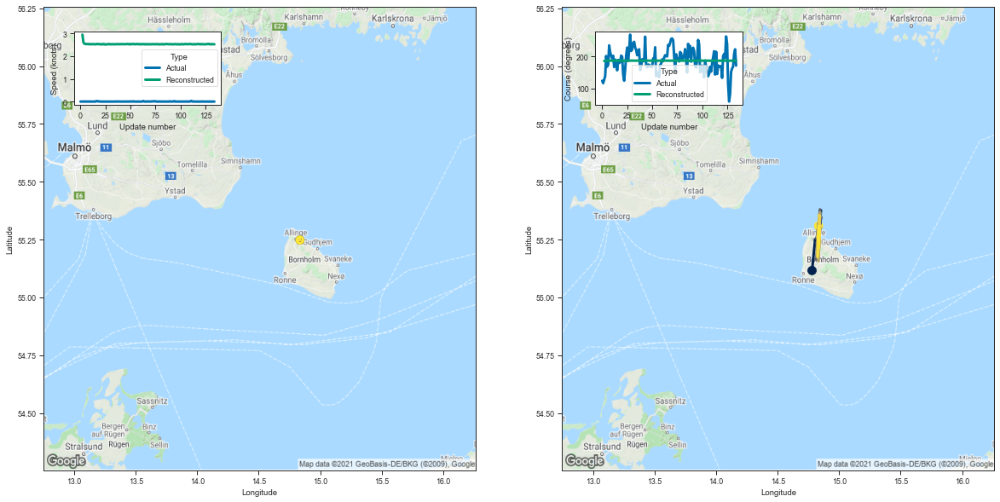

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.779902  55.116013  2.949125  186.310501         0.044284   
3    14.804574  55.248161  2.602186  187.283539         0.016233   
4    14.842708  55.267551  2.548674  187.473160         0.013496   
5    14.830873  55.248779  2.539150  187.356308         0.012972   
6    14.821490  55.219975  2.530231  187.247620         0.012945   
..         ...        ...       ...         ...              ...   
130  14.831276  55.220703  2.522460  187.231781         0.012801   
131  14.834217  55.215466  2.529084  187.245956         0.012864   
132  14.841098  55.289154  2.528522  187.476624         0.012854   
133  14.829983  55.236893  2.529265  187.348022         0.012872   
134  14.832918  55.308491  2.524460  187.480835         0.012711   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.141764     3.280190     99.899796                 1   
3          0.064716     3.092414    100.512581 

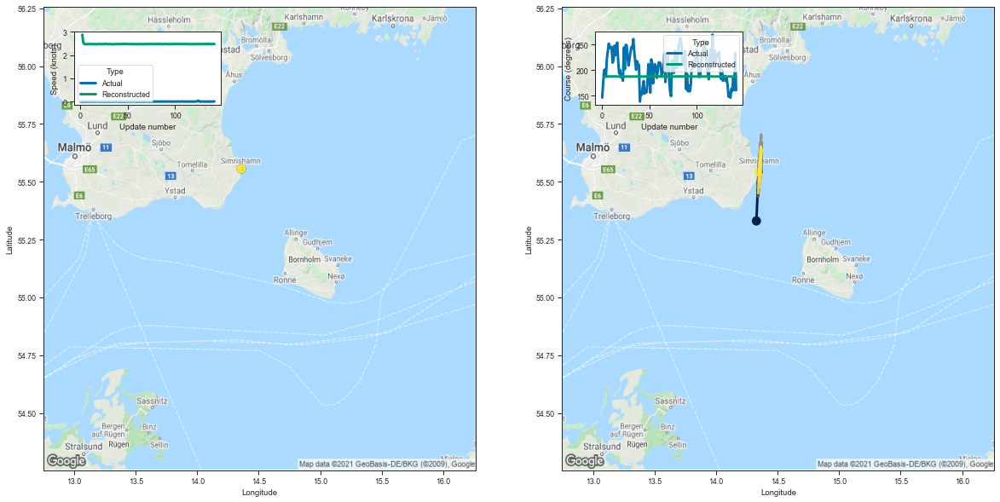

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.327577  55.330563  2.881670  186.297134         0.050742   
3    14.346530  55.567162  2.539907  187.624283         0.018775   
4    14.340105  55.478859  2.477636  187.360336         0.015822   
5    14.340605  55.448311  2.469459  187.234528         0.015225   
6    14.364461  55.627834  2.467822  187.806870         0.015171   
..         ...        ...       ...         ...              ...   
138  14.350548  55.499485  2.477835  187.404846         0.015388   
139  14.355899  55.554733  2.477144  187.593048         0.015407   
140  14.364085  55.597248  2.473639  187.719559         0.015173   
141  14.363818  55.650269  2.483588  187.889587         0.015379   
142  14.352628  55.539234  2.478314  187.528046         0.015334   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.148959     3.512024     99.842720                 1   
3          0.068316     3.348566    100.637817 

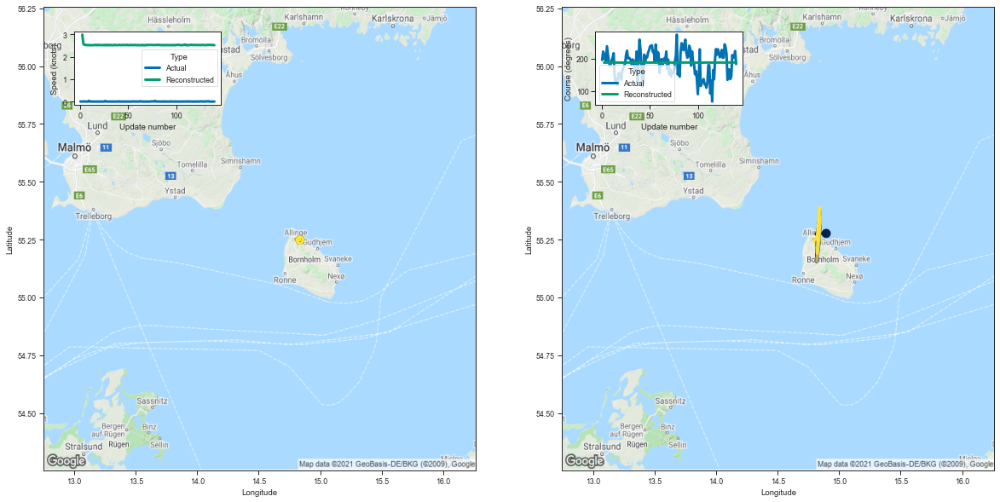

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.894892  55.276463  2.993659  186.907593         0.046032   
3    14.810693  55.275654  2.595964  187.312424         0.016388   
4    14.829194  55.258045  2.538276  187.378403         0.013323   
5    14.843034  55.266678  2.533208  187.471710         0.012943   
6    14.830453  55.276520  2.533578  187.455109         0.012889   
..         ...        ...       ...         ...              ...   
136  14.845254  55.340473  2.534357  187.701599         0.012933   
137  14.836863  55.322639  2.525169  187.581116         0.012803   
138  14.840223  55.388355  2.532629  187.796112         0.012876   
139  14.820321  55.254116  2.526960  187.387772         0.012952   
140  14.826831  55.244480  2.521499  187.317627         0.012700   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146081     3.291899    100.232979                 1   
3          0.065292     3.103020    100.539986 

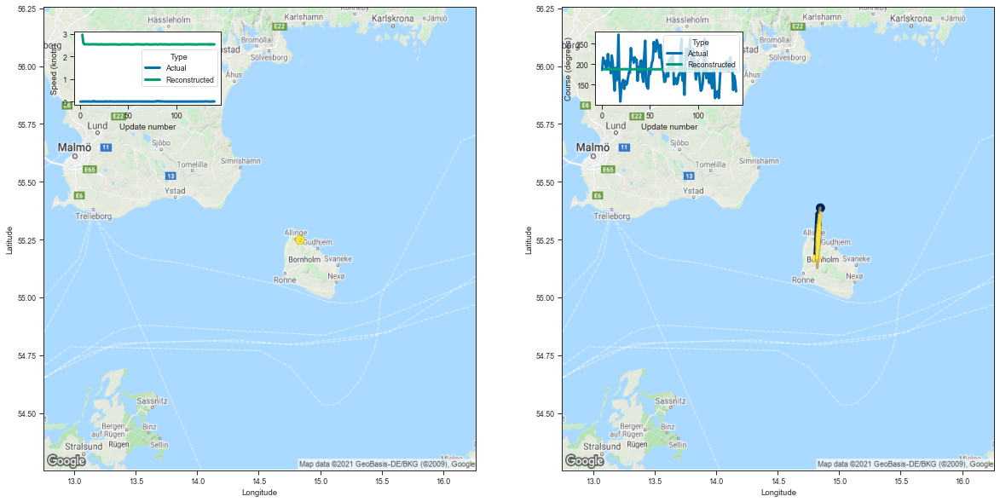

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.847810  55.386700  2.959227  187.164749         0.044744   
3    14.816970  55.361492  2.588979  187.610092         0.016078   
4    14.802799  55.188972  2.530890  187.094452         0.013358   
5    14.829542  55.225338  2.535822  187.282333         0.012941   
6    14.826841  55.215355  2.528774  187.232681         0.012912   
..         ...        ...       ...         ...              ...   
136  14.825216  55.248840  2.519427  187.365799         0.012812   
137  14.827126  55.286175  2.533132  187.493958         0.012884   
138  14.841304  55.310795  2.533701  187.592728         0.012900   
139  14.837724  55.260059  2.518935  187.383377         0.012767   
140  14.817105  55.168282  2.533001  187.065735         0.012832   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144318     3.303670    100.356300                 1   
3          0.064250     3.114047    100.698959 

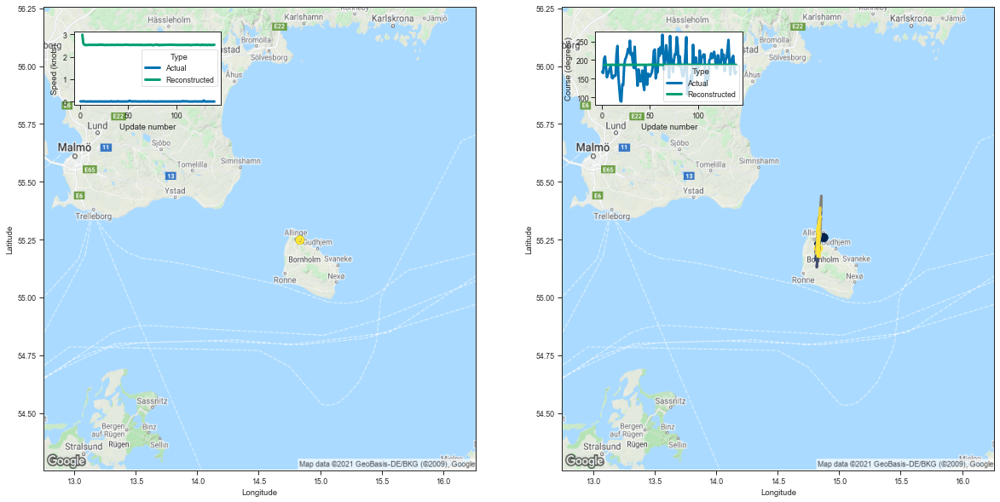

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.875127  55.258194  2.985103  186.828537         0.045416   
3    14.806023  55.231747  2.595993  187.243622         0.016048   
4    14.823397  55.246746  2.541823  187.351166         0.013359   
5    14.828546  55.270042  2.524474  187.370773         0.012981   
6    14.830257  55.224838  2.511969  187.252441         0.012826   
..         ...        ...       ...         ...              ...   
136  14.847116  55.350239  2.520395  187.659668         0.012709   
137  14.820773  55.291508  2.521857  187.464661         0.012810   
138  14.831447  55.279808  2.524591  187.455627         0.012777   
139  14.828171  55.177891  2.527119  187.100891         0.012687   
140  14.831099  55.211094  2.533467  187.236877         0.012822   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145624     3.278039    100.179062                 1   
3          0.063797     3.085597    100.493576 

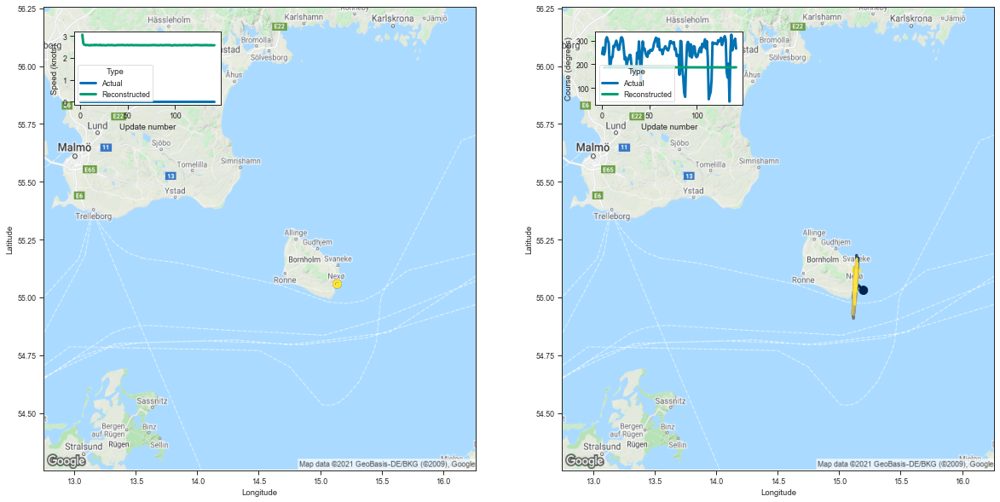

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.197871  55.030525  3.066695  186.691071         0.044391   
3    15.154338  55.053707  2.676882  187.185074         0.015563   
4    15.129084  55.011673  2.605250  187.078644         0.012611   
5    15.137652  55.094257  2.592621  187.434647         0.012172   
6    15.113700  54.994614  2.584048  187.022995         0.012153   
..         ...        ...       ...         ...              ...   
138  15.123153  55.033756  2.576914  187.137939         0.012095   
139  15.138258  55.027050  2.586340  187.128189         0.012103   
140  15.135141  55.055779  2.577129  187.194748         0.012084   
141  15.130374  55.025658  2.578747  187.079514         0.012090   
142  15.139775  55.117294  2.581999  187.433960         0.012147   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144781     3.148857    100.137413                 1   
3          0.063478     2.959008    100.507835 

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
40,40,3731469,261003310,Fishing,127,-415.239105,-3.269599
102,102,2204657,230069190,Fishing,141,-463.672424,-3.288457
45,45,3713619,261003310,Fishing,92,-303.273590,-3.296452
74,74,6962046,265759000,Fishing,143,-476.564941,-3.332622
8,8,1943886,230069190,Fishing,135,-450.653687,-3.338175
60,60,6869996,265759000,Fishing,143,-489.656189,-3.424169
70,70,2240973,230069190,Fishing,141,-482.954895,-3.425212
4,4,2259131,230069190,Fishing,141,-485.080627,-3.440288
98,98,2159262,230069190,Fishing,141,-485.838257,-3.445661
39,39,876715,211474000,Fishing,143,-498.985901,-3.489412


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(tracks['Reconstructed trajectory'])
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM4NEW_lr3e-05_S60080010001300_07050606.pth


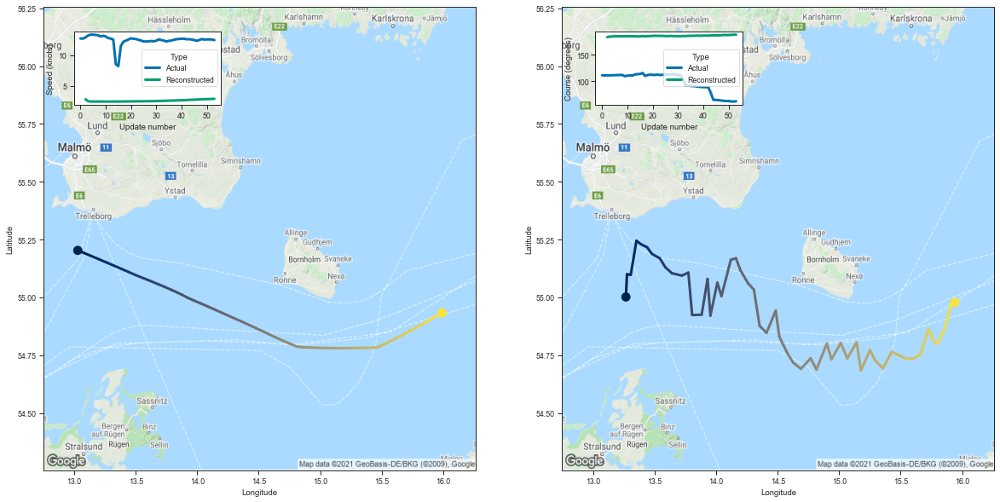

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.266623  55.001785  2.804824  183.558624         0.080889   
3   13.275417  55.099766  2.481527  184.639557         0.031303   
4   13.305881  55.097675  2.434601  184.844391         0.025891   
5   13.352472  55.244789  2.440145  185.315964         0.025392   
6   13.388418  55.230083  2.432887  185.300537         0.024532   
7   13.438996  55.216534  2.443002  185.323502         0.024070   
8   13.476461  55.188709  2.430030  185.255676         0.023321   
9   13.541874  55.168900  2.440037  185.341629         0.022879   
10  13.588764  55.129204  2.433439  185.249588         0.022017   
11  13.640948  55.104370  2.432719  185.236160         0.021271   
12  13.720962  55.093956  2.429495  185.299438         0.020607   
13  13.774475  55.106998  2.442680  185.462189         0.020024   
14  13.805292  54.923649  2.434997  184.896576         0.019555   
15  13.882266  54.924671  2.432672  185.005341         0.01852

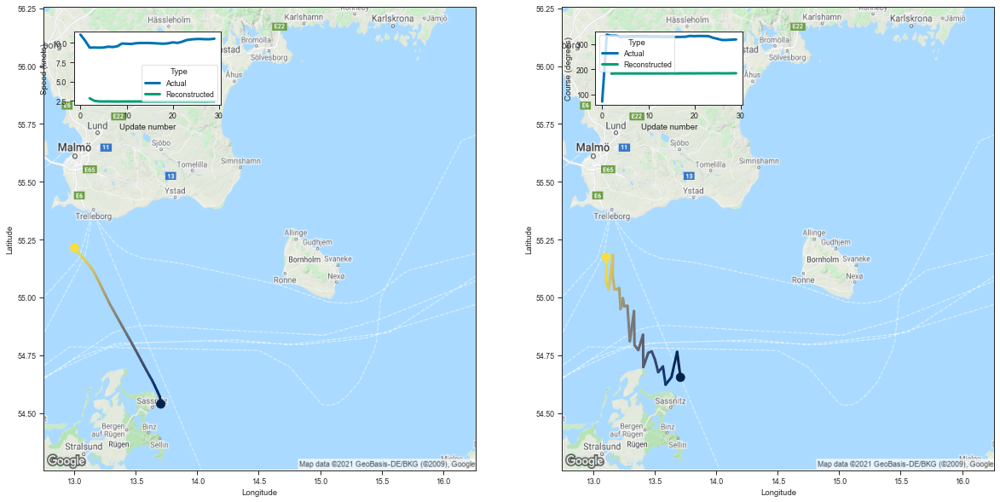

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.710319  54.653946  2.837455  183.254211         0.068249   
3   13.682953  54.764057  2.508786  184.105087         0.026337   
4   13.637126  54.654915  2.430830  183.896439         0.021620   
5   13.589230  54.622555  2.421392  183.712524         0.021447   
6   13.567487  54.700878  2.428704  183.980148         0.021689   
7   13.529258  54.676239  2.416965  183.772812         0.021976   
8   13.503851  54.729549  2.410539  183.958069         0.022181   
9   13.477057  54.766151  2.419215  184.030411         0.022560   
10  13.448409  54.759956  2.422497  183.936157         0.022932   
11  13.407965  54.698395  2.416840  183.741440         0.023082   
12  13.405815  54.837879  2.427591  184.154892         0.023581   
13  13.367603  54.772026  2.417391  183.879929         0.024002   
14  13.336352  54.793507  2.412422  183.879089         0.024203   
15  13.332598  54.940445  2.420371  184.374817         0.02480

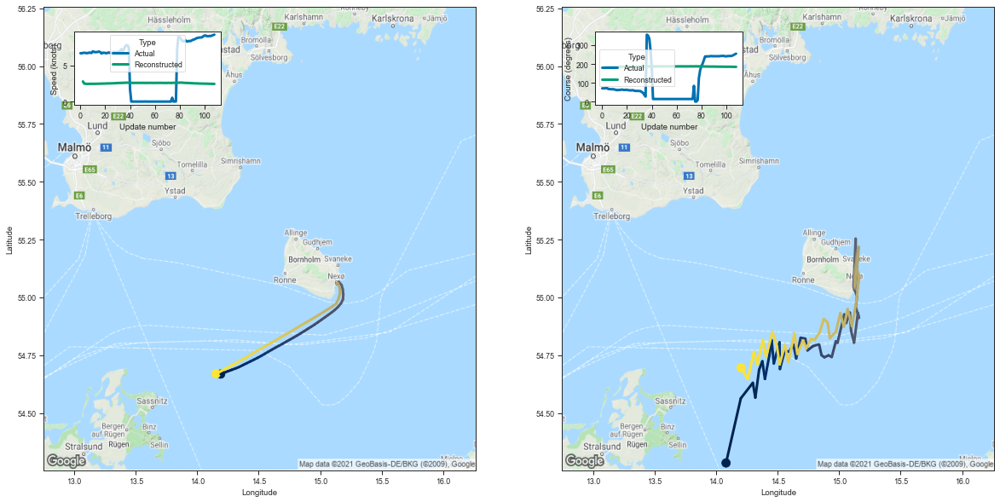

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.080659  54.283794  2.800325  182.937820         0.047358   
3    14.200675  54.563190  2.505173  184.292664         0.018609   
4    14.298586  54.630360  2.469697  184.724014         0.015556   
5    14.318965  54.566296  2.458499  184.527084         0.014945   
6    14.349392  54.686623  2.452140  184.968887         0.014815   
..         ...        ...       ...         ...              ...   
104  14.379909  54.815651  2.469267  185.408401         0.015163   
105  14.334462  54.709915  2.469144  184.981766         0.015193   
106  14.307161  54.764023  2.463441  185.165131         0.015448   
107  14.257423  54.646576  2.449368  184.666901         0.015646   
108  14.202344  54.695541  2.459287  184.764374         0.016039   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.138573     3.423671     98.050331                 1   
3          0.068049     3.224456     98.869949 

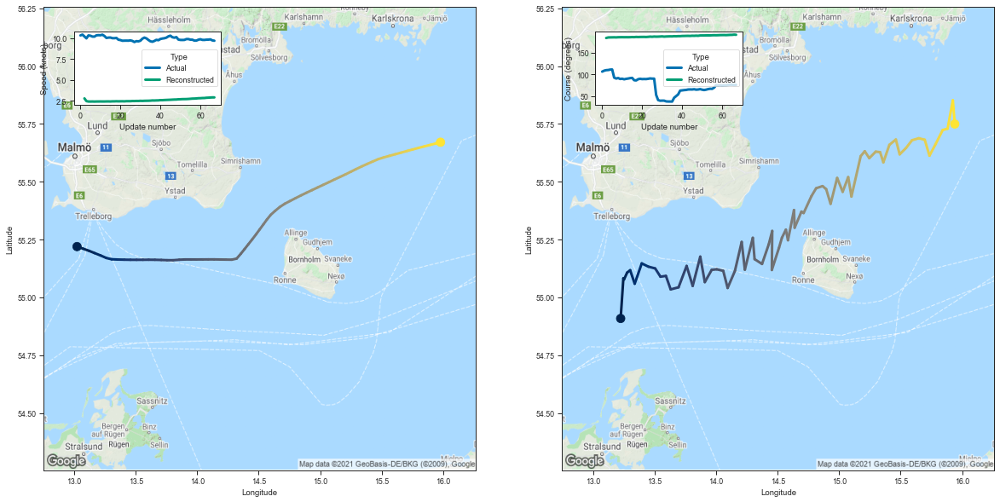

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.224069  54.908680  2.795534  183.310471         0.080430   
3   13.246082  55.082352  2.471092  184.541306         0.031809   
4   13.251306  55.077351  2.423370  184.696503         0.026164   
5   13.276702  55.107071  2.419601  184.783020         0.025449   
6   13.301321  55.117310  2.425513  184.891785         0.025328   
..        ...        ...       ...         ...              ...   
63  15.784940  55.663284  2.871954  190.214722         0.014263   
64  15.841966  55.723679  2.884163  190.483429         0.014220   
65  15.881694  55.729412  2.901384  190.548325         0.014429   
66  15.924636  55.852142  2.916263  191.037476         0.014666   
67  15.939981  55.749676  2.914148  190.681671         0.014382   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.193439     3.952189     98.122543                 1   
3         0.088789     3.829618     98.883026                

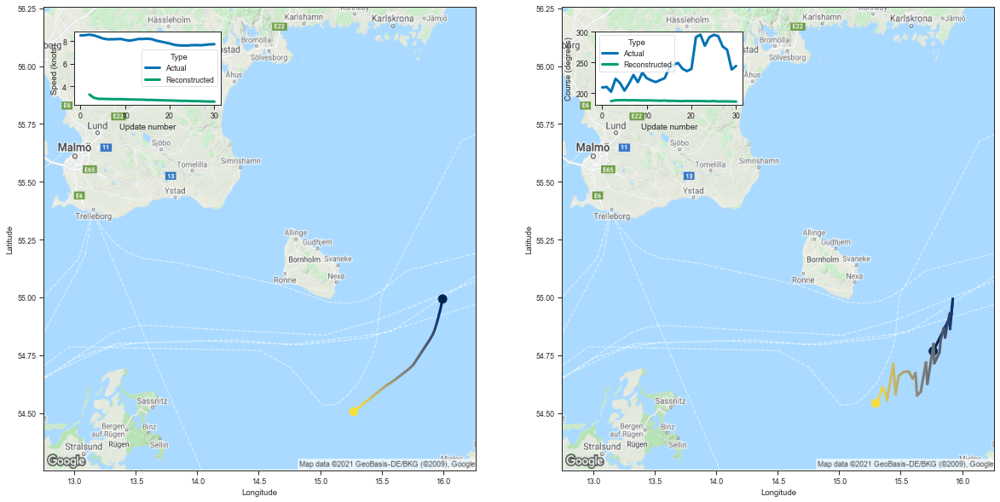

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.764876  54.767323  3.266390  186.755630         0.046229   
3   15.905046  54.917919  2.978485  188.036362         0.017601   
4   15.908698  54.909336  2.883767  188.108643         0.013923   
5   15.924468  54.993977  2.881993  188.391693         0.013467   
6   15.902081  54.863205  2.867169  187.948166         0.013150   
7   15.899885  54.930317  2.863009  188.150543         0.013116   
8   15.879201  54.882191  2.851890  187.980255         0.013122   
9   15.861859  54.826042  2.858700  187.777802         0.013161   
10  15.851054  54.867393  2.837647  187.838669         0.013205   
11  15.825881  54.816372  2.829079  187.737274         0.013109   
12  15.816020  54.761410  2.823493  187.506363         0.012955   
13  15.773937  54.714954  2.813057  187.293716         0.012857   
14  15.767947  54.799263  2.811607  187.563919         0.012913   
15  15.717106  54.625278  2.789660  186.940857         0.01279

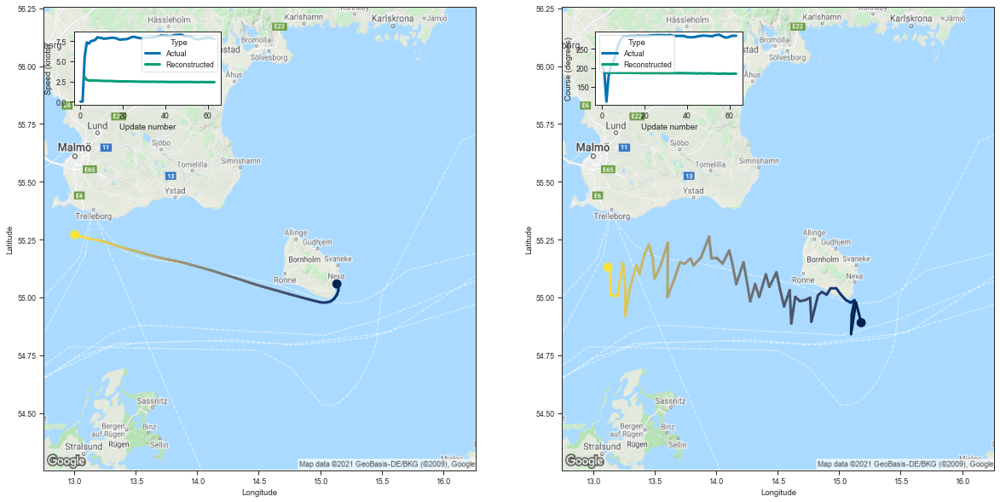

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.179200  54.890617  3.039830  186.206985         0.041754   
3   15.136938  54.977684  2.690328  186.914246         0.015996   
4   15.096962  54.841339  2.622178  186.553711         0.013276   
5   15.102541  54.926777  2.619316  186.827118         0.013052   
6   15.125127  54.987846  2.622270  187.071945         0.012874   
..        ...        ...       ...         ...              ...   
59  13.197330  55.007206  2.418412  184.363098         0.026527   
60  13.160371  55.006290  2.414012  184.270721         0.026784   
61  13.141806  55.012482  2.425373  184.353531         0.027219   
62  13.138570  55.129791  2.416236  184.669754         0.027469   
63  13.120383  55.130547  2.412836  184.616745         0.027915   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.139320     3.129798     99.903603                 1   
3         0.064949     2.978838    100.373215                

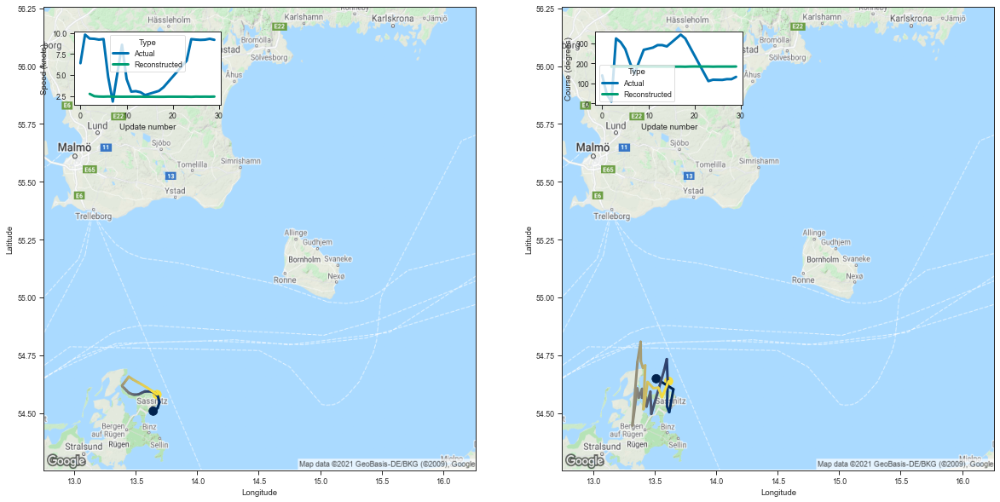

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.513304  54.648201  2.747616  183.101440         0.061421   
3   13.652725  54.602352  2.468762  183.708969         0.024168   
4   13.618950  54.503590  2.424162  183.433792         0.021244   
5   13.600571  54.528416  2.412022  183.439865         0.020935   
6   13.606567  54.632977  2.429615  183.817657         0.021261   
7   13.598937  54.732906  2.414337  184.109268         0.020724   
8   13.578312  54.686806  2.411837  183.941238         0.020932   
9   13.532757  54.603615  2.405975  183.580414         0.021237   
10  13.473210  54.495762  2.407666  183.146973         0.022086   
11  13.465768  54.591908  2.412888  183.446838         0.022306   
12  13.434232  54.527672  2.404426  183.291336         0.022320   
13  13.429588  54.567600  2.410387  183.365662         0.022591   
14  13.397990  54.565701  2.398416  183.260742         0.022907   
15  13.398910  54.604282  2.403471  183.389206         0.02277

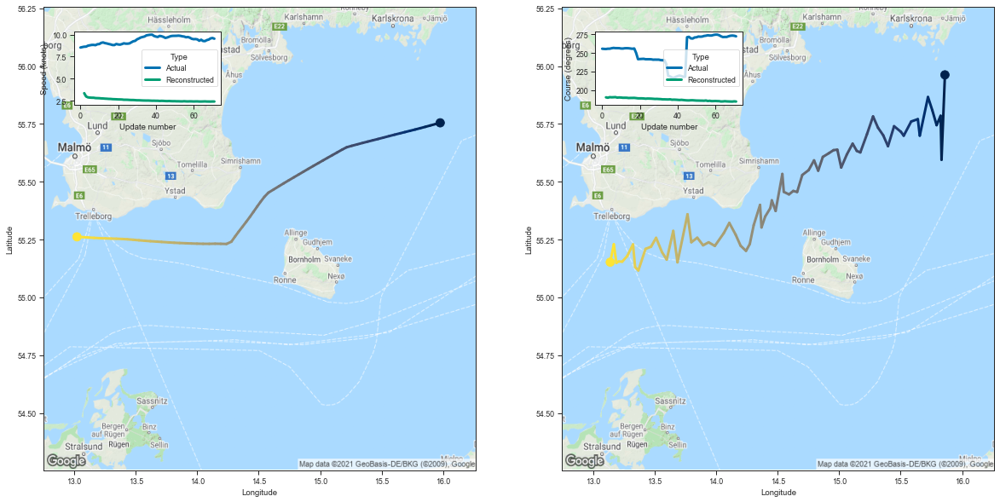

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.860131  55.962208  3.367599  190.440521         0.054969   
3   15.832623  55.595154  2.995169  189.932419         0.019360   
4   15.825308  55.785202  2.895248  190.658096         0.015088   
5   15.792646  55.744717  2.868870  190.473221         0.014406   
6   15.757461  55.809307  2.854606  190.576477         0.014227   
..        ...        ...       ...         ...              ...   
67  13.236507  55.154240  2.424991  184.908951         0.026112   
68  13.208011  55.155308  2.422091  184.822357         0.026569   
69  13.188996  55.149094  2.419094  184.760895         0.027143   
70  13.168631  55.229507  2.426768  185.058014         0.027663   
71  13.139337  55.152168  2.425380  184.810089         0.027688   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.167371     3.185877    102.184380                 1   
3         0.071845     2.961389    102.032509                

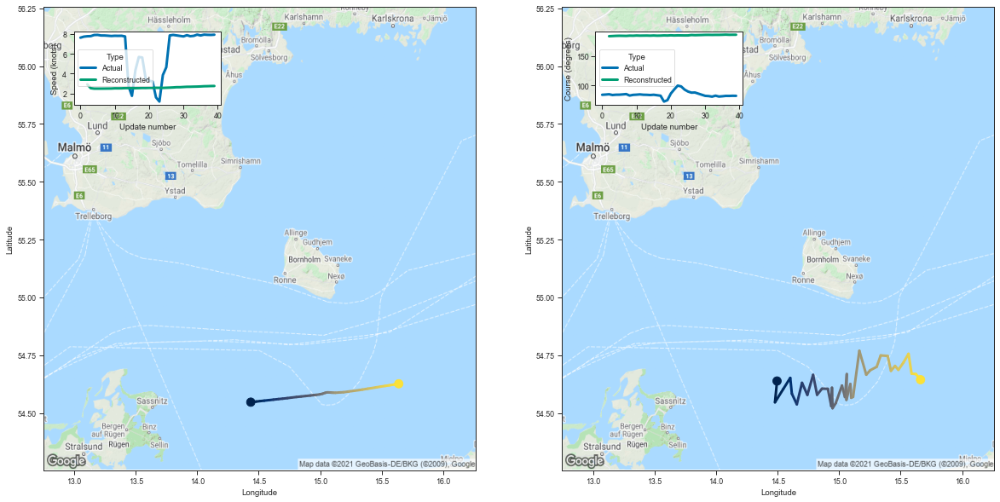

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.495335  54.638184  2.913551  184.404297         0.049349   
3   14.478585  54.546150  2.527391  184.672668         0.017228   
4   14.546332  54.603886  2.484759  185.001175         0.014180   
5   14.602836  54.651711  2.484147  185.141602         0.013738   
6   14.615836  54.583515  2.484420  185.047592         0.013391   
7   14.656257  54.537441  2.487855  184.925079         0.013102   
8   14.698512  54.630413  2.492057  185.327881         0.013180   
9   14.741940  54.578163  2.495265  185.186661         0.012907   
10  14.788655  54.664742  2.515873  185.548767         0.012852   
11  14.820823  54.578491  2.512918  185.322586         0.012661   
12  14.860760  54.605049  2.516619  185.423981         0.012673   
13  14.908452  54.604404  2.535358  185.495178         0.012547   
14  14.936622  54.528870  2.539593  185.299316         0.012478   
15  14.941928  54.609165  2.528188  185.580780         0.01225

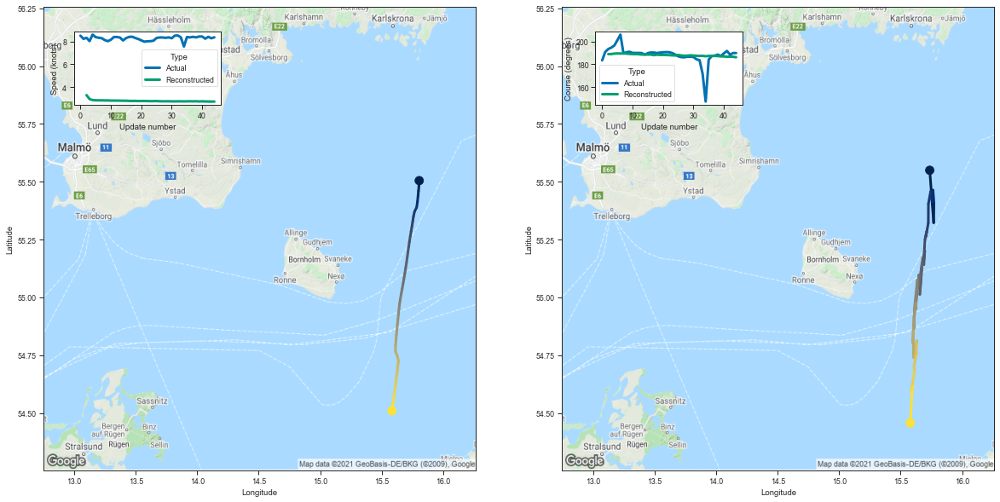

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.736554  55.549549  3.294788  188.933685         0.052662   
3   15.768593  55.322887  2.947451  188.976151         0.018181   
4   15.770908  55.406296  2.859091  189.354218         0.014471   
5   15.763242  55.463619  2.838498  189.522415         0.013963   
6   15.757221  55.413551  2.836362  189.384659         0.013623   
7   15.743839  55.457588  2.835858  189.528366         0.013734   
8   15.725882  55.404488  2.825182  189.336578         0.013583   
9   15.725093  55.321369  2.828120  189.091278         0.013471   
10  15.705306  55.262516  2.812178  188.903885         0.013364   
11  15.711313  55.284363  2.815654  188.914093         0.013398   
12  15.698236  55.251308  2.810335  188.817764         0.013387   
13  15.687877  55.162090  2.807981  188.513901         0.013305   
14  15.696194  55.201481  2.799572  188.632156         0.013268   
15  15.689038  55.141640  2.800385  188.481155         0.01325

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
36,36,7969192,273352230,Fishing,54,-658.076660,-12.186605
101,101,1176042,211755650,Fishing,30,-255.736237,-8.524541
69,69,461902,211317720,Fishing,109,-797.172485,-7.313509
97,97,7993496,273513600,Fishing,68,-492.227600,-7.238641
1,1,4547326,261061000,Fishing,31,-223.851334,-7.221011
37,37,1615516,220339000,Fishing,64,-453.268890,-7.082326
73,73,1113112,211542610,Fishing,30,-207.942505,-6.931417
6,6,7960421,273294000,Fishing,72,-465.362244,-6.463364
67,67,1070020,211474000,Fishing,40,-253.350357,-6.333759
71,71,4377660,261015270,Fishing,45,-266.509186,-5.922426


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    #print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
    print(tracks['Reconstructed trajectory'])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM4NEW_lr3e-05_S60080010001300_07050606.pth


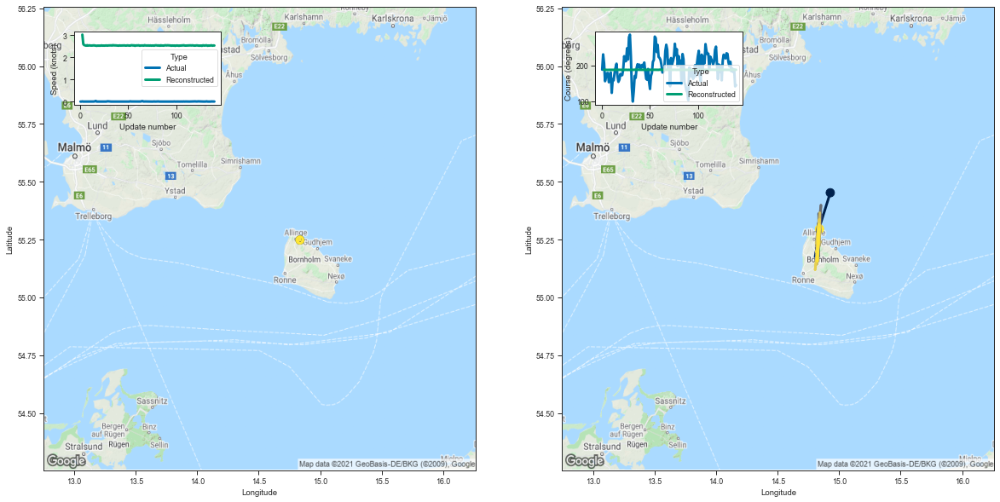

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.928055  55.452347  3.018668  187.368317         0.048061   
3    14.834489  55.293770  2.589464  187.469681         0.015821   
4    14.832952  55.274078  2.544994  187.433792         0.013316   
5    14.830820  55.175083  2.533021  187.132980         0.012868   
6    14.828832  55.214451  2.520331  187.252533         0.012727   
..         ...        ...       ...         ...              ...   
136  14.826606  55.272839  2.530934  187.445511         0.012828   
137  14.832656  55.289883  2.536736  187.480316         0.012947   
138  14.823842  55.156528  2.519706  187.034729         0.012661   
139  14.832656  55.282761  2.529742  187.461365         0.012919   
140  14.840710  55.295864  2.526570  187.554321         0.012793   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.157000     3.292372    100.466743                 1   
3          0.063005     3.090697    100.619019 

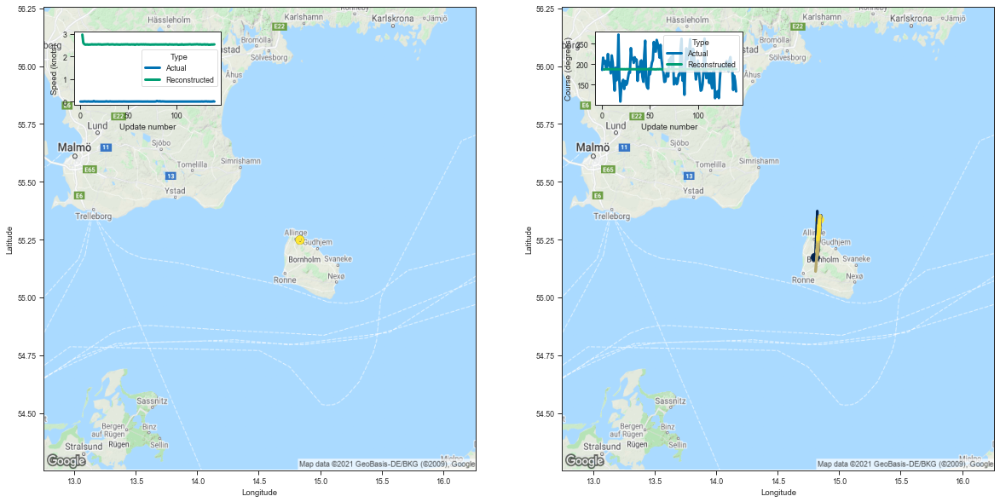

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.806218  55.172871  2.963766  186.566879         0.044317   
3    14.822734  55.372662  2.598949  187.625992         0.016294   
4    14.827787  55.254208  2.545095  187.398178         0.013441   
5    14.830591  55.232380  2.521409  187.314270         0.012834   
6    14.825655  55.258316  2.521919  187.360107         0.012773   
..         ...        ...       ...         ...              ...   
136  14.832143  55.268562  2.519797  187.424911         0.012698   
137  14.824536  55.248466  2.527925  187.327026         0.012742   
138  14.838239  55.311924  2.524494  187.484726         0.012950   
139  14.841069  55.304539  2.527152  187.532990         0.012857   
140  14.841309  55.336422  2.531607  187.629456         0.012870   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.141424     3.298132    100.038345                 1   
3          0.065059     3.115117    100.701416 

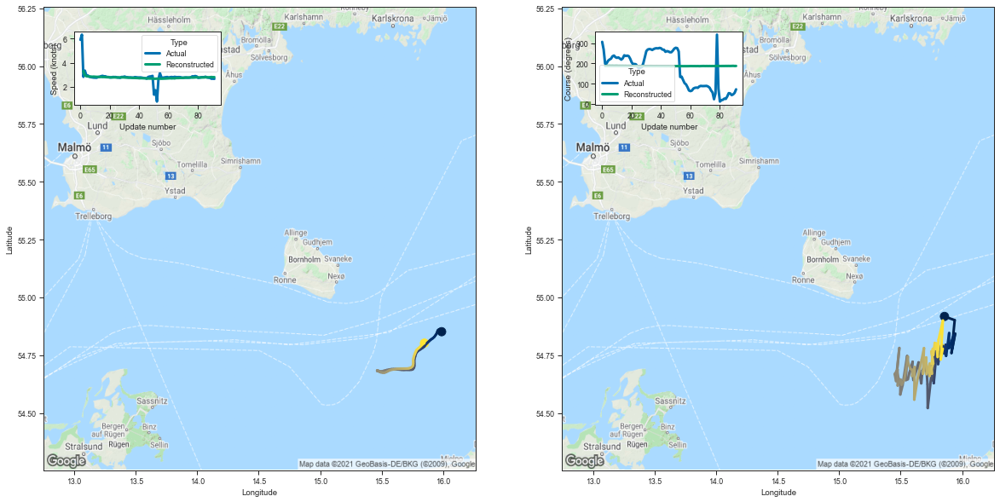

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.856535  54.917503  3.303662  187.224075         0.048522   
3   15.939588  54.901447  2.969933  187.993576         0.017354   
4   15.913464  54.759102  2.887094  187.677155         0.013535   
5   15.943052  54.843243  2.869751  188.000320         0.012978   
6   15.918839  54.776989  2.860484  187.710724         0.012853   
..        ...        ...       ...         ...              ...   
87  15.801098  54.741966  2.790299  187.425842         0.012243   
88  15.808074  54.816101  2.802729  187.659836         0.012402   
89  15.843842  54.899628  2.819617  187.966141         0.012478   
90  15.825425  54.731144  2.802854  187.375244         0.012257   
91  15.842556  54.777863  2.808894  187.546982         0.012322   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.156979     2.991066    100.507553                 1   
3         0.068588     2.789900    101.025841                

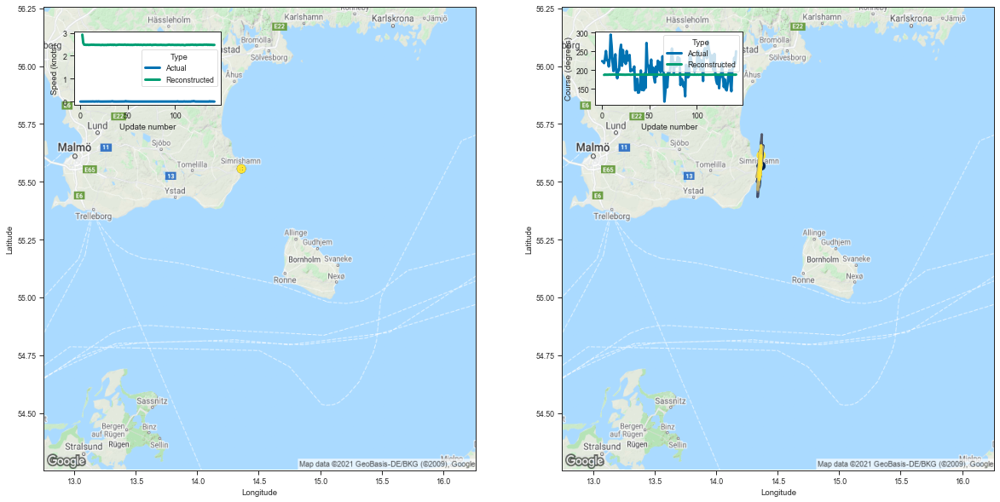

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.365373  55.568192  2.922524  186.941986         0.054693   
3    14.381054  55.655560  2.555261  187.845749         0.019039   
4    14.350716  55.477631  2.481858  187.323807         0.015647   
5    14.360394  55.531796  2.483231  187.538055         0.015569   
6    14.352383  55.521816  2.474229  187.424652         0.015275   
..         ...        ...       ...         ...              ...   
138  14.361713  55.529430  2.480318  187.495056         0.015122   
139  14.354925  55.554470  2.477343  187.625793         0.015348   
140  14.352199  55.508308  2.472189  187.437042         0.015293   
141  14.356030  55.531063  2.472087  187.497681         0.015235   
142  14.366226  55.613914  2.474586  187.794952         0.015143   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.160444     3.548385    100.183647                 1   
3          0.069777     3.352608    100.762344 

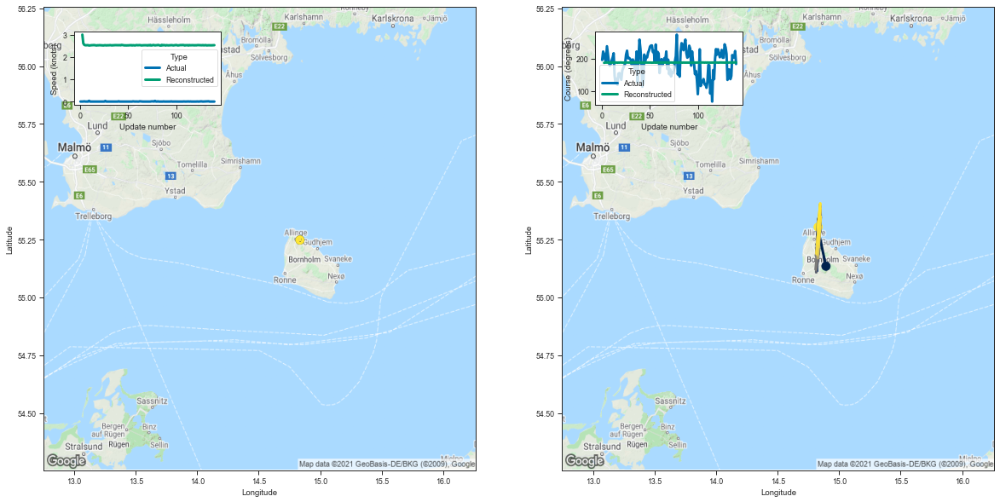

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.893179  55.134781  3.003892  186.472839         0.046927   
3    14.839221  55.267681  2.610634  187.392868         0.016203   
4    14.833228  55.248295  2.545070  187.371857         0.013469   
5    14.832813  55.259361  2.528074  187.366882         0.012984   
6    14.832136  55.187618  2.526628  187.179413         0.012833   
..         ...        ...       ...         ...              ...   
136  14.826999  55.229385  2.523805  187.276001         0.012801   
137  14.837785  55.284943  2.524001  187.480804         0.012900   
138  14.829361  55.299019  2.526485  187.518143         0.012935   
139  14.846562  55.405785  2.529530  187.881409         0.012820   
140  14.829512  55.304142  2.530436  187.524399         0.012923   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.148659     3.277654     99.998749                 1   
3          0.064418     3.087298    100.572350 

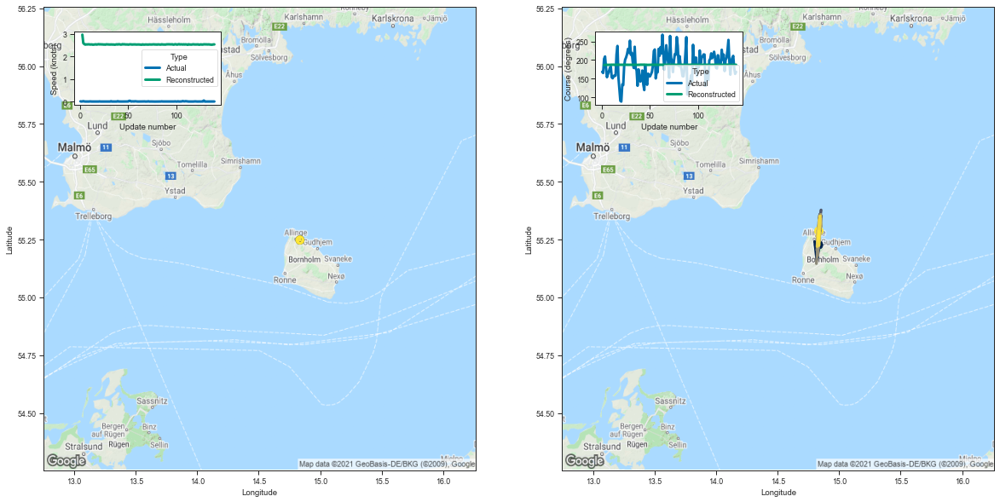

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.832911  55.226711  2.963428  186.695816         0.044908   
3    14.800906  55.240944  2.585985  187.196274         0.015991   
4    14.817419  55.162392  2.546146  187.090179         0.013343   
5    14.842811  55.318008  2.520668  187.502350         0.012790   
6    14.826318  55.172680  2.529845  187.119781         0.012781   
..         ...        ...       ...         ...              ...   
136  14.828295  55.247410  2.519335  187.387360         0.012762   
137  14.830735  55.264008  2.516653  187.377182         0.012721   
138  14.837612  55.284550  2.520365  187.455002         0.012635   
139  14.833744  55.253956  2.529365  187.367996         0.012848   
140  14.835030  55.287334  2.530849  187.480972         0.012965   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.142522     3.278092    100.103592                 1   
3          0.064339     3.098018    100.475159 

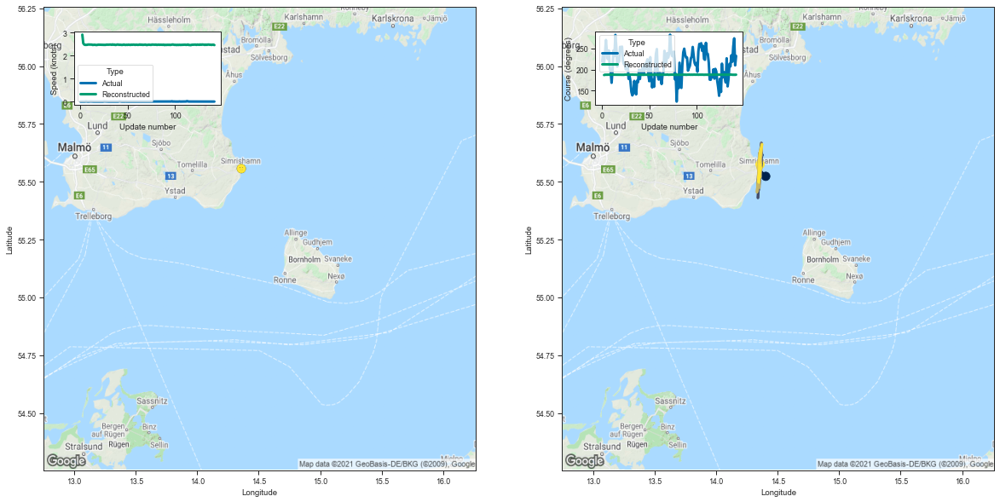

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.403390  55.523434  2.919092  186.820053         0.053814   
3    14.349672  55.553520  2.542532  187.503296         0.018806   
4    14.342435  55.509800  2.487128  187.469604         0.015872   
5    14.356510  55.552956  2.472230  187.586929         0.015390   
6    14.355882  55.567692  2.474733  187.627060         0.015237   
..         ...        ...       ...         ...              ...   
138  14.347632  55.516598  2.480146  187.488968         0.015316   
139  14.345192  55.515636  2.470198  187.459335         0.015291   
140  14.359510  55.565075  2.479918  187.630661         0.015231   
141  14.344813  55.499454  2.480338  187.408310         0.015170   
142  14.357580  55.574829  2.463860  187.653061         0.015274   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.159231     3.517298    100.119408                 1   
3          0.068846     3.344134    100.579117 

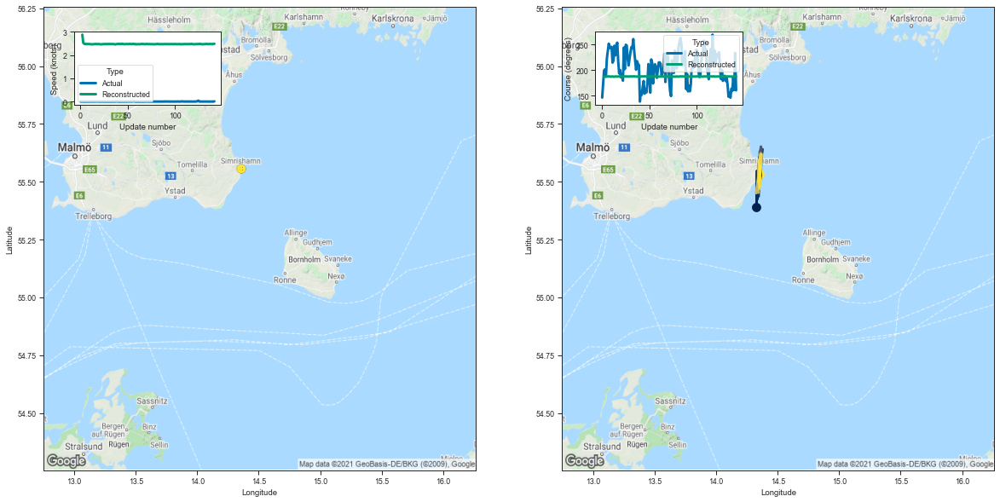

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.328976  55.388538  2.882229  186.475876         0.050770   
3    14.332284  55.546272  2.530496  187.509872         0.018624   
4    14.333968  55.424404  2.488931  187.172028         0.015851   
5    14.362495  55.527042  2.478325  187.503082         0.015256   
6    14.365248  55.571739  2.479278  187.633865         0.015143   
..         ...        ...       ...         ...              ...   
138  14.355247  55.557243  2.480213  187.596680         0.015437   
139  14.353023  55.477623  2.476561  187.341080         0.015174   
140  14.355796  55.529778  2.473865  187.493011         0.015299   
141  14.360399  55.568336  2.483576  187.702866         0.015353   
142  14.356345  55.531891  2.489833  187.541122         0.015226   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.148202     3.523264     99.938828                 1   
3          0.067599     3.358962    100.588669 

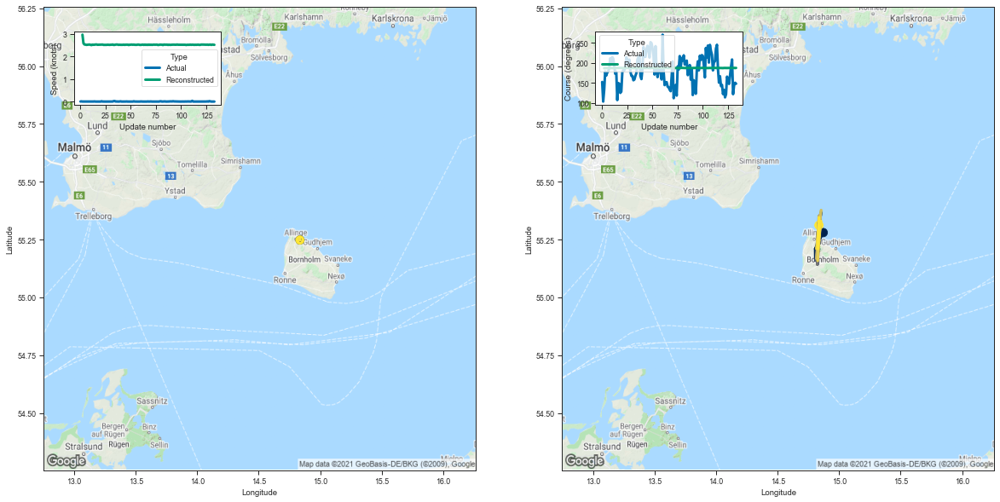

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.870867  55.280132  2.977854  186.739151         0.046735   
3    14.805191  55.210308  2.593079  187.185089         0.016004   
4    14.806680  55.159588  2.537510  187.045761         0.013322   
5    14.833328  55.227013  2.532668  187.293625         0.012869   
6    14.824764  55.232655  2.522107  187.294708         0.012883   
..         ...        ...       ...         ...              ...   
129  14.852753  55.329689  2.536359  187.620651         0.012921   
130  14.829294  55.269363  2.520498  187.373352         0.012963   
131  14.836436  55.345699  2.536312  187.621841         0.012942   
132  14.828691  55.209404  2.530934  187.229843         0.012819   
133  14.835959  55.311897  2.524212  187.599838         0.012805   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149851     3.303331    100.145218                 1   
3          0.062979     3.088527    100.464066 

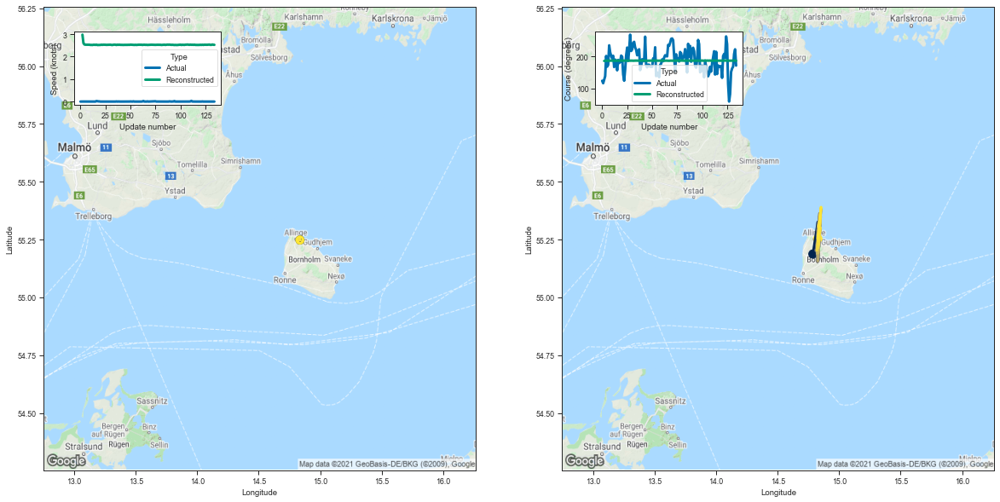

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.786973  55.187447  2.979901  186.479080         0.046906   
3    14.826940  55.325638  2.601840  187.505234         0.016257   
4    14.819014  55.208656  2.539488  187.194168         0.013443   
5    14.844877  55.324726  2.531469  187.572342         0.012947   
6    14.824377  55.245064  2.530320  187.301437         0.012889   
..         ...        ...       ...         ...              ...   
130  14.847898  55.300362  2.524119  187.514603         0.012865   
131  14.828191  55.242718  2.524559  187.304184         0.012797   
132  14.852838  55.389767  2.540185  187.817764         0.012909   
133  14.845895  55.352829  2.529702  187.730087         0.012896   
134  14.826505  55.254230  2.525530  187.322647         0.012830   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147377     3.311830     99.986809                 1   
3          0.064259     3.108394    100.641235 

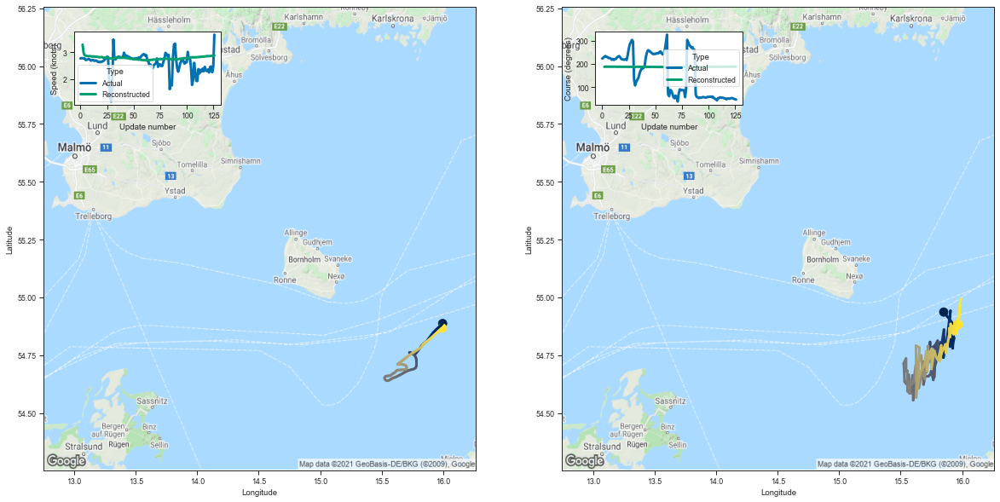

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.850371  54.936474  3.277015  187.228958         0.046477   
3    15.933266  54.880779  2.971923  187.934586         0.017165   
4    15.929514  54.831230  2.875252  187.907715         0.013549   
5    15.935017  54.823860  2.871240  187.894943         0.012999   
6    15.925432  54.798031  2.857800  187.778030         0.012790   
..         ...        ...       ...         ...              ...   
122  15.943577  54.843845  2.850107  187.958710         0.012587   
123  15.961882  54.903988  2.860610  188.150452         0.012681   
124  15.957617  54.844769  2.868469  187.984818         0.012746   
125  15.987869  54.994930  2.872298  188.465225         0.012732   
126  15.971131  54.882504  2.872711  188.126282         0.012764   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.152995     2.979297    100.510704                 1   
3          0.067944     2.779828    100.995247 

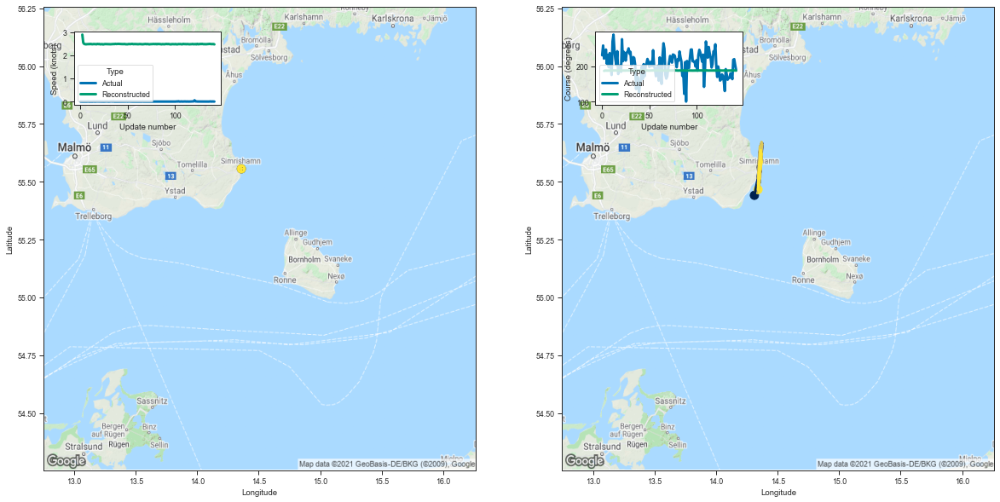

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.311169  55.441235  2.886508  186.504242         0.052227   
3    14.335624  55.504620  2.536756  187.324844         0.018704   
4    14.344697  55.541222  2.484902  187.536972         0.015737   
5    14.341247  55.458061  2.474123  187.283325         0.015351   
6    14.355729  55.528431  2.468301  187.485504         0.015150   
..         ...        ...       ...         ...              ...   
138  14.349461  55.570515  2.482226  187.624832         0.015394   
139  14.360033  55.552368  2.477613  187.566254         0.015296   
140  14.369144  55.585590  2.478059  187.704163         0.015231   
141  14.364667  55.634880  2.479561  187.858490         0.015268   
142  14.340368  55.466316  2.466648  187.266922         0.015053   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.156544     3.537776     99.952972                 1   
3          0.068556     3.331329    100.483536 

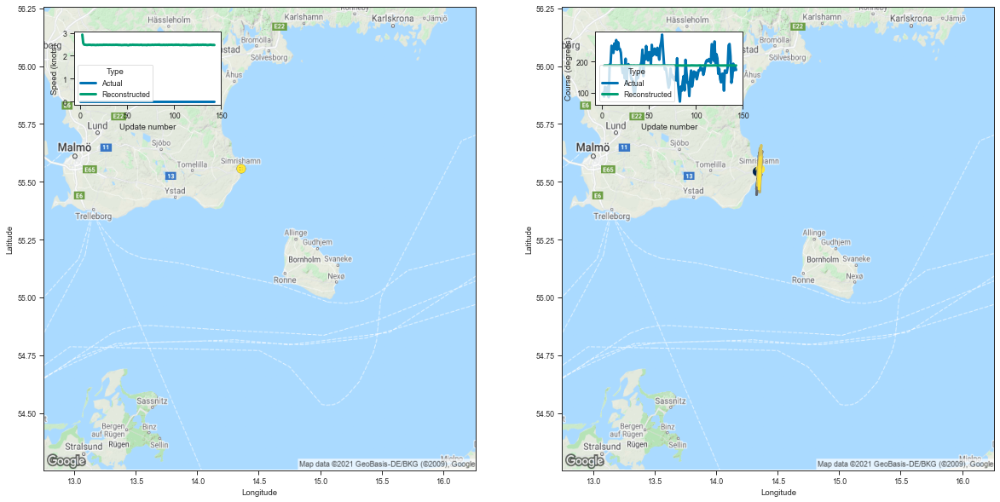

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.334723  55.543873  2.924406  186.802338         0.055151   
3    14.361665  55.567738  2.548802  187.601898         0.019108   
4    14.356291  55.495213  2.487499  187.421890         0.015954   
5    14.357293  55.572201  2.483650  187.671722         0.015579   
6    14.366406  55.589863  2.483294  187.702454         0.015347   
..         ...        ...       ...         ...              ...   
139  14.354939  55.566124  2.484567  187.626740         0.015371   
140  14.355994  55.551838  2.476867  187.624847         0.015290   
141  14.349010  55.468178  2.473476  187.310974         0.015253   
142  14.357487  55.526249  2.475802  187.492950         0.015171   
143  14.359351  55.554329  2.470560  187.632935         0.015221   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.161449     3.552451    100.105057                 1   
3          0.069281     3.341172    100.626495 

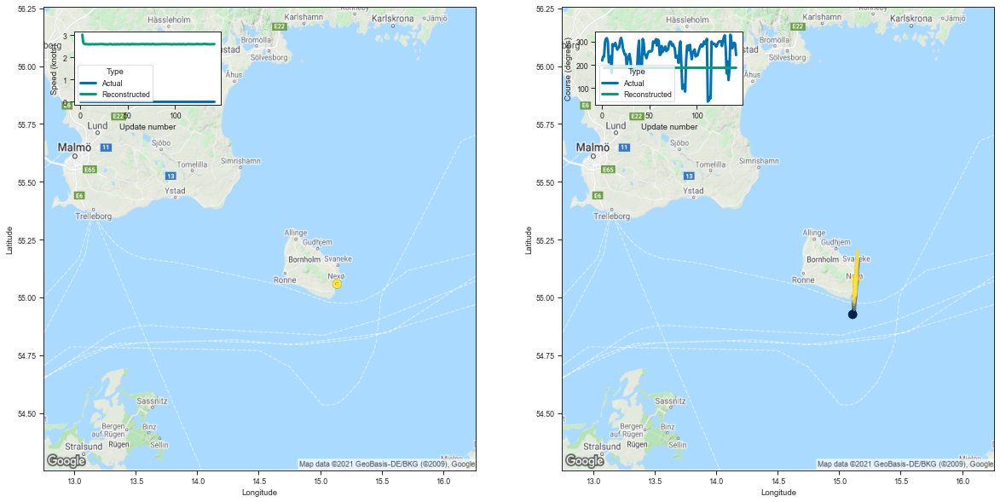

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.110146  54.926102  3.017008  186.210678         0.042253   
3    15.116454  54.950993  2.657111  186.863632         0.015221   
4    15.127171  54.943661  2.602639  186.925232         0.012494   
5    15.130172  55.034115  2.590389  187.137558         0.012318   
6    15.141276  55.119564  2.589877  187.475342         0.012187   
..         ...        ...       ...         ...              ...   
138  15.138233  55.080044  2.580555  187.318604         0.012136   
139  15.134209  55.008347  2.590583  187.116211         0.012094   
140  15.130863  55.024025  2.585481  187.090469         0.012054   
141  15.125419  55.037941  2.583051  187.204910         0.011970   
142  15.135861  55.079895  2.591789  187.341675         0.012153   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.140084     3.147701     99.884987                 1   
3          0.062768     2.941011    100.335045 

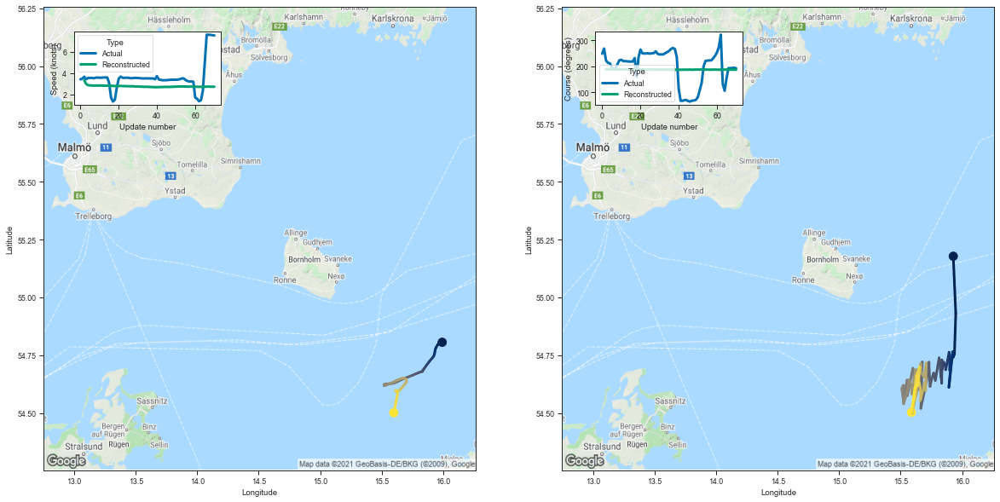

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.928033  55.177807  3.328866  187.958069         0.051155   
3   15.948200  54.930241  2.987516  188.133209         0.017780   
4   15.937634  54.755405  2.885451  187.718323         0.013566   
5   15.929873  54.743187  2.859250  187.596359         0.012982   
6   15.912876  54.732777  2.853368  187.556992         0.012814   
..        ...        ...       ...         ...              ...   
66  15.642805  54.618370  2.735576  186.773956         0.012054   
67  15.641418  54.659534  2.754385  186.879074         0.012340   
68  15.621984  54.610226  2.732048  186.698486         0.012226   
69  15.616788  54.610714  2.736315  186.680740         0.012238   
70  15.587875  54.502907  2.732758  186.309830         0.012235   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.167191     3.004398    100.899551                 1   
3         0.069387     2.799912    101.095917                

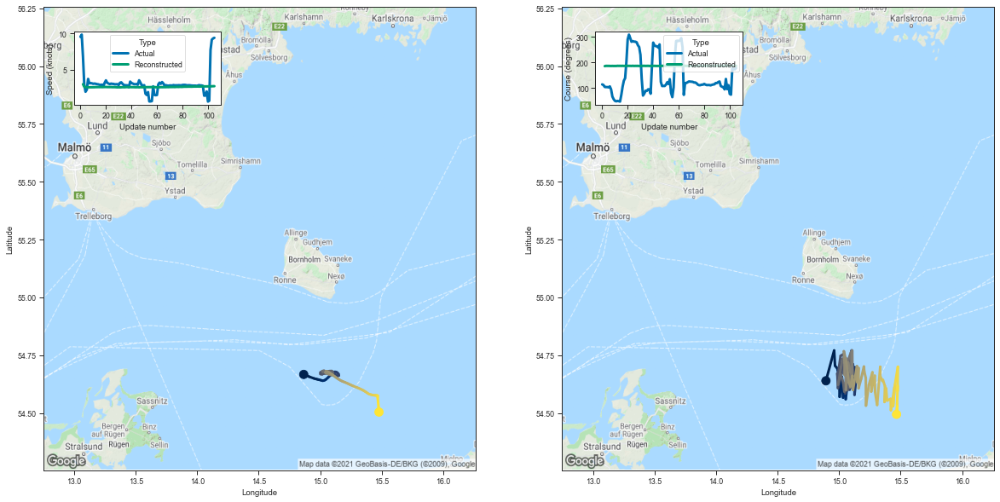

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.892880  54.639225  2.974131  184.977646         0.044426   
3    14.959554  54.770283  2.621148  186.008804         0.015752   
4    14.966743  54.704350  2.553530  185.937073         0.012784   
5    14.984999  54.692848  2.554633  185.928741         0.012237   
6    15.000574  54.655025  2.549624  185.801651         0.012132   
..         ...        ...       ...         ...              ...   
101  15.475563  54.617912  2.674343  186.461746         0.011755   
102  15.471187  54.539577  2.672724  186.223145         0.011716   
103  15.470000  54.510498  2.687073  186.135757         0.012141   
104  15.473369  54.529846  2.696051  186.198792         0.012293   
105  15.466655  54.493992  2.700530  186.157303         0.012446   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.143362     3.186400     99.216728                 1   
3          0.064582     2.977654     99.869354 

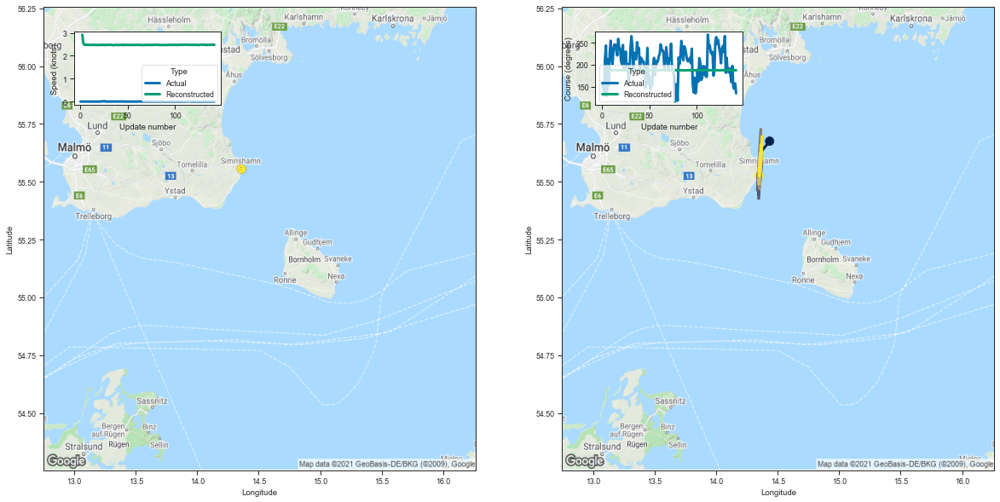

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.434950  55.675488  2.924444  187.429672         0.053046   
3    14.363757  55.628036  2.550389  187.825912         0.019152   
4    14.345244  55.443836  2.490207  187.211777         0.015762   
5    14.372242  55.581608  2.475658  187.707321         0.015264   
6    14.360533  55.560093  2.482849  187.623123         0.015466   
..         ...        ...       ...         ...              ...   
138  14.347653  55.547825  2.487420  187.603195         0.015415   
139  14.360132  55.548061  2.482151  187.593460         0.015277   
140  14.374702  55.696918  2.493743  188.057755         0.015420   
141  14.351534  55.561321  2.471451  187.577667         0.015405   
142  14.349402  55.526154  2.482592  187.498230         0.015393   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.157262     3.550868    100.446617                 1   
3          0.068712     3.354972    100.744164 

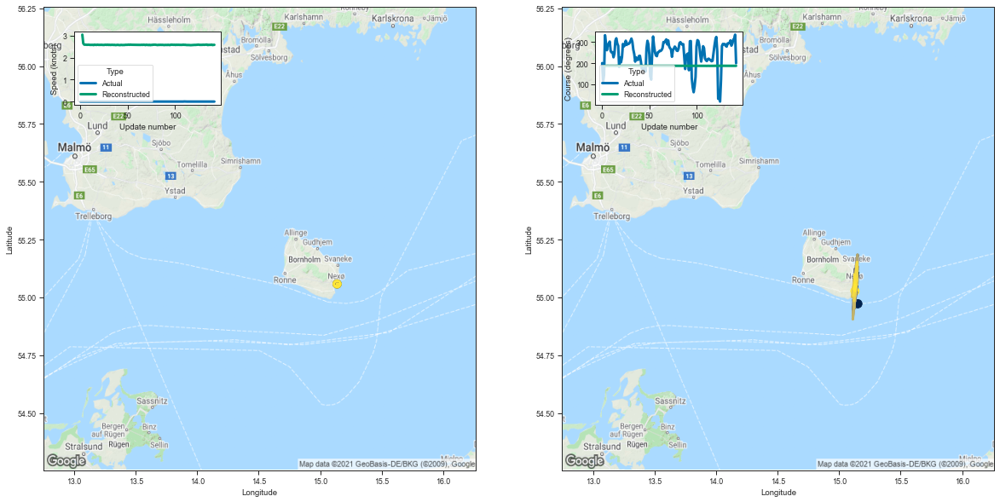

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.152205  54.972340  3.051052  186.325668         0.044339   
3    15.114342  54.946754  2.650861  186.825729         0.015015   
4    15.113309  54.946190  2.596266  186.903275         0.012606   
5    15.147351  55.056736  2.591529  187.251663         0.012204   
6    15.151141  55.107403  2.592656  187.443069         0.012098   
..         ...        ...       ...         ...              ...   
138  15.132021  55.087418  2.584315  187.331833         0.012172   
139  15.130644  55.063854  2.596747  187.291977         0.012129   
140  15.120523  55.034691  2.574309  187.131668         0.012122   
141  15.128853  55.055531  2.583062  187.216248         0.012181   
142  15.129066  55.027317  2.586503  187.128754         0.012119   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147718     3.143478     99.948372                 1   
3          0.062288     2.947994    100.320007 

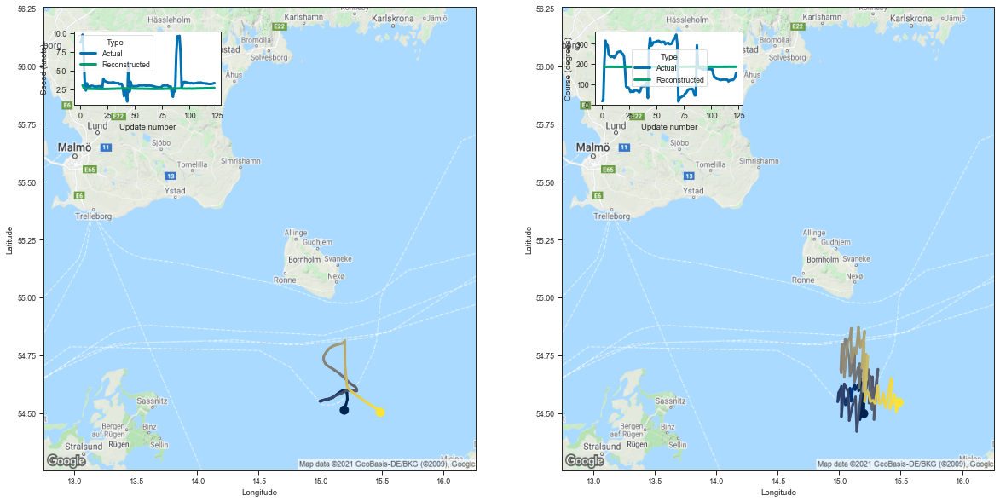

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.199625  54.497334  3.075713  185.087479         0.044001   
3    15.205003  54.590302  2.713869  185.876694         0.016056   
4    15.169497  54.471523  2.629254  185.575623         0.012797   
5    15.184057  54.609161  2.596860  185.963303         0.012153   
6    15.184038  54.646484  2.596164  186.097397         0.012031   
..         ...        ...       ...         ...              ...   
119  15.439427  54.554695  2.662663  186.203506         0.011720   
120  15.450458  54.578678  2.673167  186.303024         0.011841   
121  15.464065  54.505970  2.674563  186.136002         0.011847   
122  15.480105  54.541889  2.670419  186.226334         0.011799   
123  15.485698  54.545322  2.681767  186.300247         0.011852   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.142455     3.089741     99.309235                 1   
3          0.065133     2.894825     99.828453 

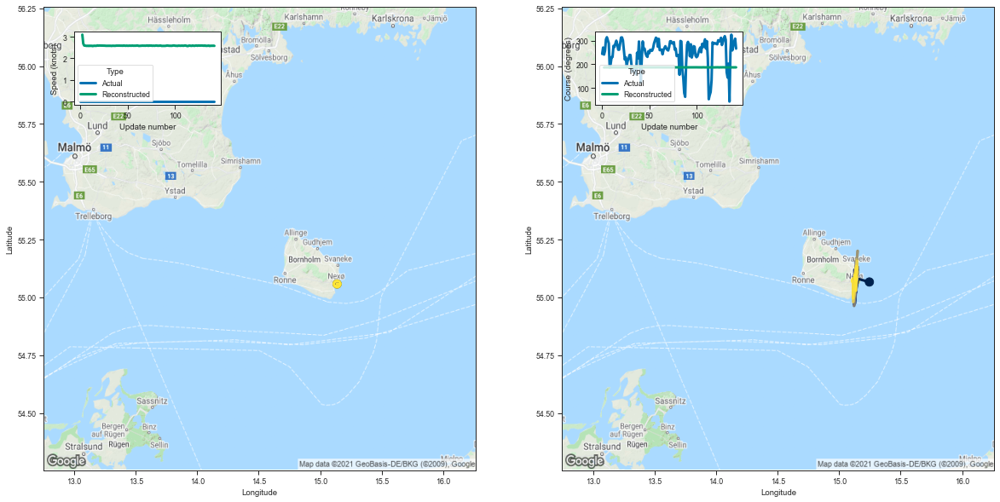

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.245873  55.066452  3.098296  186.709641         0.046150   
3    15.155501  55.079514  2.680734  187.333221         0.015554   
4    15.120584  54.981899  2.594594  187.028397         0.012466   
5    15.128457  55.016731  2.587053  187.105530         0.012053   
6    15.133229  55.018578  2.581307  187.106247         0.012042   
..         ...        ...       ...         ...              ...   
138  15.140216  55.135582  2.582659  187.454971         0.012041   
139  15.133784  55.028755  2.581582  187.138641         0.011996   
140  15.140892  55.097195  2.583594  187.349197         0.012151   
141  15.128000  55.096256  2.585328  187.287048         0.012001   
142  15.132406  55.072071  2.579379  187.249359         0.012092   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150652     3.147438    100.161018                 1   
3          0.063360     2.957866    100.577522 

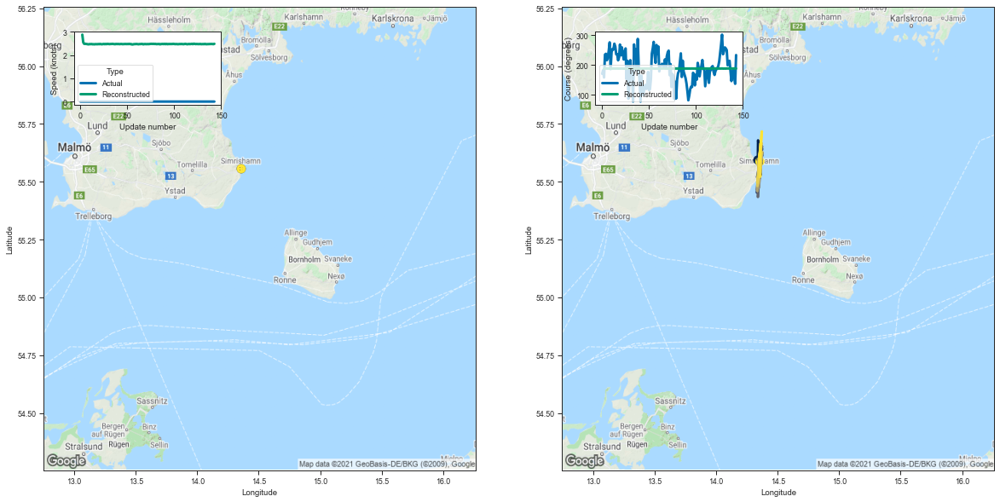

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.339315  55.594021  2.883867  187.134277         0.050444   
3    14.341017  55.678112  2.551397  187.867203         0.019497   
4    14.373383  55.614769  2.487155  187.803680         0.015654   
5    14.345783  55.517342  2.488182  187.475937         0.015549   
6    14.365171  55.611420  2.483924  187.783508         0.015394   
..         ...        ...       ...         ...              ...   
139  14.351499  55.567913  2.477144  187.696487         0.015263   
140  14.356552  55.607727  2.481904  187.804337         0.015448   
141  14.371758  55.716961  2.479210  188.111908         0.015307   
142  14.354193  55.612904  2.474162  187.724030         0.015334   
143  14.355456  55.587711  2.487757  187.694641         0.015356   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149685     3.547656    100.277039                 1   
3          0.070681     3.374009    100.766678 

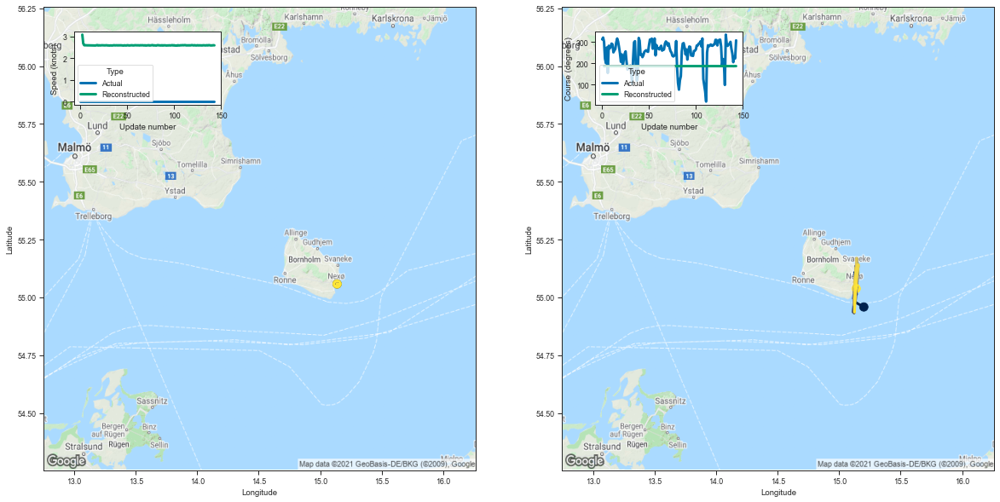

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.200779  54.958405  3.078319  186.434052         0.044949   
3    15.135756  54.977669  2.670327  186.953812         0.015607   
4    15.125987  54.996468  2.592062  187.009949         0.012608   
5    15.146679  55.122383  2.587752  187.471558         0.012055   
6    15.134377  55.120148  2.589812  187.461594         0.012116   
..         ...        ...       ...         ...              ...   
139  15.132920  55.027271  2.580399  187.112717         0.012052   
140  15.125298  54.936665  2.580117  186.810028         0.012063   
141  15.131291  55.045719  2.583940  187.203079         0.012108   
142  15.145597  55.052834  2.591282  187.253525         0.012100   
143  15.138510  55.037884  2.585046  187.204514         0.012017   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144527     3.146623    100.013153                 1   
3          0.063345     2.944241    100.382042 

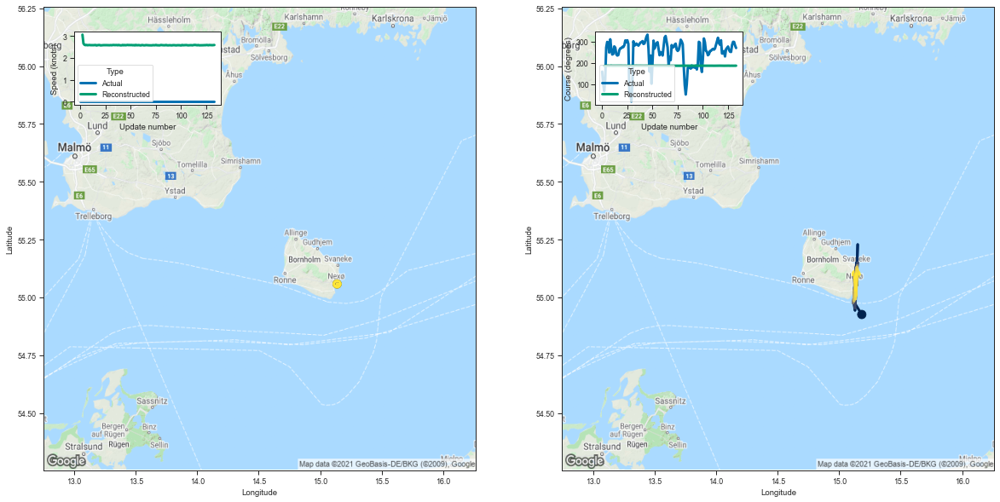

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.184162  54.925880  3.069129  186.245483         0.045124   
3    15.116445  54.983749  2.663917  186.934555         0.015399   
4    15.129248  54.943901  2.604020  186.890411         0.012499   
5    15.141005  55.064564  2.586420  187.268112         0.012214   
6    15.141478  55.150391  2.597411  187.557800         0.012194   
..         ...        ...       ...         ...              ...   
129  15.128507  55.080276  2.589814  187.329178         0.012174   
130  15.133604  55.029697  2.586009  187.120895         0.012117   
131  15.142479  55.103001  2.584592  187.414673         0.012097   
132  15.128383  55.084858  2.589390  187.277313         0.012063   
133  15.137934  55.100483  2.593769  187.385696         0.012206   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.148270     3.135650     99.909317                 1   
3          0.062895     2.961160    100.378159 

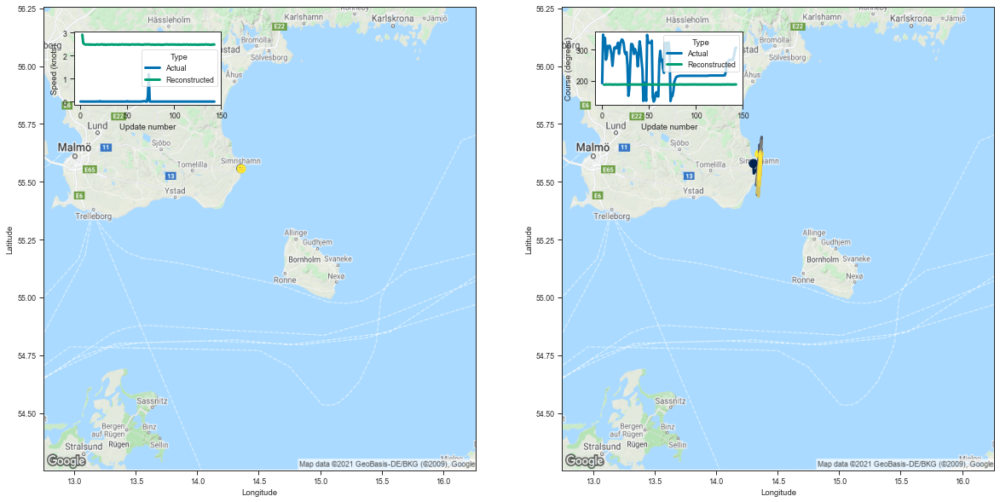

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.303131  55.578709  2.908554  186.846298         0.054800   
3    14.306601  55.536541  2.538433  187.470291         0.019049   
4    14.346261  55.566898  2.501080  187.643372         0.016022   
5    14.351340  55.532692  2.483249  187.470276         0.015342   
6    14.370028  55.603973  2.472630  187.711380         0.015343   
..         ...        ...       ...         ...              ...   
139  14.350310  55.542515  2.467142  187.519836         0.015160   
140  14.347750  55.511032  2.471097  187.450729         0.015219   
141  14.363693  55.610527  2.474775  187.795715         0.015085   
142  14.360355  55.576183  2.484402  187.668747         0.015253   
143  14.350480  55.619560  2.476957  187.780807         0.015418   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.160003     3.565561    100.130783                 1   
3          0.069022     3.357284    100.551102 

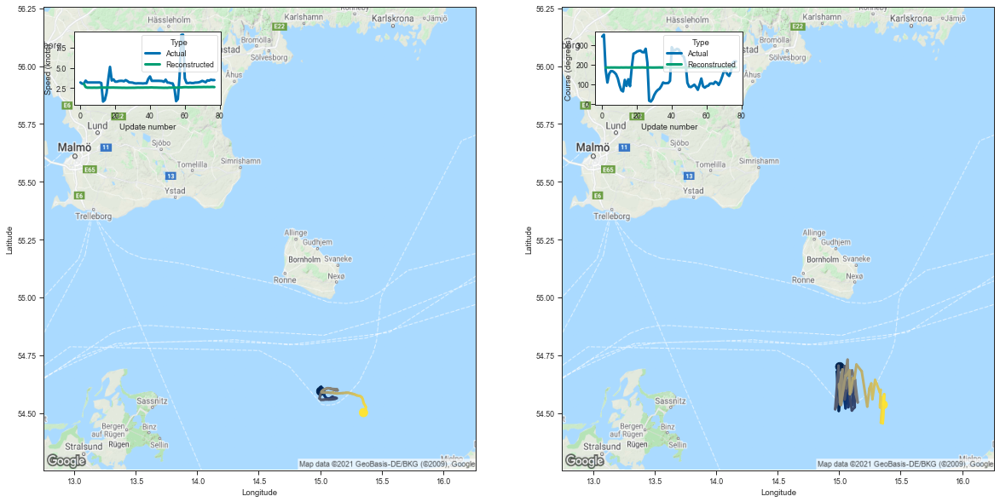

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.005131  54.700096  3.018833  185.381943         0.044712   
3   14.981655  54.678333  2.627632  185.814392         0.015452   
4   14.997198  54.508919  2.555259  185.368683         0.012463   
5   15.037926  54.657715  2.560210  185.853394         0.012133   
6   15.019110  54.600307  2.551443  185.664658         0.012054   
..        ...        ...       ...         ...              ...   
73  15.366539  54.581375  2.643339  186.165527         0.011844   
74  15.363975  54.542709  2.633125  186.066055         0.011736   
75  15.354778  54.454945  2.642756  185.764481         0.011784   
76  15.364768  54.574341  2.647550  186.154480         0.011894   
77  15.358872  54.535828  2.627928  185.996445         0.011724   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.143992     3.145140     99.427238                 1   
3         0.063841     2.931706     99.757950                

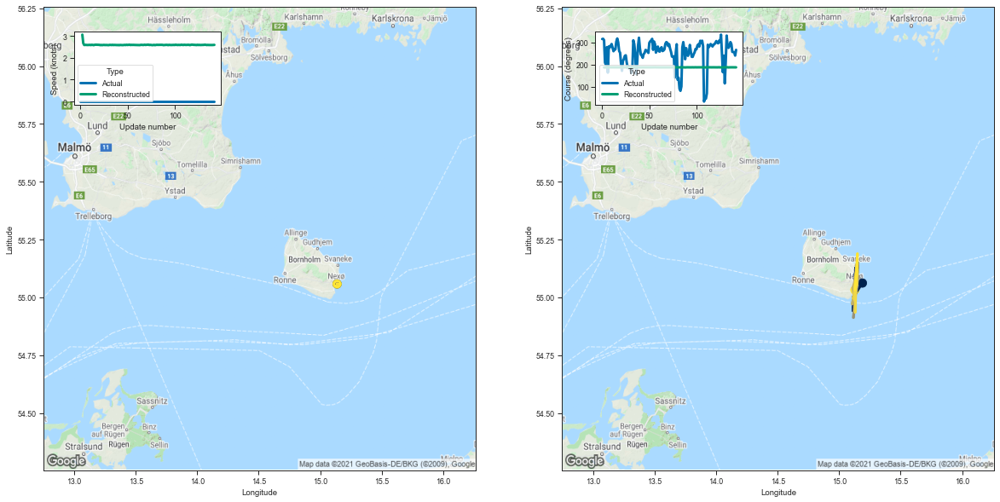

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.189379  55.061905  3.056715  186.701508         0.043906   
3    15.112379  54.999554  2.664726  186.932739         0.015463   
4    15.112448  54.942104  2.583064  186.894135         0.012447   
5    15.133719  55.046703  2.585775  187.195328         0.012149   
6    15.140484  55.078194  2.588920  187.354370         0.012098   
..         ...        ...       ...         ...              ...   
138  15.137663  55.071949  2.588044  187.337204         0.012130   
139  15.144128  55.097080  2.582135  187.344055         0.012001   
140  15.149000  55.188580  2.582040  187.676315         0.012086   
141  15.132569  55.057941  2.587318  187.182312         0.012061   
142  15.128386  55.031929  2.588831  187.162109         0.012079   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145085     3.166050    100.153954                 1   
3          0.063497     2.962131    100.376060 

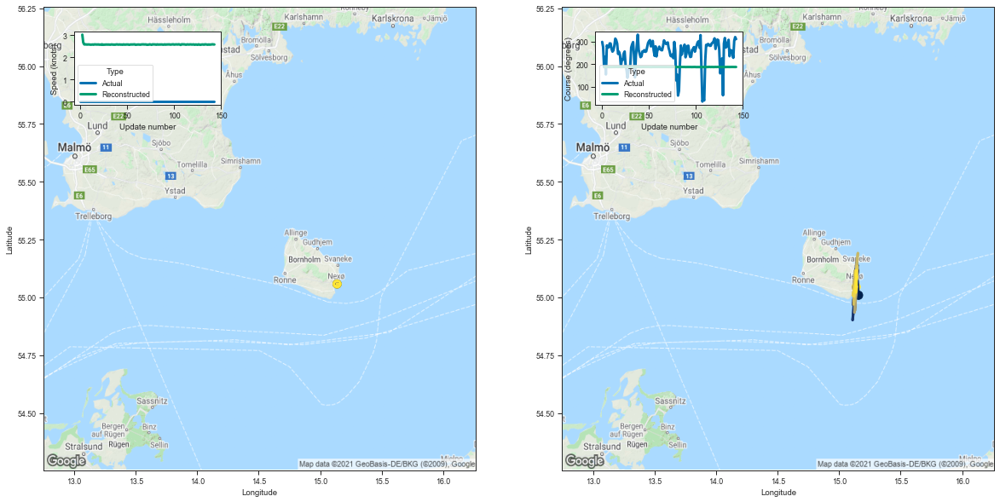

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.157933  55.009197  3.033678  186.344894         0.043193   
3    15.141361  55.142765  2.674536  187.412369         0.015645   
4    15.130453  55.027542  2.592494  187.169205         0.012528   
5    15.135607  55.054905  2.586791  187.246506         0.012193   
6    15.132605  55.087883  2.592625  187.356430         0.012250   
..         ...        ...       ...         ...              ...   
139  15.138192  55.116943  2.583112  187.429123         0.012103   
140  15.135937  55.021507  2.588806  187.155029         0.011962   
141  15.139508  55.056400  2.595815  187.247528         0.012094   
142  15.140973  55.100777  2.588808  187.361328         0.012213   
143  15.138133  55.045197  2.586649  187.210846         0.012172   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146575     3.131062     99.972893                 1   
3          0.064623     2.968566    100.627365 

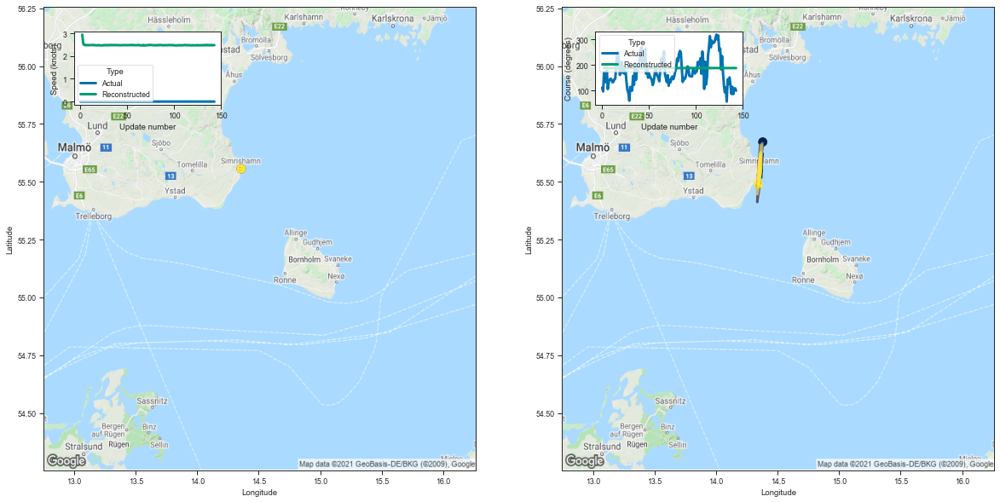

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.379139  55.671963  2.942137  187.288467         0.057133   
3    14.362306  55.588478  2.541754  187.648102         0.019055   
4    14.338166  55.446495  2.486580  187.262482         0.016028   
5    14.368793  55.553741  2.494378  187.618179         0.015405   
6    14.350329  55.508968  2.473514  187.422958         0.015275   
..         ...        ...       ...         ...              ...   
139  14.350989  55.494041  2.482302  187.414825         0.015494   
140  14.361983  55.613926  2.489381  187.836273         0.015394   
141  14.348603  55.563309  2.467659  187.584351         0.015274   
142  14.352818  55.566547  2.479359  187.595901         0.015412   
143  14.341896  55.488670  2.479469  187.394424         0.015236   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.164925     3.572747    100.361740                 1   
3          0.069016     3.348330    100.658623 

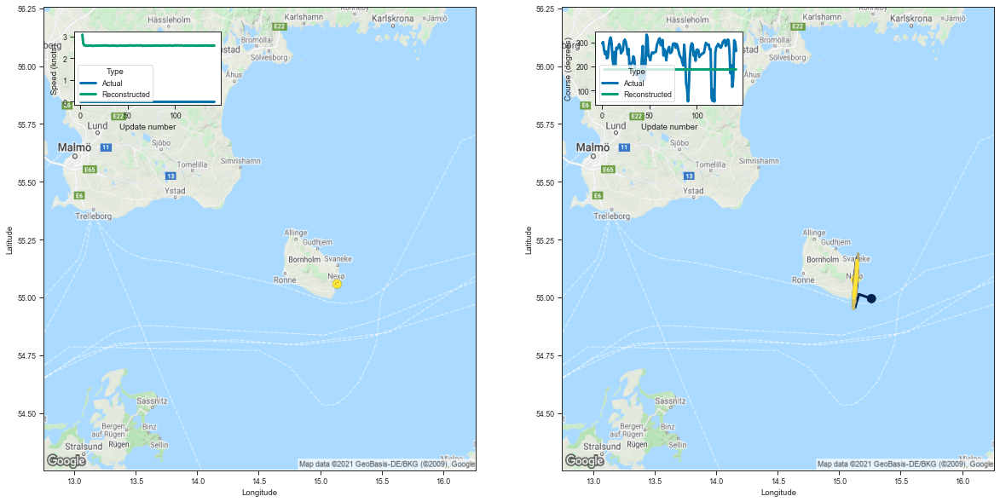

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.262971  54.994633  3.090669  186.477036         0.046108   
3    15.161468  55.013172  2.678463  187.085815         0.015614   
4    15.129191  54.956474  2.592788  186.933365         0.012516   
5    15.148549  55.084888  2.600760  187.381088         0.012295   
6    15.138465  55.021427  2.579038  187.134171         0.012032   
..         ...        ...       ...         ...              ...   
138  15.141401  55.118412  2.589366  187.423584         0.012132   
139  15.144634  55.159840  2.587342  187.579315         0.012056   
140  15.132917  55.026375  2.576349  187.144974         0.011976   
141  15.119180  54.996098  2.587959  187.038177         0.012105   
142  15.132195  55.077263  2.586086  187.319092         0.012162   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.151843     3.122937    100.038437                 1   
3          0.063508     2.948604    100.456917 

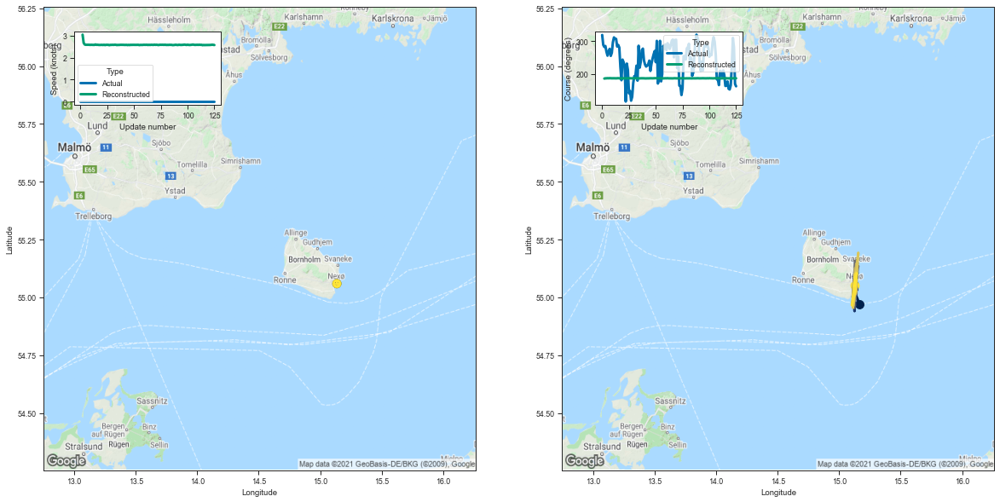

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.168206  54.968449  3.050421  186.442123         0.042729   
3    15.131766  55.015835  2.674455  187.061310         0.015465   
4    15.131978  55.052116  2.598393  187.228088         0.012639   
5    15.147910  55.135971  2.587668  187.509018         0.012296   
6    15.142262  55.081680  2.588821  187.330734         0.012004   
..         ...        ...       ...         ...              ...   
121  15.103862  54.965984  2.579806  186.899063         0.012058   
122  15.130138  55.023613  2.584448  187.123398         0.012028   
123  15.142316  55.103237  2.590334  187.396072         0.012013   
124  15.123620  55.048424  2.585136  187.231079         0.012123   
125  15.129992  55.050144  2.576328  187.178818         0.011944   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.140802     3.151809    100.021126                 1   
3          0.063090     2.958596    100.442810 

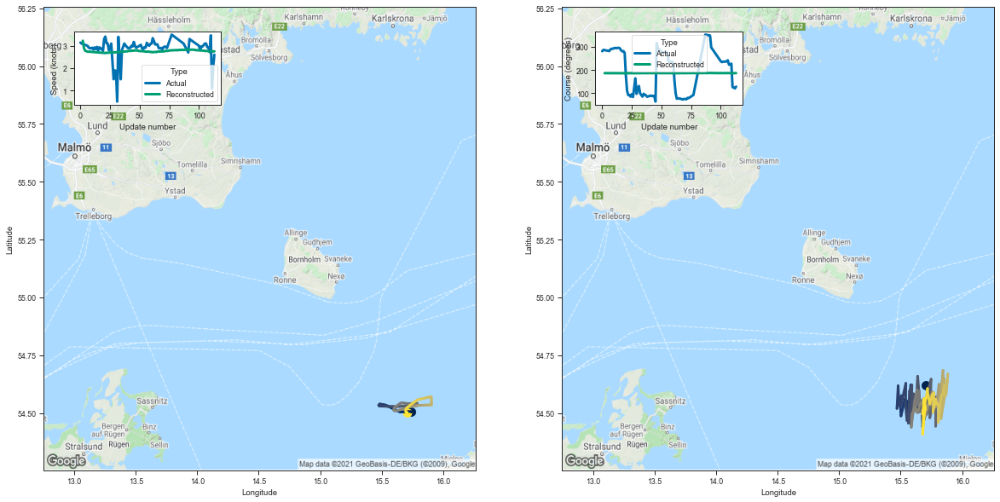

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.707665  54.618225  3.227016  186.170502         0.045607   
3    15.741267  54.614243  2.890268  186.809769         0.016648   
4    15.678788  54.439323  2.775834  186.328720         0.012764   
5    15.677060  54.543762  2.758757  186.608612         0.012222   
6    15.639599  54.502617  2.736895  186.441589         0.012123   
..         ...        ...       ...         ...              ...   
109  15.678277  54.495445  2.751396  186.461517         0.012061   
110  15.690468  54.561989  2.760162  186.683929         0.012140   
111  15.679337  54.407818  2.753484  186.152145         0.012083   
112  15.699032  54.530838  2.744969  186.578003         0.011926   
113  15.701232  54.513664  2.750732  186.550812         0.011975   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.148563     2.968315     99.931129                 1   
3          0.066660     2.777843    100.379669 

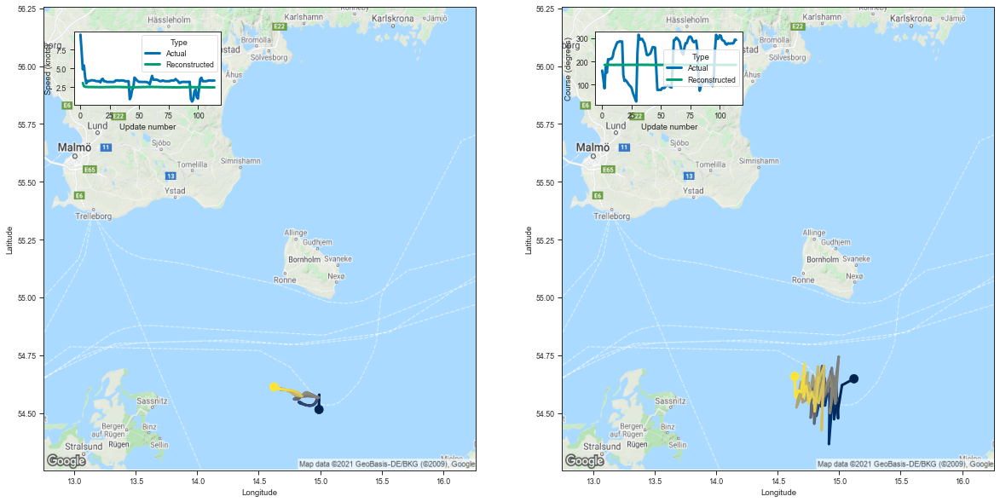

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.120782  54.647930  3.071793  185.186020         0.046896   
3    15.023651  54.620228  2.636281  185.698029         0.015451   
4    14.989894  54.510292  2.563878  185.414261         0.012847   
5    14.991580  54.477158  2.544245  185.282303         0.012140   
6    14.987764  54.562832  2.539615  185.500916         0.012130   
..         ...        ...       ...         ...              ...   
110  14.691426  54.590412  2.472584  185.068405         0.012726   
111  14.669787  54.596062  2.470296  185.108276         0.012809   
112  14.647699  54.566631  2.477236  184.962814         0.013096   
113  14.643421  54.585087  2.485569  185.067993         0.013092   
114  14.639842  54.658096  2.475338  185.292648         0.013264   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.155508     3.117708     99.342812                 1   
3          0.063655     2.928740     99.709633 

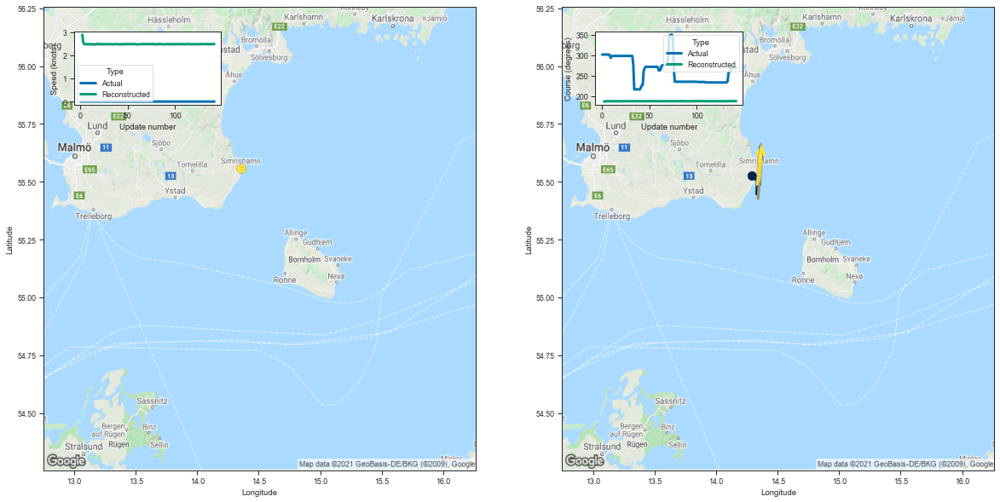

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.292912  55.524967  2.888362  186.702805         0.053413   
3    14.333596  55.504013  2.542384  187.389359         0.018940   
4    14.330850  55.447174  2.480266  187.235001         0.015739   
5    14.356045  55.582672  2.480022  187.632034         0.015420   
6    14.358839  55.549698  2.480194  187.510086         0.015219   
..         ...        ...       ...         ...              ...   
138  14.372673  55.651386  2.476785  187.895355         0.015149   
139  14.361293  55.615635  2.484936  187.804565         0.015321   
140  14.358266  55.613678  2.477170  187.770599         0.015228   
141  14.354401  55.587395  2.479331  187.665115         0.015241   
142  14.362382  55.621403  2.482028  187.838226         0.015312   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.157305     3.553007    100.045410                 1   
3          0.068421     3.334805    100.511887 

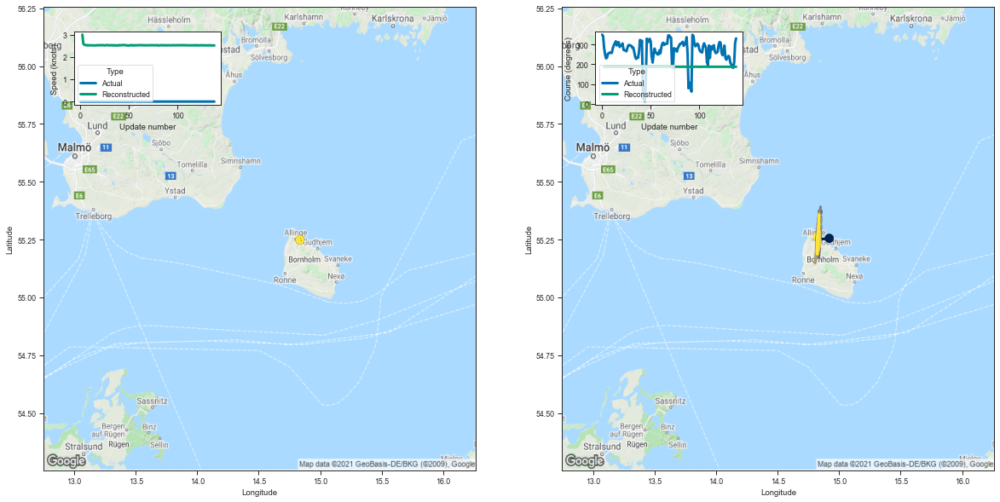

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.919765  55.255291  3.006432  186.777863         0.047217   
3    14.833270  55.250134  2.595482  187.316452         0.016026   
4    14.844940  55.281628  2.551311  187.498718         0.013417   
5    14.831726  55.226387  2.538108  187.295013         0.012952   
6    14.837606  55.248497  2.527521  187.347488         0.012820   
..         ...        ...       ...         ...              ...   
134  14.821863  55.227661  2.522830  187.277664         0.012824   
135  14.824100  55.186249  2.520910  187.135422         0.012731   
136  14.836893  55.355827  2.527180  187.707993         0.012826   
137  14.820409  55.189281  2.517953  187.155899         0.012630   
138  14.824471  55.261986  2.520947  187.350143         0.012873   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.151888     3.265903    100.160126                 1   
3          0.064040     3.084816    100.536987 

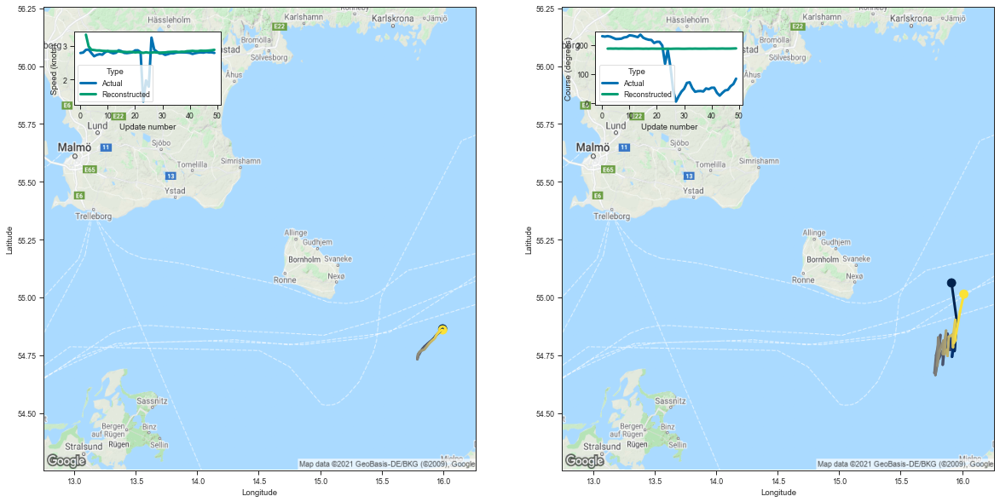

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.913828  55.062477  3.332196  187.718643         0.049721   
3   15.955080  54.904846  2.981811  188.023743         0.017499   
4   15.938471  54.767933  2.883912  187.735947         0.013521   
5   15.952829  54.882008  2.873976  188.062057         0.013072   
6   15.918211  54.742813  2.861732  187.604340         0.012871   
7   15.930012  54.844662  2.863148  187.953308         0.012888   
8   15.912782  54.830853  2.850642  187.846710         0.012866   
9   15.902552  54.772728  2.847273  187.670288         0.012729   
10  15.900100  54.775661  2.843533  187.660324         0.012624   
11  15.879333  54.773544  2.840429  187.625793         0.012695   
12  15.889065  54.827694  2.838609  187.813950         0.012825   
13  15.880557  54.842918  2.839811  187.855072         0.012645   
14  15.862136  54.803432  2.836914  187.674347         0.012755   
15  15.842491  54.708672  2.819507  187.349701         0.01254

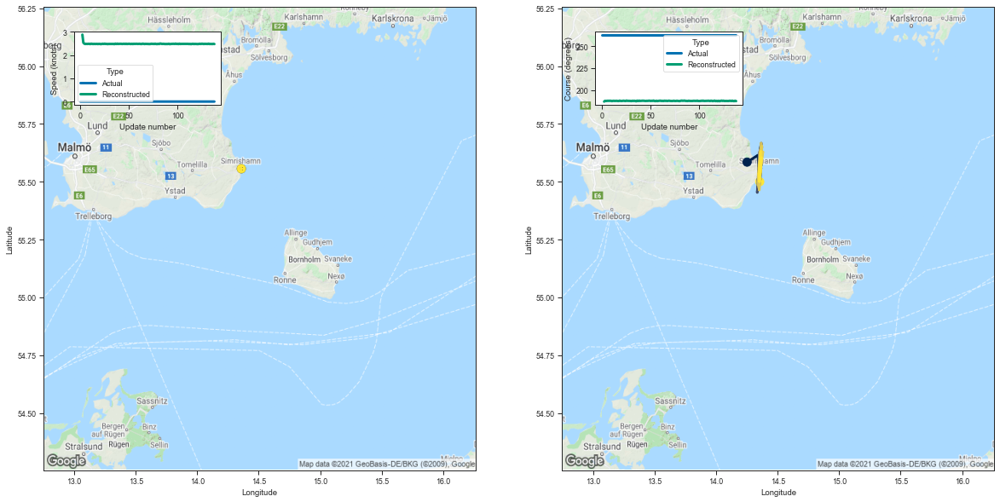

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.251806  55.584904  2.874542  186.859177         0.052699   
3    14.339207  55.614429  2.530042  187.696060         0.018640   
4    14.351684  55.522480  2.486240  187.484055         0.015692   
5    14.357572  55.604736  2.473327  187.700394         0.015344   
6    14.357026  55.575153  2.478259  187.692062         0.015281   
..         ...        ...       ...         ...              ...   
134  14.362792  55.630974  2.474177  187.840988         0.015299   
135  14.346777  55.534847  2.471228  187.488297         0.015286   
136  14.349094  55.502033  2.471020  187.363327         0.015229   
137  14.368133  55.604946  2.479263  187.796005         0.015244   
138  14.354365  55.499958  2.470001  187.389084         0.015093   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.154632     3.577428    100.129700                 1   
3          0.068104     3.348541    100.676369 

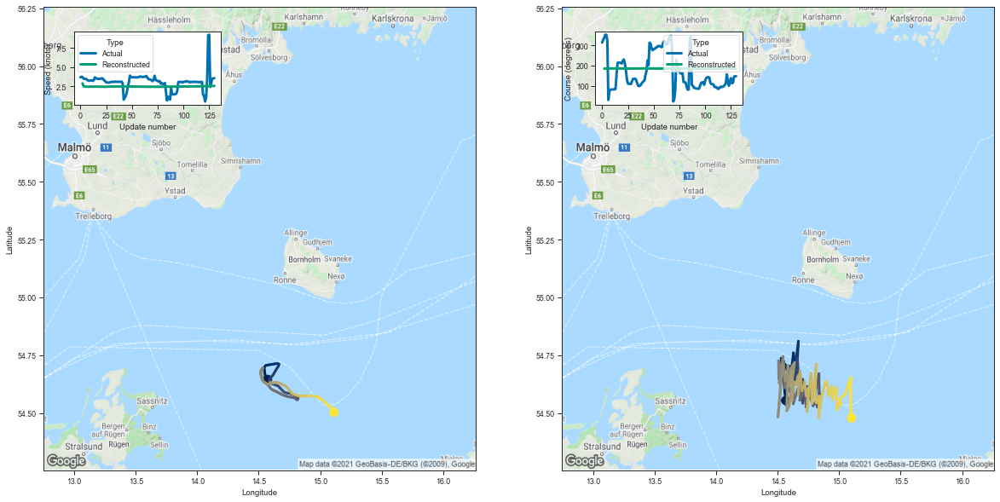

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.565491  54.553806  2.907904  184.243790         0.047136   
3    14.529039  54.736881  2.539433  185.305084         0.017157   
4    14.534070  54.659180  2.484312  185.138794         0.014196   
5    14.539248  54.693459  2.476699  185.281433         0.013939   
6    14.530377  54.672825  2.467081  185.161011         0.013702   
..         ...        ...       ...         ...              ...   
126  15.093187  54.653297  2.578870  185.915985         0.012473   
127  15.092955  54.624710  2.572062  185.902786         0.012037   
128  15.095106  54.508892  2.569730  185.487396         0.012055   
129  15.098536  54.495274  2.569825  185.468369         0.012050   
130  15.100729  54.478607  2.571111  185.435699         0.011858   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144945     3.292394     98.787521                 1   
3          0.065802     3.119438     99.441460 

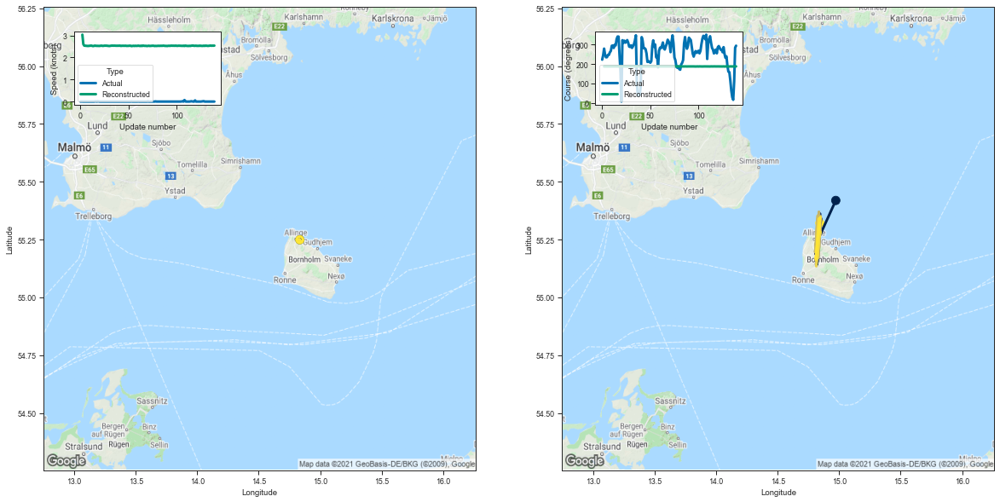

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.972797  55.419098  3.036091  187.280579         0.048722   
3    14.837191  55.260139  2.604019  187.314087         0.016227   
4    14.820874  55.142628  2.536137  187.032684         0.013269   
5    14.844726  55.323231  2.531795  187.577347         0.012843   
6    14.828040  55.223831  2.524773  187.252380         0.012841   
..         ...        ...       ...         ...              ...   
135  14.812065  55.162102  2.539502  187.052933         0.012955   
136  14.845557  55.345619  2.531753  187.629105         0.013052   
137  14.810486  55.168186  2.536379  187.085876         0.013194   
138  14.826438  55.255344  2.534133  187.377579         0.012978   
139  14.843393  55.321239  2.538265  187.619095         0.012894   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.157665     3.291869    100.429688                 1   
3          0.064788     3.095276    100.543152 

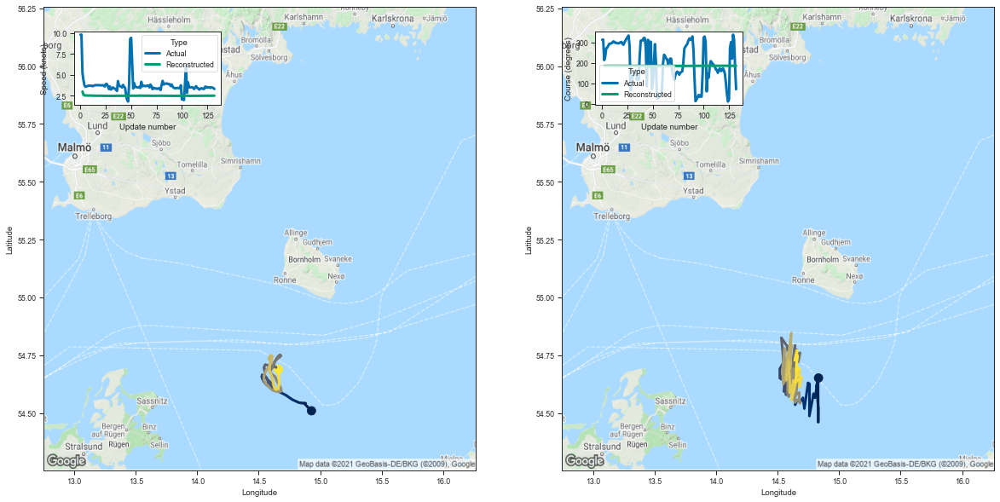

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.832426  54.651443  2.983605  184.895905         0.046689   
3    14.815314  54.616642  2.587960  185.326843         0.015806   
4    14.831400  54.518135  2.526415  185.125763         0.012926   
5    14.830427  54.460705  2.507058  184.922974         0.012497   
6    14.828558  54.647408  2.513327  185.515747         0.012472   
..         ...        ...       ...         ...              ...   
128  14.655118  54.712296  2.488172  185.452377         0.013233   
129  14.663050  54.746246  2.469420  185.538757         0.013064   
130  14.639341  54.728065  2.486678  185.509613         0.013277   
131  14.657765  54.770435  2.485147  185.614182         0.013238   
132  14.651085  54.684464  2.491387  185.396240         0.013215   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149339     3.234223     99.160919                 1   
3          0.064174     2.997432     99.496399 

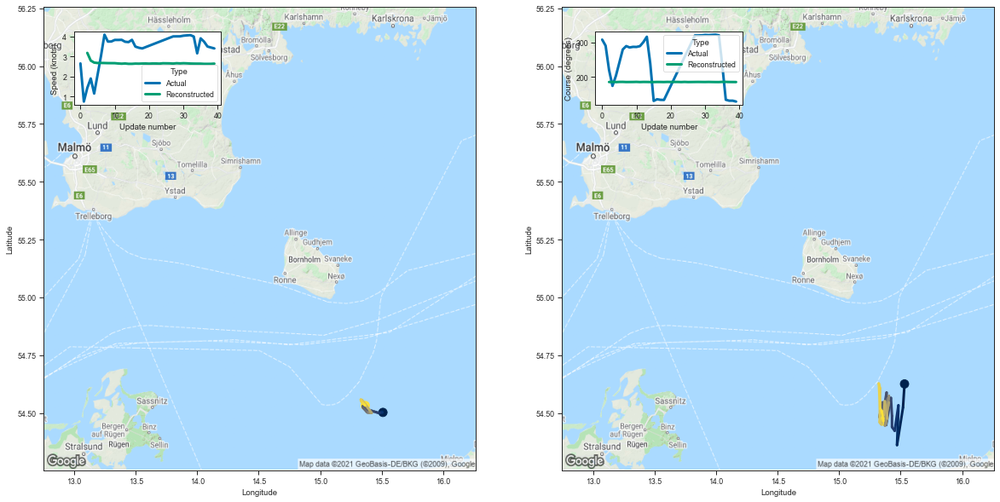

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.531705  54.625549  3.177656  185.887253         0.045393   
3   15.519370  54.523808  2.794402  186.174896         0.015735   
4   15.470734  54.361206  2.694195  185.681305         0.012224   
5   15.480921  54.507420  2.673642  186.168488         0.011834   
6   15.482086  54.532982  2.676463  186.238159         0.011853   
7   15.451694  54.422985  2.672239  185.826050         0.011834   
8   15.429933  54.439308  2.667305  185.903717         0.011905   
9   15.429927  54.487160  2.666231  185.993927         0.011907   
10  15.421135  54.565174  2.665280  186.251190         0.011833   
11  15.382515  54.447960  2.649438  185.773209         0.011867   
12  15.385837  54.588234  2.638699  186.120529         0.011906   
13  15.365525  54.525578  2.649556  186.034164         0.011942   
14  15.338076  54.508801  2.632038  185.847519         0.011853   
15  15.327497  54.482056  2.632396  185.758347         0.01183

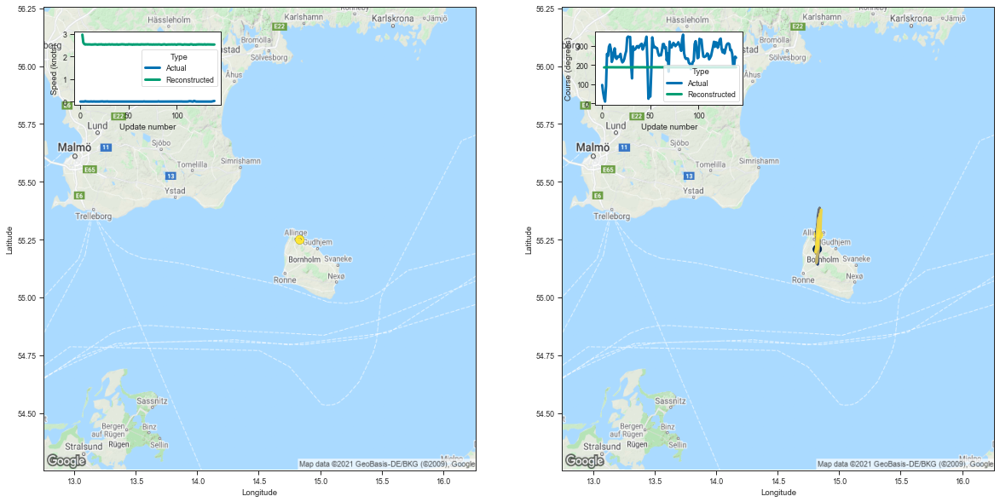

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.822273  55.208599  2.966108  186.549774         0.045292   
3    14.820466  55.300793  2.611392  187.474487         0.016553   
4    14.825606  55.259853  2.550705  187.428574         0.013728   
5    14.839383  55.243530  2.526974  187.295776         0.013014   
6    14.848289  55.320229  2.536429  187.621185         0.012939   
..         ...        ...       ...         ...              ...   
135  14.831306  55.276772  2.524072  187.379990         0.012826   
136  14.840674  55.284073  2.524399  187.468170         0.012872   
137  14.829638  55.270115  2.524565  187.359940         0.012901   
138  14.829513  55.262730  2.525595  187.393524         0.012916   
139  14.832164  55.269211  2.527209  187.412872         0.012843   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146803     3.303826    100.041779                 1   
3          0.065332     3.111809    100.616180 

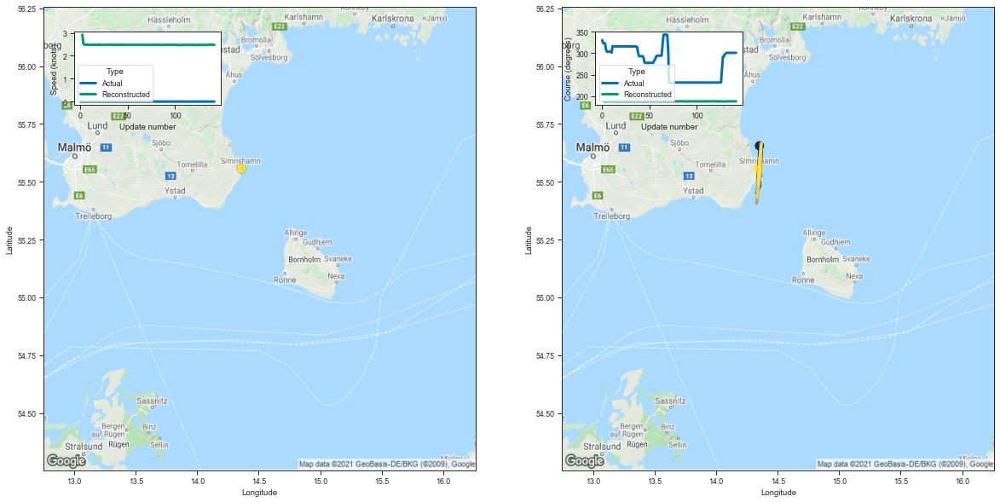

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.352550  55.655376  2.921091  187.221024         0.054794   
3    14.348501  55.601971  2.536362  187.625916         0.019473   
4    14.332871  55.449223  2.483325  187.294174         0.015861   
5    14.357886  55.482471  2.482863  187.389084         0.015352   
6    14.354686  55.550728  2.482849  187.633560         0.015340   
..         ...        ...       ...         ...              ...   
138  14.349597  55.580566  2.473824  187.606201         0.015282   
139  14.346892  55.569153  2.485856  187.630447         0.015378   
140  14.341751  55.491692  2.470711  187.381851         0.015210   
141  14.354734  55.557022  2.475698  187.587860         0.015296   
142  14.343469  55.559669  2.474526  187.557846         0.015184   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.161854     3.566735    100.318588                 1   
3          0.070381     3.346088    100.634300 

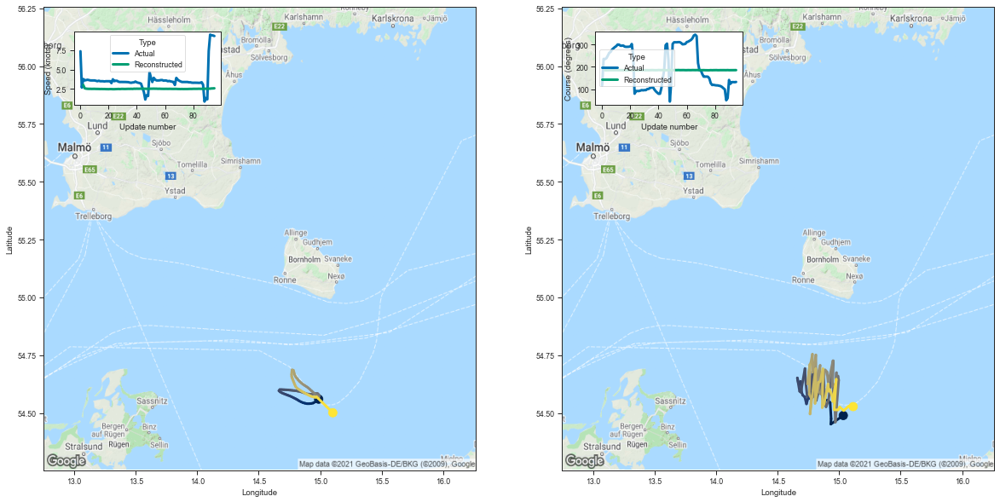

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.033895  54.489140  3.012397  184.730423         0.044176   
3   14.932559  54.451752  2.597876  184.954803         0.015213   
4   14.935156  54.475269  2.544835  185.140839         0.012683   
5   14.927259  54.545223  2.525120  185.314026         0.012370   
6   14.903366  54.555832  2.515559  185.303391         0.012236   
..        ...        ...       ...         ...              ...   
91  14.992351  54.513451  2.538934  185.361740         0.012082   
92  15.004769  54.525898  2.544152  185.403961         0.012155   
93  15.036921  54.510410  2.568603  185.468063         0.012529   
94  15.077773  54.529476  2.573584  185.513107         0.012433   
95  15.114356  54.527584  2.591358  185.654724         0.012374   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.144837     3.124411     99.104973                 1   
3         0.063149     2.923301     99.320946                

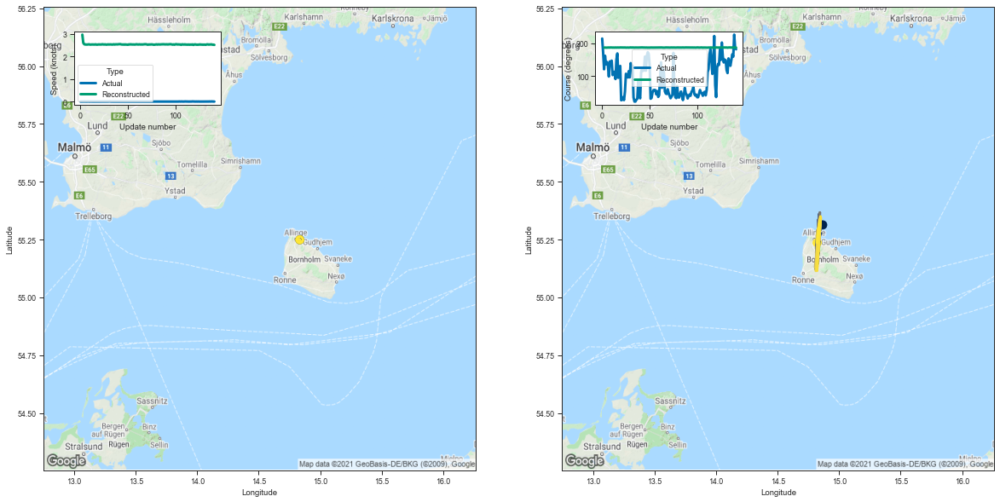

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.866288  55.313274  2.969493  186.899841         0.046093   
3    14.821515  55.264656  2.602651  187.381897         0.016100   
4    14.811649  55.121540  2.542779  186.965622         0.013271   
5    14.833632  55.194515  2.531399  187.177368         0.012936   
6    14.843796  55.324528  2.529862  187.579819         0.012905   
..         ...        ...       ...         ...              ...   
137  14.848253  55.349522  2.533349  187.690125         0.012842   
138  14.837523  55.317875  2.536854  187.579163         0.012889   
139  14.832404  55.270176  2.522679  187.442245         0.012795   
140  14.835409  55.301731  2.523156  187.499924         0.012908   
141  14.821523  55.236473  2.514350  187.272385         0.012780   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.148008     3.285189    100.217537                 1   
3          0.063691     3.087317    100.566826 

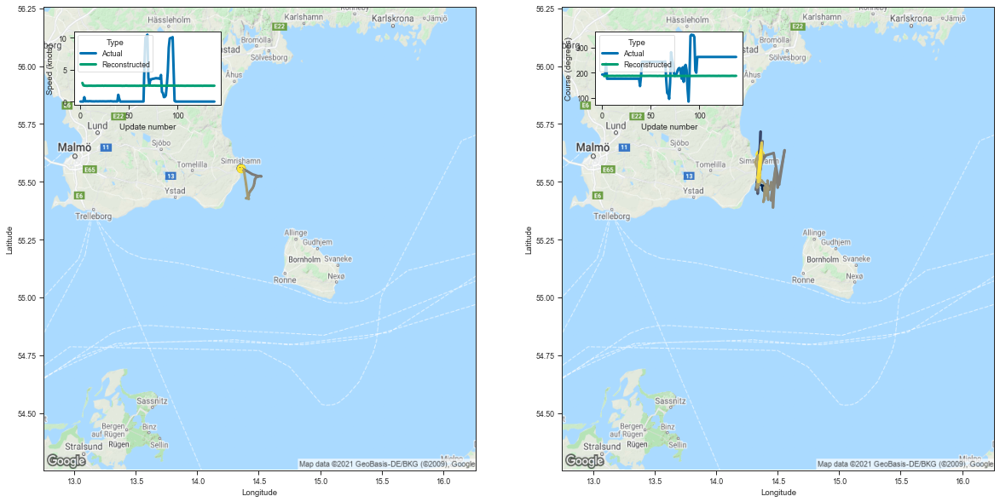

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.402149  55.472481  2.921919  186.791565         0.053790   
3    14.333662  55.497185  2.544698  187.418030         0.018985   
4    14.354220  55.531536  2.490391  187.530533         0.015662   
5    14.363503  55.598194  2.481776  187.714905         0.015425   
6    14.342174  55.521729  2.469781  187.463287         0.015350   
..         ...        ...       ...         ...              ...   
134  14.363705  55.635746  2.483611  187.916000         0.015350   
135  14.360436  55.594860  2.475070  187.673386         0.015155   
136  14.349175  55.543877  2.477953  187.561218         0.015127   
137  14.360975  55.616661  2.472503  187.791122         0.015158   
138  14.358054  55.617741  2.482243  187.780884         0.015337   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.157254     3.510350    100.097008                 1   
3          0.067647     3.347797    100.525322 

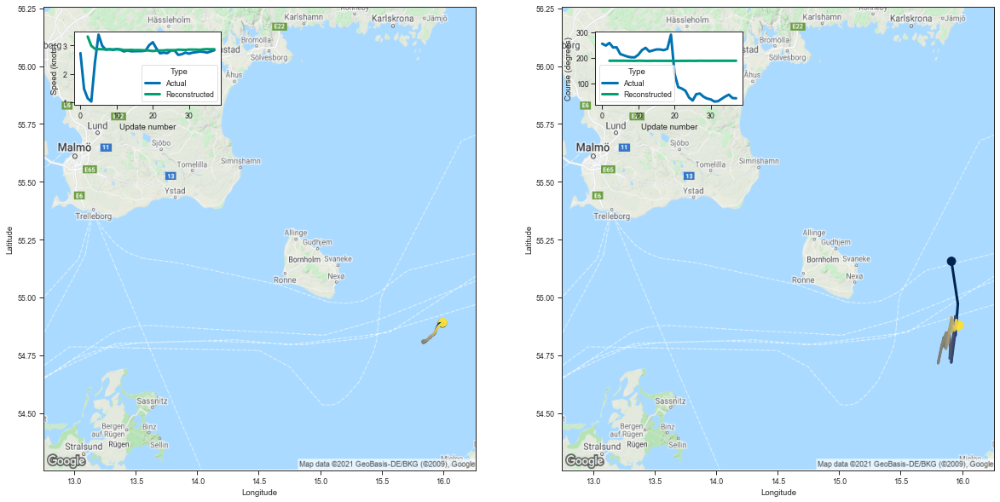

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.913329  55.156029  3.315289  188.053741         0.048232   
3   15.965588  54.971222  2.987966  188.209518         0.017514   
4   15.952130  54.886761  2.880955  188.097168         0.013462   
5   15.948918  54.869518  2.869119  188.042404         0.013059   
6   15.955104  54.916298  2.866507  188.209854         0.012933   
7   15.946614  54.837418  2.859443  187.880722         0.012795   
8   15.939992  54.831505  2.859827  187.881927         0.012742   
9   15.911987  54.718914  2.861349  187.538849         0.012734   
10  15.944996  54.917820  2.862051  188.166672         0.012968   
11  15.939921  54.877075  2.862114  188.026169         0.012849   
12  15.899782  54.735630  2.837446  187.534119         0.012695   
13  15.903002  54.778740  2.838797  187.645523         0.012683   
14  15.894540  54.856636  2.843882  187.892929         0.012668   
15  15.877155  54.816498  2.835153  187.778229         0.01256

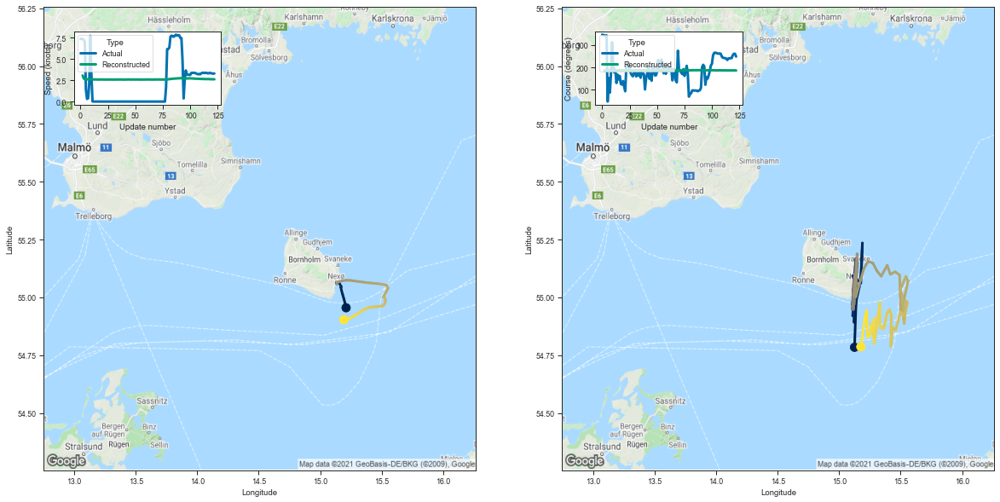

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.125200  54.784088  3.060288  185.737030         0.045531   
3    15.137795  54.983284  2.704957  186.998566         0.016943   
4    15.121231  54.892609  2.625642  186.779968         0.013265   
5    15.124638  54.951805  2.620862  186.950302         0.012961   
6    15.163815  55.044323  2.617876  187.262299         0.012393   
..         ...        ...       ...         ...              ...   
118  15.250344  54.835487  2.625319  186.775574         0.012267   
119  15.232629  54.829353  2.616732  186.743942         0.012116   
120  15.223915  54.943817  2.615235  187.042892         0.012221   
121  15.209426  54.907948  2.617683  186.922058         0.012225   
122  15.176346  54.786026  2.608235  186.496353         0.012158   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146131     3.149456     99.642372                 1   
3          0.066624     2.974178    100.398178 

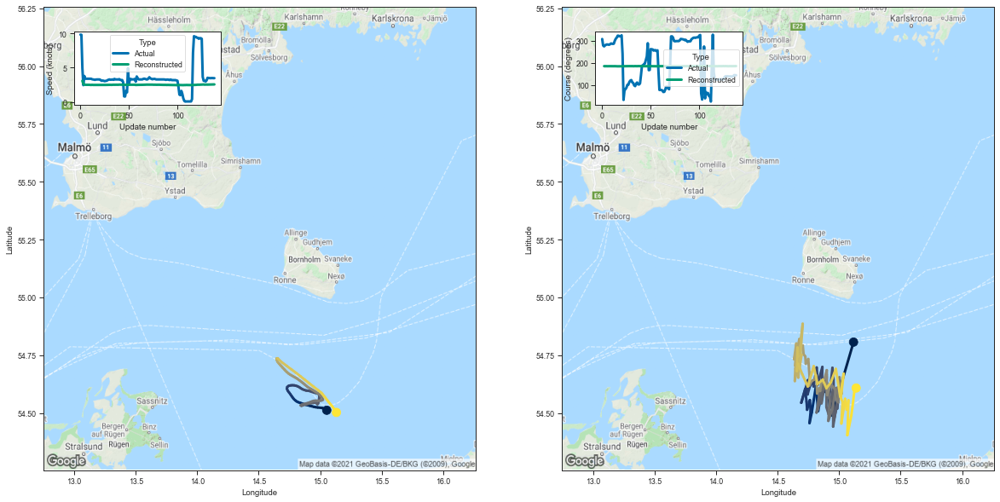

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.117303  54.806503  3.105765  185.623978         0.051857   
3    14.942595  54.489376  2.627344  185.166092         0.015839   
4    14.955329  54.595222  2.550584  185.567886         0.012759   
5    14.923441  54.522041  2.521869  185.245392         0.012153   
6    14.912755  54.588619  2.523758  185.440247         0.012124   
..         ...        ...       ...         ...              ...   
134  15.066781  54.403870  2.550921  185.158768         0.011767   
135  15.099575  54.489597  2.565067  185.488541         0.011964   
136  15.107214  54.520939  2.566350  185.555801         0.011906   
137  15.123156  54.590767  2.564546  185.782944         0.011859   
138  15.138350  54.607925  2.577035  185.906128         0.011884   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.165506     3.173916     99.567749                 1   
3          0.065089     2.930104     99.417427 

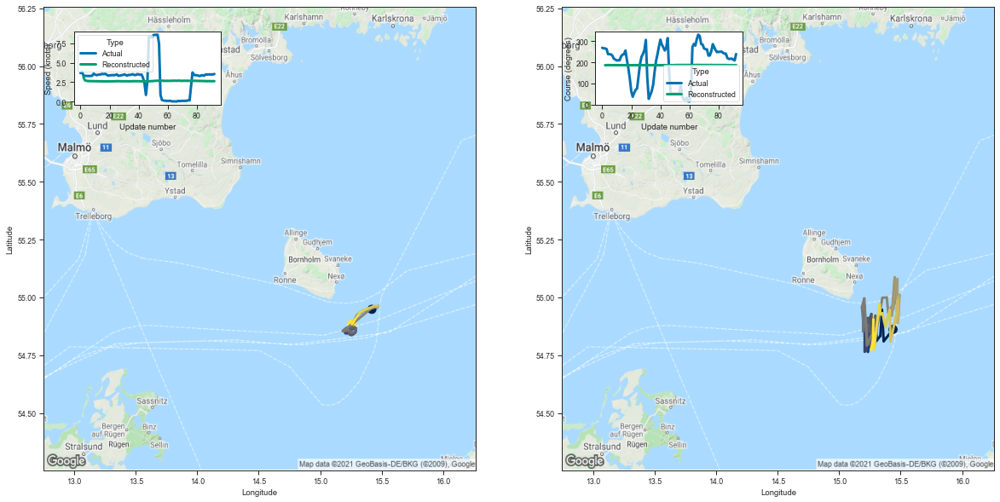

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.437938  54.861423  3.163910  186.507889         0.046815   
3   15.362356  54.810242  2.754179  186.750504         0.015989   
4   15.348408  54.946331  2.683134  187.313232         0.012818   
5   15.335706  54.833778  2.653508  186.927734         0.012217   
6   15.303370  54.812004  2.639644  186.765671         0.012107   
..        ...        ...       ...         ...              ...   
88  15.287466  54.815189  2.639850  186.749115         0.012270   
89  15.285786  54.842503  2.637664  186.859283         0.012135   
90  15.259882  54.773731  2.627089  186.591919         0.011982   
91  15.275096  54.798359  2.632987  186.644989         0.012213   
92  15.278477  54.905293  2.630176  187.050140         0.012142   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.152170     3.086398    100.072128                 1   
3         0.064894     2.889194    100.311523                

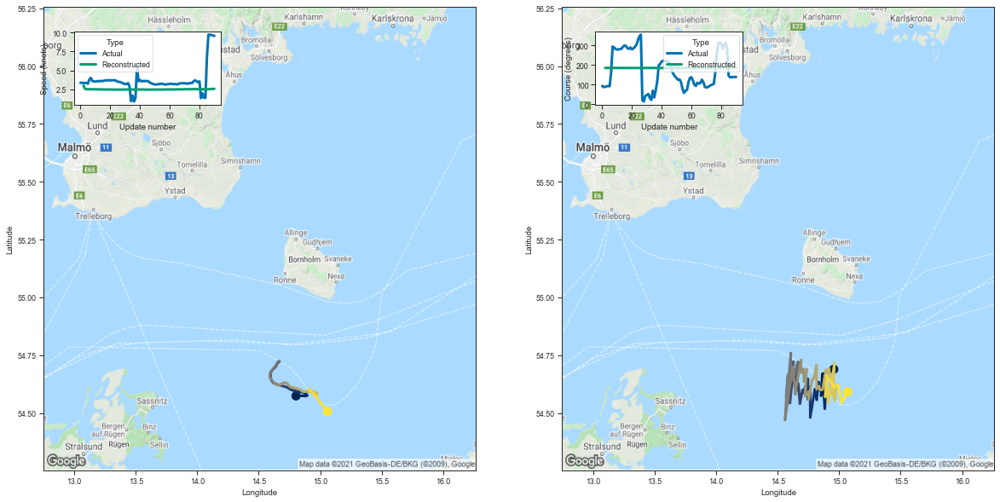

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.956536  54.688980  3.007857  185.138718         0.046584   
3   14.863522  54.668236  2.596130  185.603546         0.015920   
4   14.853123  54.575085  2.536175  185.366547         0.012949   
5   14.884213  54.615345  2.525252  185.512634         0.012523   
6   14.894839  54.617245  2.522141  185.525604         0.012383   
..        ...        ...       ...         ...              ...   
86  14.919863  54.645092  2.523755  185.639313         0.012314   
87  14.959352  54.612362  2.549746  185.629654         0.012611   
88  14.992307  54.621109  2.553819  185.729095         0.012580   
89  15.020864  54.544628  2.564410  185.441269         0.012491   
90  15.069242  54.591805  2.584577  185.779282         0.012515   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.151099     3.173051     99.300270                 1   
3         0.064061     2.992393     99.643242                

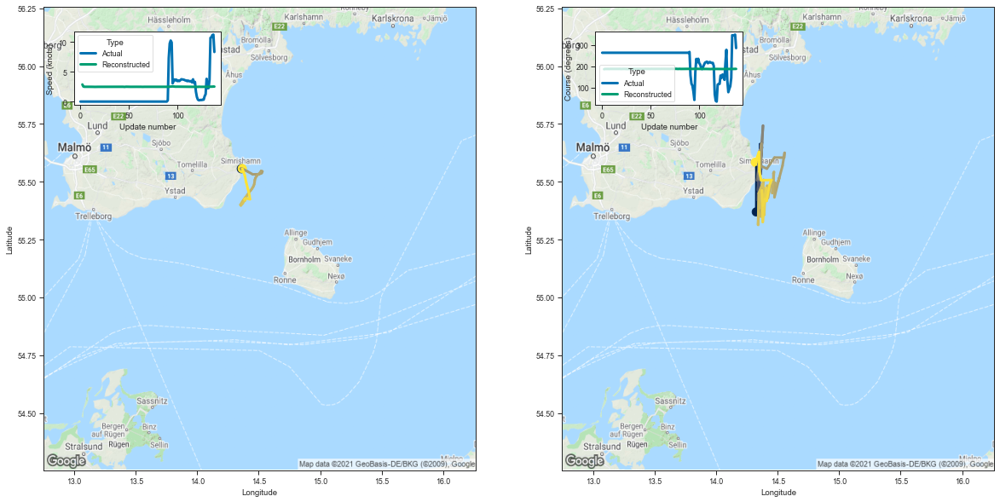

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.326754  55.369537  2.870036  186.316376         0.050060   
3    14.327794  55.563145  2.536526  187.517654         0.019282   
4    14.344033  55.490379  2.484730  187.329498         0.015752   
5    14.349932  55.523220  2.481905  187.498962         0.015309   
6    14.351020  55.558243  2.483434  187.609772         0.015406   
..         ...        ...       ...         ...              ...   
134  14.450496  55.507477  2.498089  187.617813         0.014939   
135  14.366116  55.506393  2.509536  187.505600         0.016139   
136  14.351639  55.544563  2.505655  187.556091         0.016514   
137  14.348667  55.628857  2.523810  187.871780         0.016690   
138  14.319049  55.584133  2.513236  187.665497         0.016847   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150176     3.505554     99.855202                 1   
3          0.070449     3.344512    100.577103 

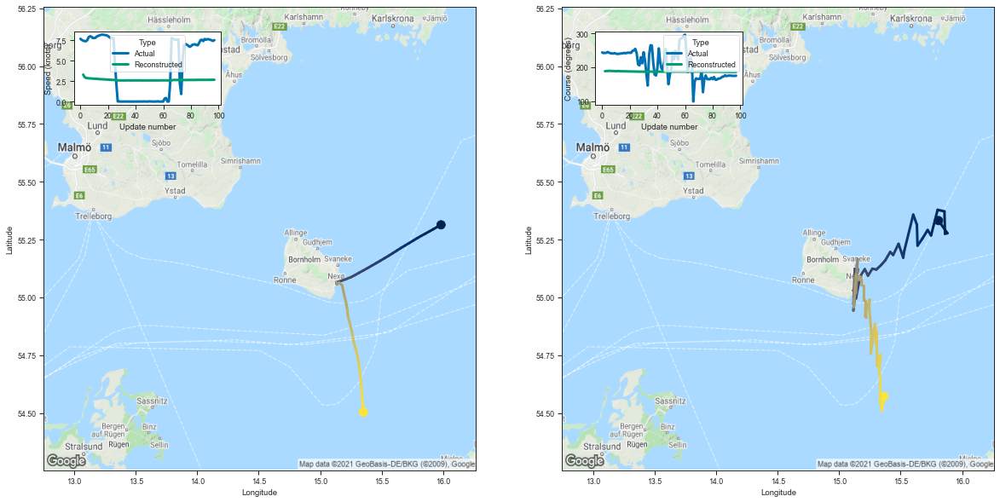

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.807991  55.331997  3.292942  188.475647         0.048615   
3   15.880403  55.277393  2.985247  189.057358         0.018305   
4   15.860737  55.275047  2.888888  189.116486         0.014529   
5   15.856217  55.371765  2.867569  189.443207         0.013740   
6   15.800860  55.378605  2.845234  189.352356         0.013573   
..        ...        ...       ...         ...              ...   
93  15.334023  54.543438  2.653194  186.044586         0.012317   
94  15.348480  54.510452  2.653359  185.929047         0.012242   
95  15.348383  54.518967  2.655287  185.968750         0.012285   
96  15.368509  54.566433  2.665641  186.191116         0.012156   
97  15.363012  54.571377  2.658913  186.137756         0.012158   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.154415     3.094884    101.160080                 1   
3         0.069412     2.878331    101.578865                

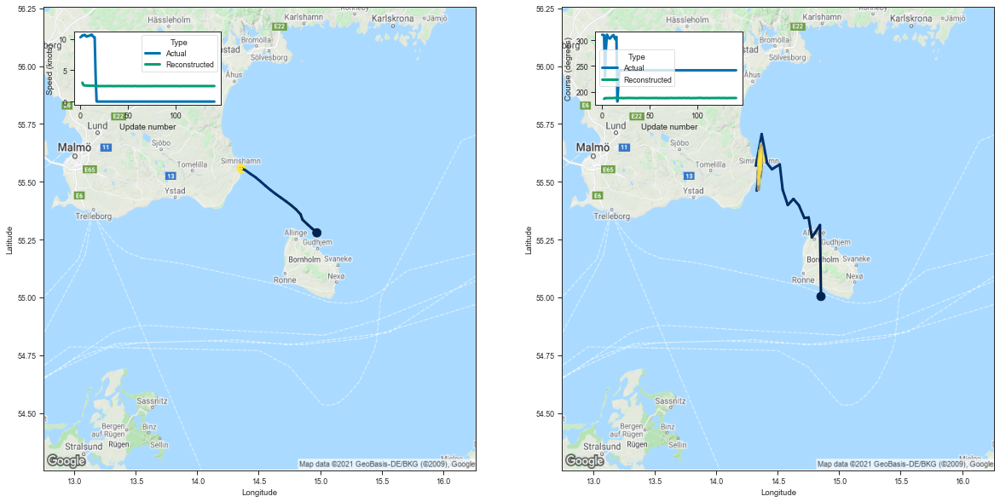

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.852625  55.003895  3.026853  186.014008         0.050260   
3    14.844254  55.312618  2.654262  187.501587         0.017947   
4    14.805239  55.279903  2.580018  187.441971         0.014781   
5    14.778350  55.259743  2.570124  187.345444         0.014381   
6    14.751791  55.345623  2.569663  187.581116         0.014474   
..         ...        ...       ...         ...              ...   
137  14.360964  55.597454  2.475361  187.709259         0.015082   
138  14.363989  55.616711  2.485303  187.804764         0.015364   
139  14.362827  55.619968  2.481179  187.782654         0.015286   
140  14.349955  55.574921  2.475289  187.636292         0.015385   
141  14.363243  55.600384  2.478539  187.685944         0.015304   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.153106     3.301644     99.754387                 1   
3          0.068934     3.154000    100.645424 

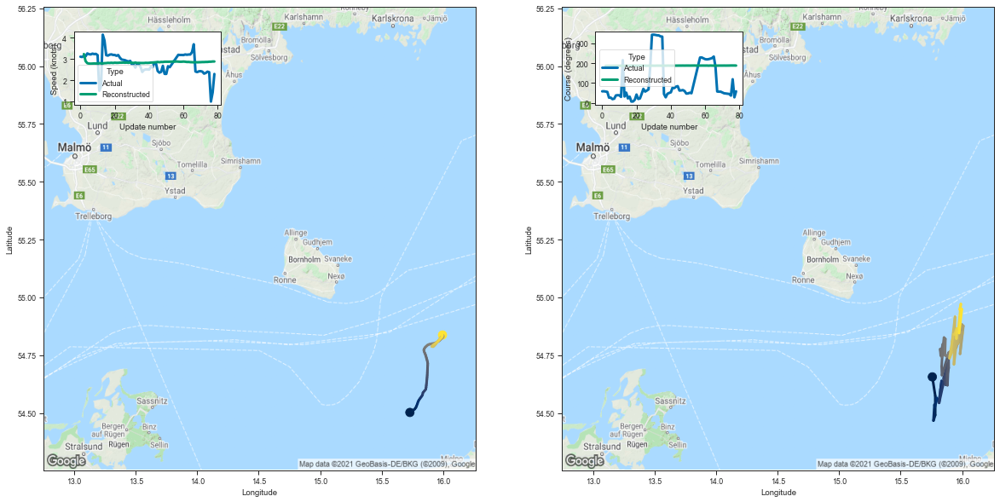

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.757801  54.656086  3.236366  186.317932         0.045004   
3   15.781658  54.573795  2.901476  186.699661         0.016530   
4   15.781292  54.491035  2.803975  186.635757         0.012773   
5   15.767029  54.466873  2.785437  186.453995         0.012156   
6   15.775235  54.535709  2.781473  186.710953         0.012232   
..        ...        ...       ...         ...              ...   
74  15.969240  54.863537  2.862777  188.062943         0.012626   
75  15.989765  54.971260  2.873163  188.376221         0.012810   
76  15.979956  54.947899  2.874221  188.359360         0.012859   
77  15.997900  54.948795  2.884356  188.359238         0.012878   
78  15.975760  54.845016  2.884383  188.001740         0.012750   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.148056     2.963419    100.029739                 1   
3         0.067328     2.757473    100.334579                

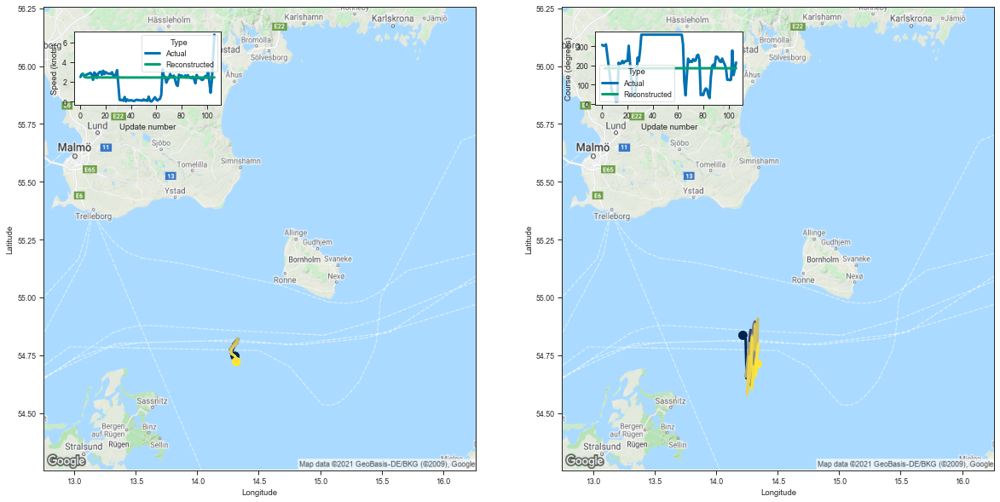

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.217578  54.835873  2.851516  184.650269         0.050375   
3    14.240314  54.819229  2.512599  185.211975         0.018675   
4    14.248215  54.650345  2.455306  184.693405         0.015560   
5    14.270056  54.721333  2.442997  184.878906         0.015109   
6    14.294814  54.759537  2.444123  185.057114         0.014909   
..         ...        ...       ...         ...              ...   
102  14.303673  54.699898  2.458580  184.930618         0.014926   
103  14.288460  54.603115  2.443087  184.616241         0.014740   
104  14.343643  54.797752  2.450308  185.234085         0.014544   
105  14.319542  54.660408  2.436525  184.795792         0.014550   
106  14.335655  54.711845  2.452155  185.012695         0.014734   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150432     3.458442     98.961060                 1   
3          0.068150     3.254559     99.343033 

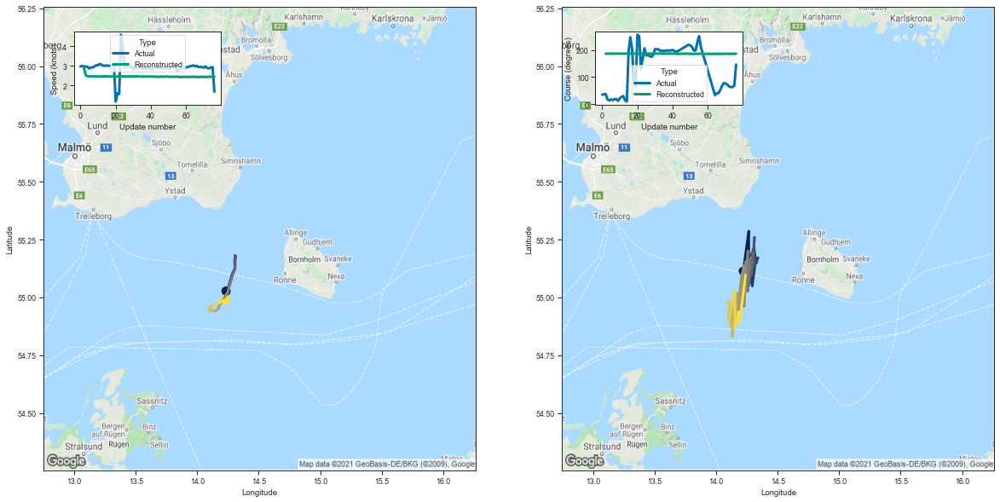

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.221270  55.113461  2.881655  185.498779         0.052669   
3   14.265497  55.285851  2.529227  186.569458         0.019479   
4   14.265491  55.064247  2.473040  185.989731         0.016242   
5   14.286653  55.064495  2.462039  185.981277         0.015470   
6   14.289862  55.084362  2.464536  186.081390         0.015380   
..        ...        ...       ...         ...              ...   
72  14.151756  54.865921  2.430994  185.164230         0.015819   
73  14.182780  54.937359  2.450889  185.472900         0.015871   
74  14.188588  54.893883  2.444944  185.359116         0.015748   
75  14.207154  54.958622  2.442472  185.547256         0.015623   
76  14.239248  55.096992  2.454628  186.047379         0.015670   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.152391     3.522800     99.401604                 1   
3         0.070604     3.335739    100.073372                

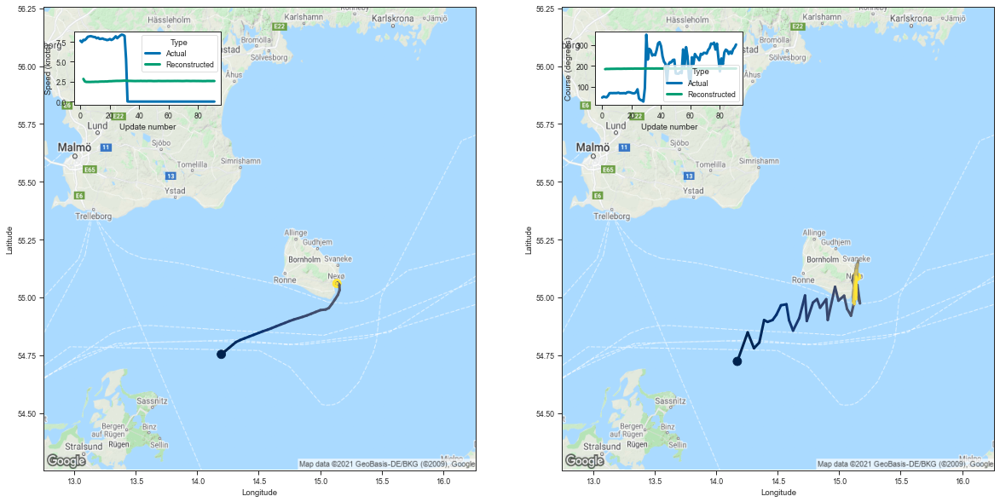

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.172436  54.723068  2.846161  184.274063         0.050717   
3   14.256772  54.848412  2.527251  185.255402         0.019169   
4   14.307797  54.779812  2.467758  185.161911         0.015597   
5   14.351630  54.804653  2.467185  185.303268         0.015068   
6   14.390114  54.901764  2.462741  185.637802         0.014884   
..        ...        ...       ...         ...              ...   
87  15.134636  55.033043  2.586748  187.220230         0.012101   
88  15.140291  55.068508  2.585104  187.307922         0.011995   
89  15.132390  55.049698  2.580291  187.181351         0.011894   
90  15.136885  54.992470  2.587790  187.056641         0.012049   
91  15.141073  55.089409  2.581911  187.298264         0.012063   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.147180     3.477639     98.762062                 1   
3         0.069546     3.265931     99.382851                

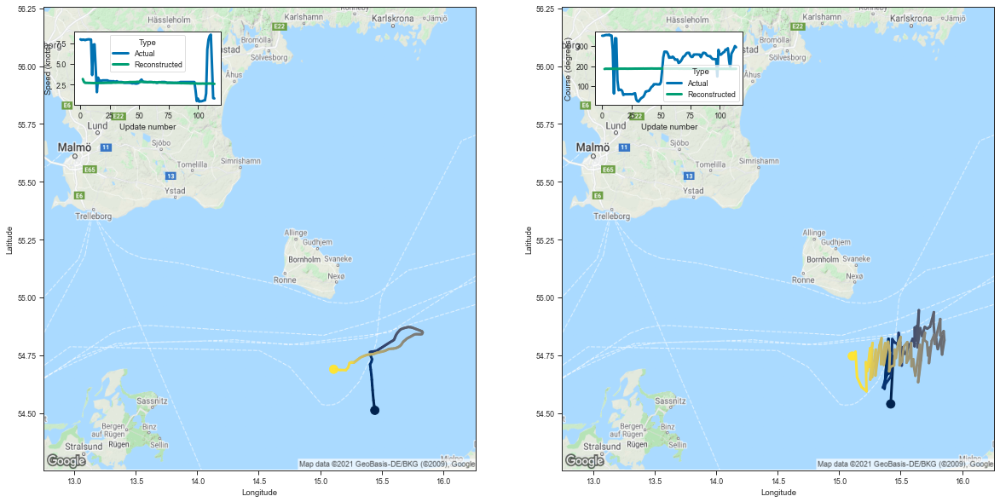

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.419559  54.538929  3.163463  185.479919         0.046999   
3    15.440755  54.745407  2.813226  186.708923         0.017014   
4    15.410692  54.689419  2.697215  186.589386         0.013052   
5    15.403812  54.670788  2.691899  186.536041         0.012670   
6    15.402111  54.674774  2.693149  186.568237         0.012528   
..         ...        ...       ...         ...              ...   
110  15.222844  54.593739  2.616713  185.925049         0.012256   
111  15.182311  54.612095  2.611597  185.993744         0.012459   
112  15.145658  54.655128  2.606282  186.041443         0.012571   
113  15.133364  54.764526  2.592619  186.327911         0.012365   
114  15.106847  54.745926  2.569908  186.257492         0.011940   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150338     3.053319     99.542648                 1   
3          0.068648     2.880608    100.293343 

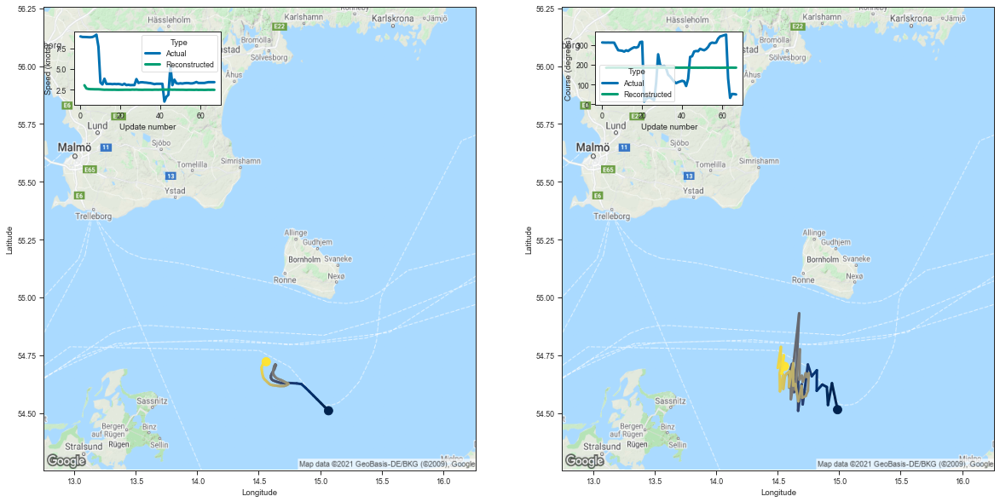

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.987331  54.514114  3.022460  184.720657         0.046399   
3   14.941817  54.628639  2.632535  185.587952         0.016446   
4   14.909227  54.534504  2.571397  185.337402         0.013492   
5   14.900333  54.612122  2.548551  185.541916         0.012992   
6   14.863335  54.622925  2.544845  185.526352         0.013127   
..        ...        ...       ...         ...              ...   
63  14.500861  54.694851  2.465524  185.211182         0.014032   
64  14.542346  54.724949  2.475209  185.338150         0.013557   
65  14.551071  54.749763  2.467717  185.405411         0.013650   
66  14.532214  54.670078  2.477358  185.177872         0.013800   
67  14.556214  54.701572  2.466115  185.267670         0.013639   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.147641     3.155408     99.091202                 1   
3         0.065967     2.979563     99.643616                

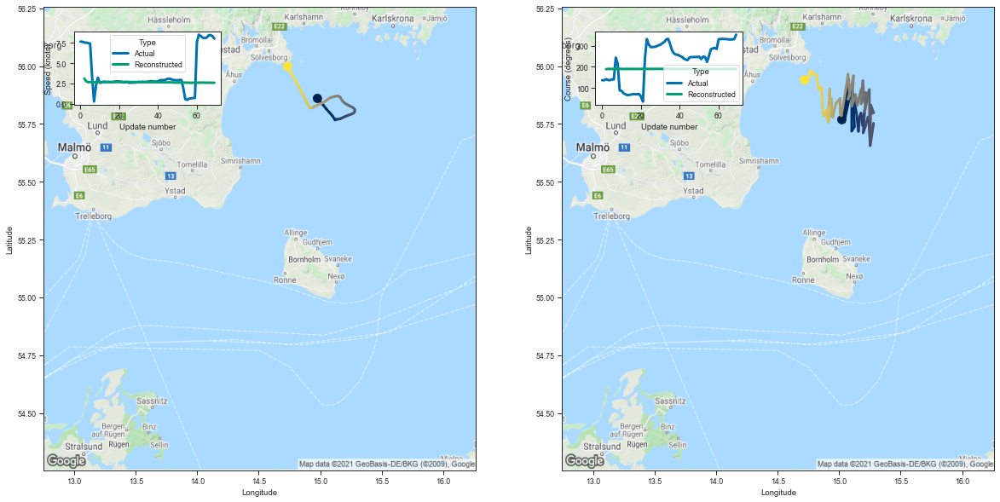

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.021876  55.768459  3.115786  188.650208         0.053668   
3   15.077791  55.940659  2.762731  189.782257         0.019343   
4   15.040507  55.757221  2.668102  189.319626         0.015190   
5   15.091667  55.881649  2.678185  189.793930         0.014672   
6   15.115747  55.843750  2.683050  189.747223         0.014657   
..        ...        ...       ...         ...              ...   
65  14.815863  55.961800  2.594407  189.544907         0.014975   
66  14.800086  55.961319  2.597486  189.555618         0.015153   
67  14.769807  55.980091  2.602743  189.553421         0.015344   
68  14.749215  55.949024  2.590553  189.403091         0.015350   
69  14.719581  55.940571  2.591777  189.309753         0.015486   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.156863     3.418382    101.163216                 1   
3         0.071347     3.222638    101.869797                

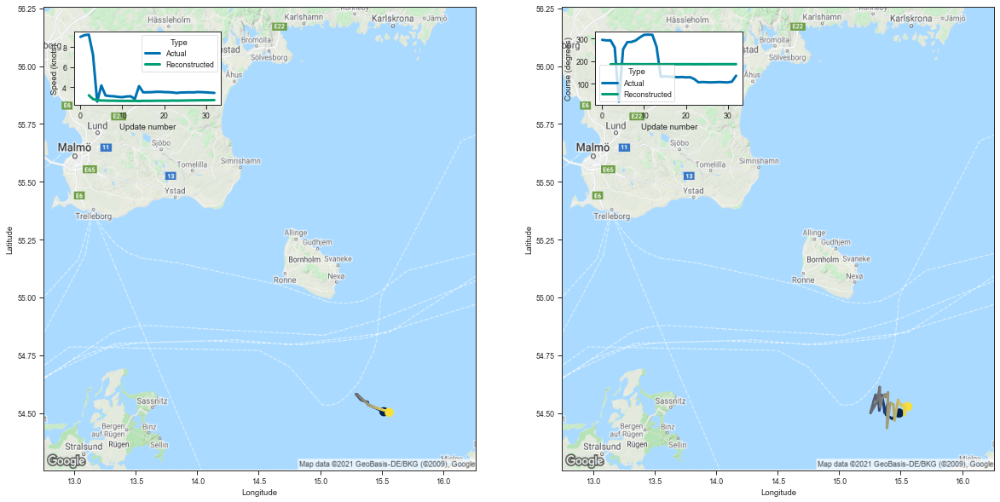

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.488120  54.499516  3.188723  185.481979         0.046620   
3   15.431290  54.475414  2.808431  185.897202         0.016901   
4   15.380930  54.492428  2.691761  185.942673         0.012848   
5   15.396461  54.540356  2.668773  186.112274         0.012061   
6   15.368872  54.501686  2.655937  185.953598         0.012048   
7   15.362032  54.536720  2.644750  186.067261         0.011847   
8   15.348250  54.576916  2.647823  186.129395         0.011971   
9   15.326656  54.511070  2.630176  185.863998         0.011839   
10  15.320525  54.549686  2.629896  186.005310         0.011860   
11  15.311808  54.545128  2.628537  185.966095         0.011869   
12  15.296803  54.578468  2.625245  186.100662         0.011966   
13  15.281125  54.552654  2.627417  185.972855         0.011783   
14  15.255485  54.500145  2.613368  185.706924         0.011882   
15  15.309417  54.549480  2.631620  185.976532         0.01189

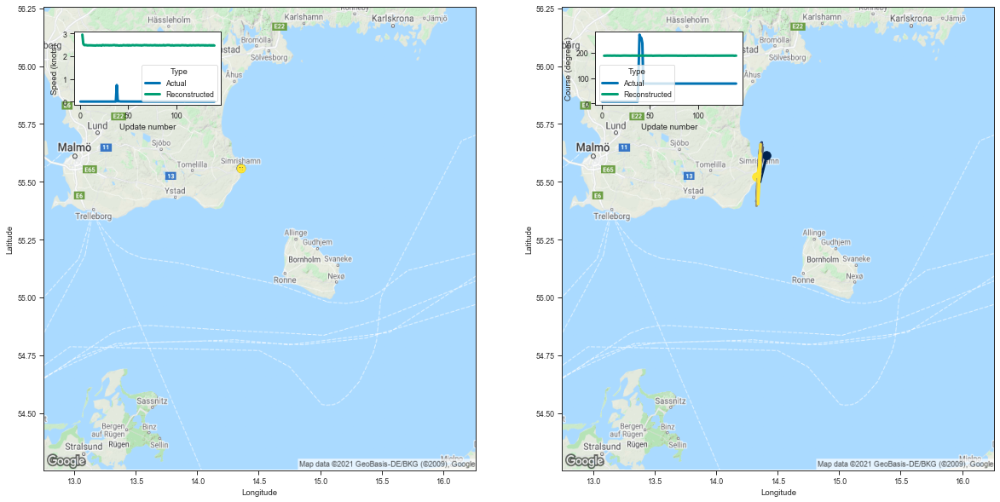

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.411476  55.612579  2.951207  187.222565         0.056146   
3    14.357533  55.499859  2.543628  187.416672         0.019029   
4    14.361442  55.556171  2.489311  187.629166         0.015880   
5    14.359036  55.534962  2.487322  187.537506         0.015553   
6    14.371753  55.634621  2.492452  187.864578         0.015453   
..         ...        ...       ...         ...              ...   
136  14.350883  55.548126  2.470355  187.557068         0.015292   
137  14.359029  55.622612  2.483045  187.841568         0.015346   
138  14.340975  55.403179  2.469862  187.079956         0.015143   
139  14.358929  55.587147  2.483316  187.685059         0.015340   
140  14.330526  55.520123  2.469454  187.440948         0.015337   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.162427     3.562299    100.328400                 1   
3          0.068325     3.332251    100.532570 

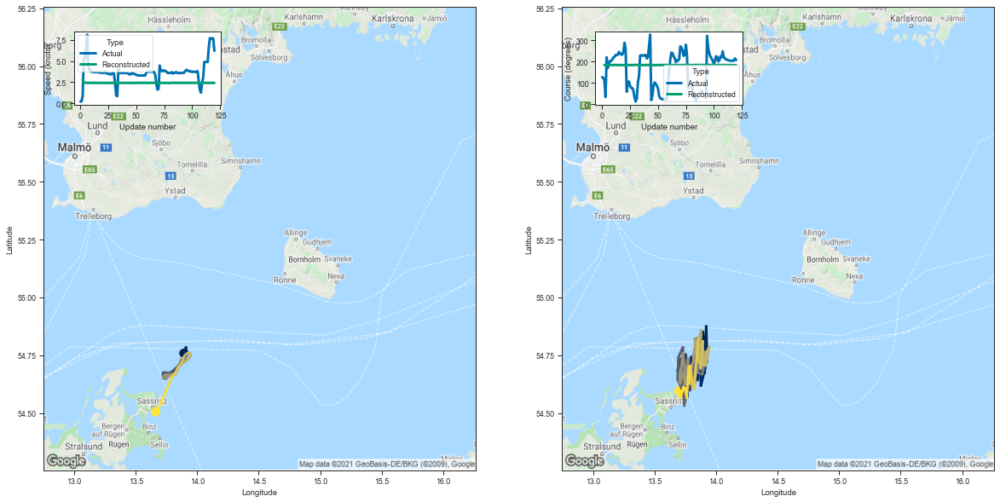

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.892773  54.815353  2.821307  184.065674         0.057739   
3    13.892690  54.850876  2.485850  184.653168         0.022224   
4    13.927023  54.721729  2.434951  184.438065         0.018132   
5    13.919524  54.874882  2.444596  184.955750         0.018237   
6    13.906360  54.672115  2.416357  184.255112         0.017756   
..         ...        ...       ...         ...              ...   
116  13.745680  54.607170  2.417543  183.897858         0.019382   
117  13.735662  54.612701  2.429328  183.911346         0.019590   
118  13.708896  54.564995  2.416722  183.707809         0.019762   
119  13.699054  54.572575  2.414676  183.695953         0.019884   
120  13.694729  54.596333  2.412939  183.828278         0.019871   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.161011     3.621750     98.618866                 1   
3          0.076587     3.431886     99.030426 

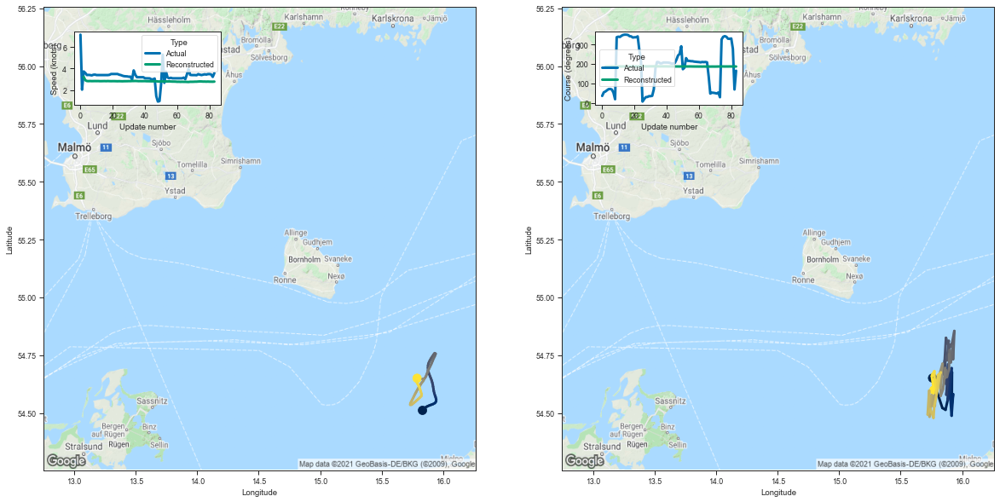

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.759596  54.650936  3.235463  186.385742         0.044092   
3   15.839316  54.521736  2.923440  186.727036         0.016571   
4   15.864943  54.513615  2.849452  186.795837         0.013106   
5   15.884906  54.561878  2.837849  187.013107         0.012660   
6   15.917768  54.676079  2.847018  187.432800         0.012564   
..        ...        ...       ...         ...              ...   
79  15.774840  54.680904  2.797264  187.151230         0.012500   
80  15.755729  54.665520  2.787015  187.059357         0.012448   
81  15.758906  54.661549  2.786098  187.072205         0.012358   
82  15.753253  54.659561  2.782199  187.091003         0.012392   
83  15.769911  54.598972  2.794209  186.905853         0.012201   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.145561     2.960974    100.060837                 1   
3         0.066149     2.735132    100.346344                

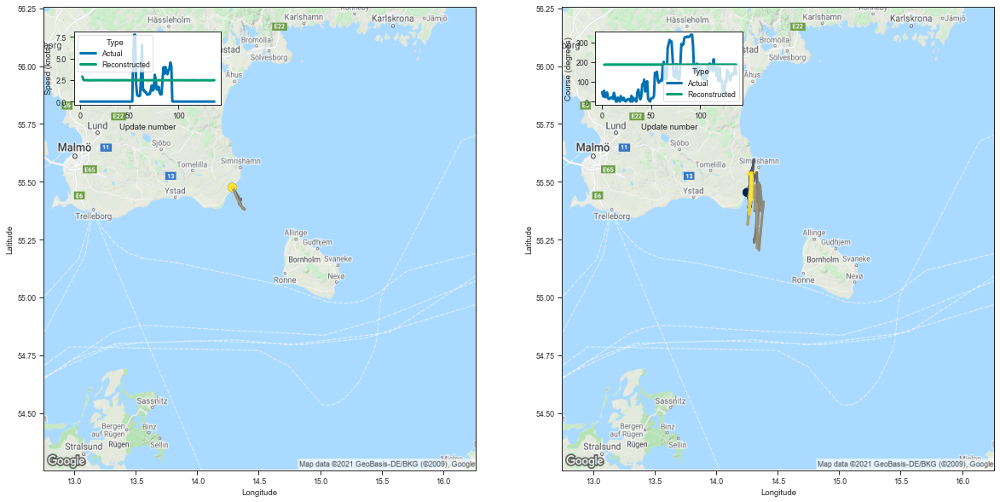

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.251662  55.453861  2.890687  186.491241         0.053628   
3    14.255749  55.444435  2.520244  186.974838         0.019681   
4    14.279511  55.391884  2.479080  187.014221         0.016201   
5    14.296154  55.481647  2.478643  187.292725         0.015770   
6    14.288663  55.490067  2.477261  187.311737         0.015812   
..         ...        ...       ...         ...              ...   
133  14.289169  55.440823  2.452612  187.117920         0.015539   
134  14.284983  55.420238  2.468153  187.062607         0.015509   
135  14.285692  55.441639  2.470650  187.190659         0.015627   
136  14.283367  55.435658  2.476511  187.135239         0.015643   
137  14.285778  55.532379  2.470320  187.422134         0.015739   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.156250     3.551392     99.926254                 1   
3          0.070684     3.361535    100.293503 

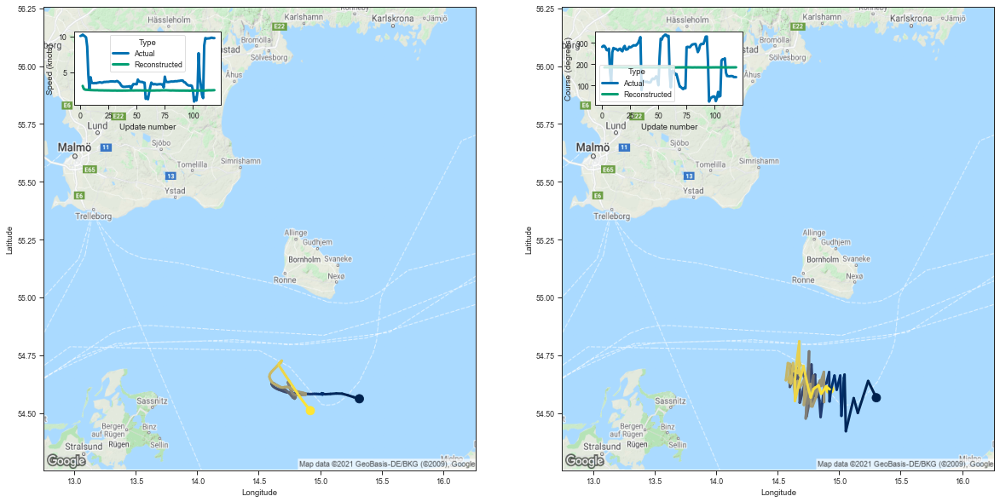

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.302483  54.565819  3.128920  185.289642         0.047274   
3    15.235879  54.638172  2.720195  186.041931         0.016377   
4    15.152127  54.500168  2.625410  185.595245         0.013134   
5    15.118642  54.564003  2.598463  185.732819         0.012753   
6    15.054656  54.421120  2.591074  185.195755         0.012746   
..         ...        ...       ...         ...              ...   
115  14.792178  54.603779  2.520272  185.335037         0.013101   
116  14.832370  54.619598  2.518447  185.439941         0.012954   
117  14.854411  54.583092  2.526184  185.328857         0.012826   
118  14.894172  54.614399  2.533631  185.559753         0.012844   
119  14.923994  54.602032  2.543255  185.527878         0.012684   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.153683     3.074546     99.417534                 1   
3          0.065619     2.908315     99.924759 

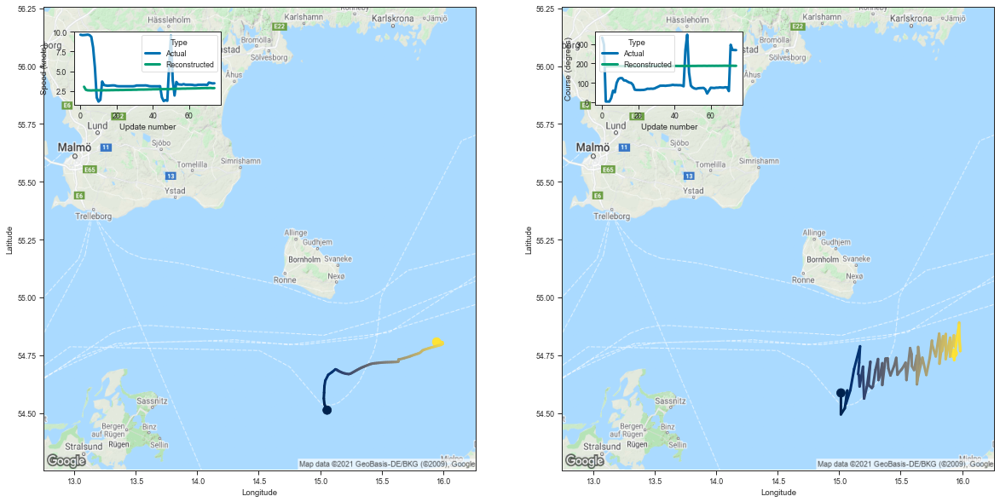

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.014966  54.586685  3.040490  184.962997         0.047750   
3   15.014408  54.493771  2.652477  185.368027         0.015865   
4   15.046326  54.520500  2.588390  185.508423         0.012801   
5   15.066842  54.597336  2.579594  185.775909         0.012476   
6   15.056212  54.540630  2.567920  185.563736         0.012475   
..        ...        ...       ...         ...              ...   
70  15.984729  54.767551  2.864792  187.783310         0.012764   
71  15.984299  54.773544  2.876320  187.799652         0.012699   
72  15.973021  54.879192  2.884019  188.126709         0.013011   
73  15.935422  54.728195  2.860677  187.601044         0.012773   
74  15.928467  54.758568  2.868934  187.666260         0.012882   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.152632     3.163780     99.212044                 1   
3         0.063963     2.914559     99.518974                

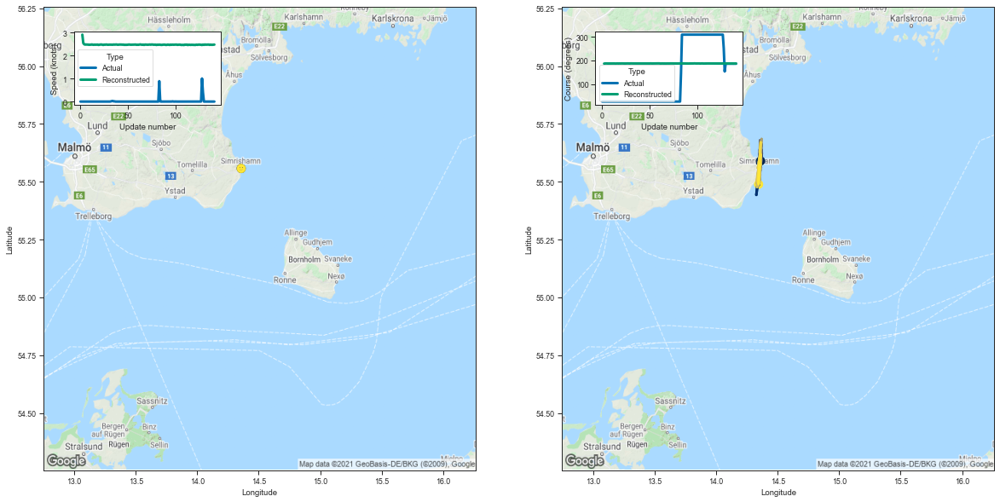

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.361293  55.589989  2.917855  187.041260         0.054767   
3    14.335409  55.579647  2.548493  187.582932         0.019253   
4    14.363955  55.617813  2.495540  187.829453         0.016038   
5    14.354959  55.512573  2.483574  187.489395         0.015454   
6    14.353069  55.529728  2.488420  187.523163         0.015499   
..         ...        ...       ...         ...              ...   
137  14.360473  55.617897  2.482529  187.822510         0.015376   
138  14.343084  55.493427  2.474380  187.356796         0.015321   
139  14.353608  55.581142  2.474392  187.641312         0.015183   
140  14.348466  55.566917  2.480833  187.610748         0.015330   
141  14.345429  55.488777  2.483228  187.374893         0.015273   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.160103     3.555644    100.230293                 1   
3          0.069003     3.351796    100.615616 

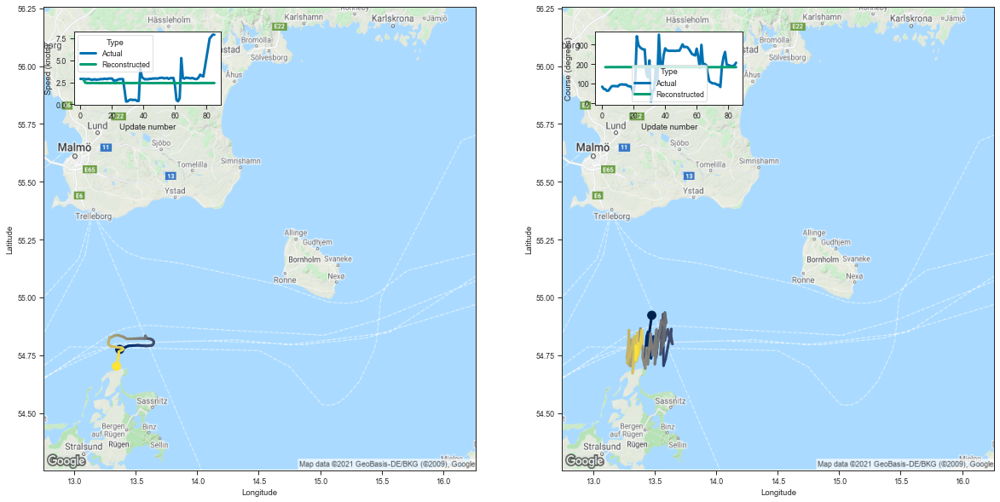

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.477018  54.922356  2.814272  183.699966         0.073635   
3   13.419749  54.705494  2.454164  183.632477         0.027117   
4   13.422566  54.756596  2.418684  183.893311         0.023287   
5   13.436077  54.831749  2.409779  184.160187         0.022687   
6   13.447384  54.851128  2.410233  184.201248         0.022639   
..        ...        ...       ...         ...              ...   
81  13.364247  54.761505  2.410982  183.876480         0.023743   
82  13.351674  54.755703  2.412231  183.803436         0.023667   
83  13.344998  54.730030  2.406074  183.703201         0.023707   
84  13.350689  54.750210  2.411150  183.779739         0.023876   
85  13.346651  54.790363  2.417228  183.936432         0.024069   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.185286     3.857576     98.367638                 1   
3         0.080642     3.653941     98.432030                

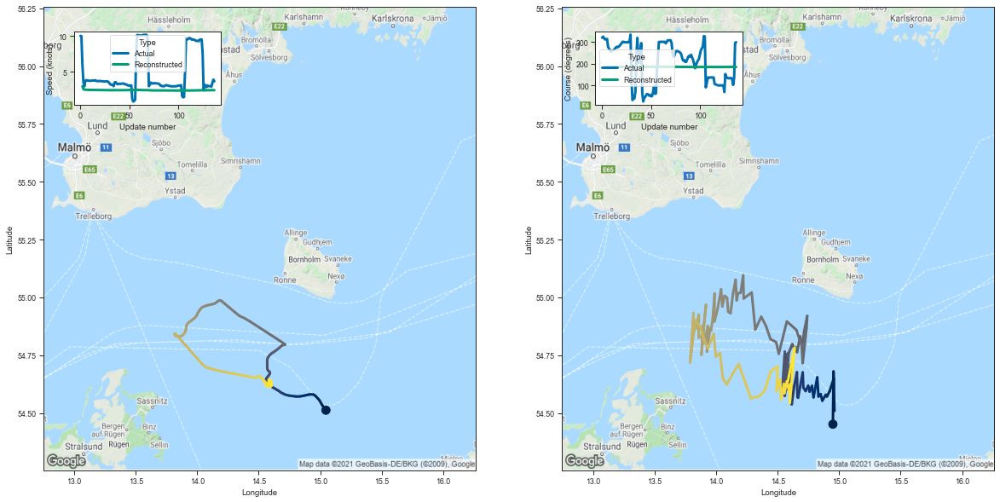

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.949482  54.451469  3.017246  184.477417         0.047537   
3    14.954480  54.679527  2.625412  185.718262         0.016119   
4    14.961658  54.509163  2.558083  185.347656         0.012680   
5    14.953476  54.529312  2.535372  185.375259         0.012237   
6    14.956830  54.649704  2.540749  185.754211         0.012391   
..         ...        ...       ...         ...              ...   
133  14.596459  54.585552  2.475459  185.017105         0.013222   
134  14.604627  54.626022  2.482937  185.147064         0.013327   
135  14.599156  54.544178  2.474814  184.820526         0.013216   
136  14.637859  54.781654  2.479675  185.656128         0.013458   
137  14.584089  54.637798  2.467660  185.118576         0.013490   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150109     3.158081     98.949005                 1   
3          0.066163     2.974365     99.710823 

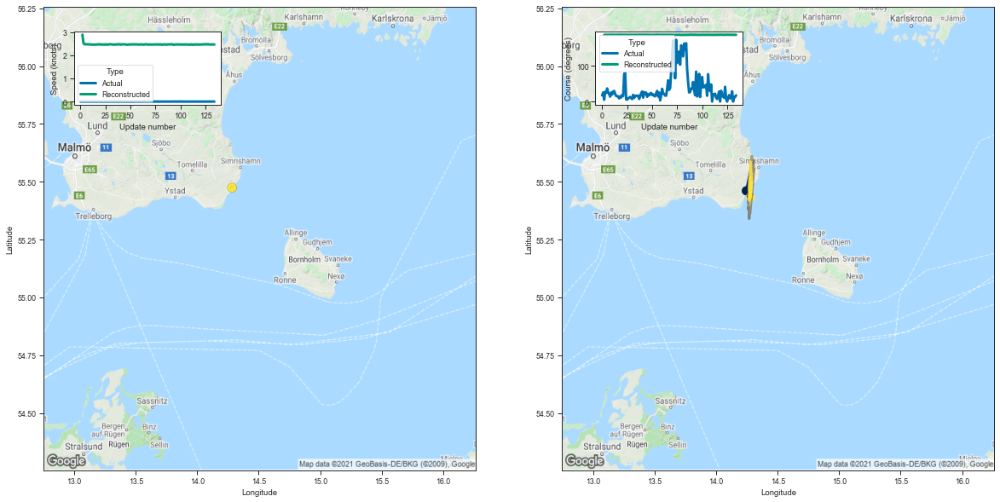

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.245456  55.460857  2.894390  186.570724         0.055110   
3    14.288623  55.569096  2.536632  187.568298         0.019551   
4    14.268797  55.391872  2.476951  186.999969         0.016183   
5    14.290018  55.485336  2.481319  187.308716         0.015861   
6    14.276240  55.453526  2.474816  187.192505         0.015694   
..         ...        ...       ...         ...              ...   
130  14.272473  55.427448  2.469968  187.083313         0.015628   
131  14.279653  55.435352  2.470255  187.126328         0.015824   
132  14.288906  55.495262  2.466937  187.298737         0.015641   
133  14.289038  55.495586  2.469624  187.329727         0.015705   
134  14.278503  55.433163  2.467624  187.106323         0.015694   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.158430     3.579478     99.961906                 1   
3          0.069303     3.375313    100.599556 

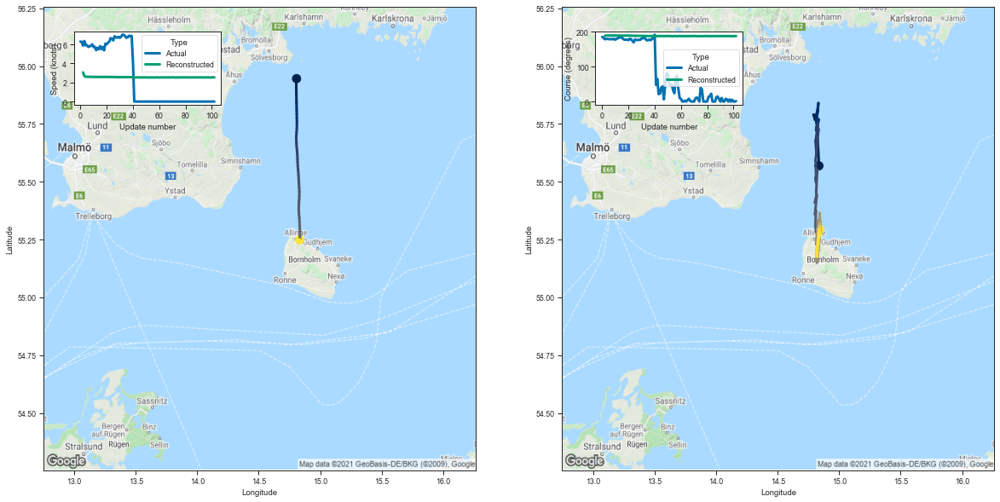

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835958  55.568874  3.062675  187.738403         0.053819   
3    14.818787  55.763470  2.679369  188.886887         0.018837   
4    14.792158  55.790585  2.615976  188.991348         0.015589   
5    14.804825  55.767418  2.598372  188.940598         0.015057   
6    14.804213  55.772507  2.602236  189.011993         0.014936   
..         ...        ...       ...         ...              ...   
98   14.821865  55.176037  2.541040  187.069794         0.013096   
99   14.815582  55.178329  2.529753  187.109436         0.013142   
100  14.834049  55.267590  2.536395  187.425751         0.013000   
101  14.834891  55.258476  2.548306  187.419006         0.013097   
102  14.842628  55.293747  2.540439  187.514816         0.013123   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.156006     3.421077    100.657318                 1   
3          0.068983     3.256477    101.371300 

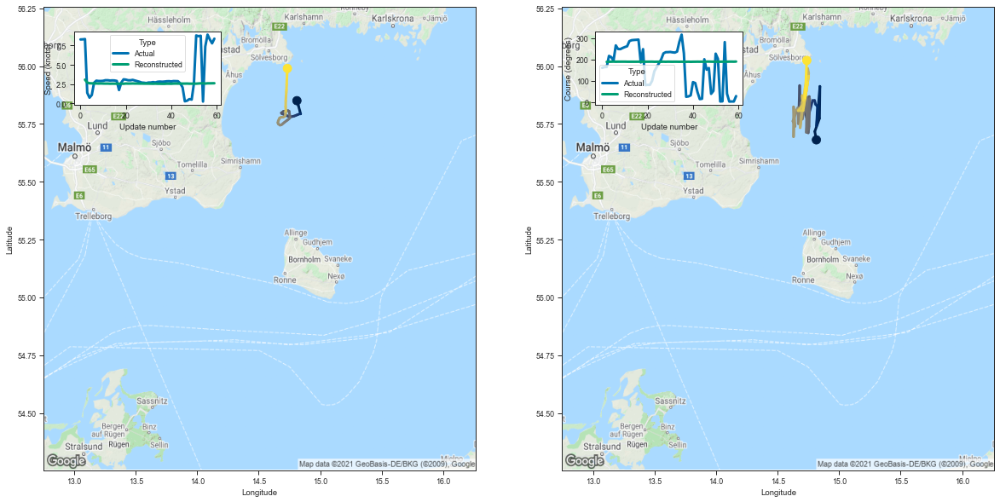

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.815121  55.681141  3.074862  188.069641         0.055197   
3   14.802233  55.717346  2.690083  188.717941         0.019481   
4   14.840630  55.774040  2.606967  189.014786         0.015015   
5   14.843903  55.912632  2.594644  189.429153         0.014466   
6   14.816749  55.741451  2.584581  188.877121         0.014241   
7   14.823949  55.825832  2.582262  189.141647         0.014248   
8   14.808628  55.834641  2.568717  189.078888         0.014306   
9   14.800862  55.851528  2.581282  189.178726         0.014308   
10  14.784503  55.851215  2.567791  189.189514         0.014343   
11  14.751653  55.786949  2.562354  188.892807         0.014309   
12  14.735613  55.777672  2.564787  188.817368         0.014401   
13  14.718940  55.809860  2.549972  188.893494         0.014448   
14  14.707048  55.817940  2.556487  188.888885         0.014546   
15  14.691859  55.805176  2.554160  188.877228         0.01462

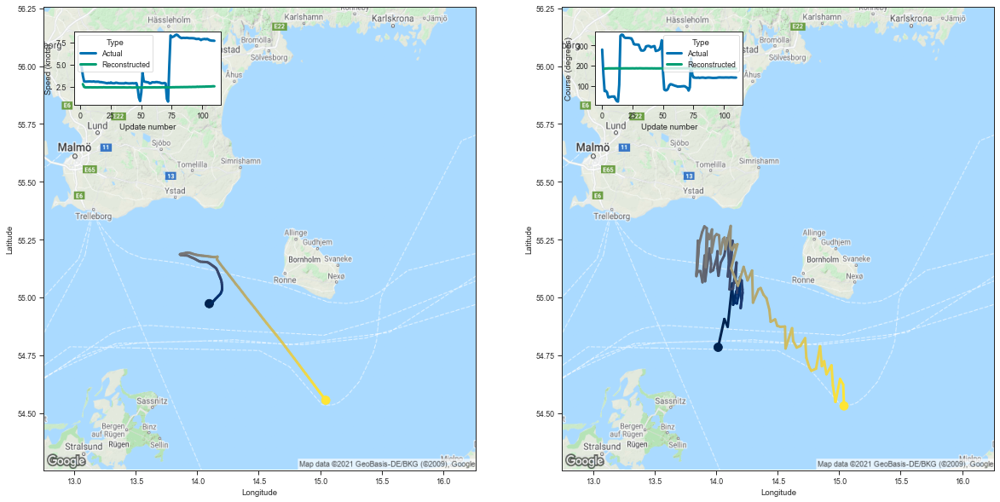

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.016403  54.783974  2.814657  184.172241         0.052503   
3    14.066836  54.906246  2.499635  185.150604         0.020106   
4    14.094134  54.872776  2.447653  185.170898         0.016965   
5    14.131927  55.059784  2.443970  185.754379         0.016506   
6    14.132127  55.041996  2.449564  185.740005         0.016452   
..         ...        ...       ...         ...              ...   
106  14.949324  54.618721  2.548080  185.642410         0.012554   
107  14.970205  54.547653  2.550267  185.456741         0.012517   
108  15.007763  54.646950  2.558271  185.775864         0.012435   
109  15.032846  54.622856  2.573171  185.816391         0.012363   
110  15.039820  54.530514  2.564107  185.512482         0.012329   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149890     3.537289     98.688049                 1   
3          0.070355     3.344019     99.305031 

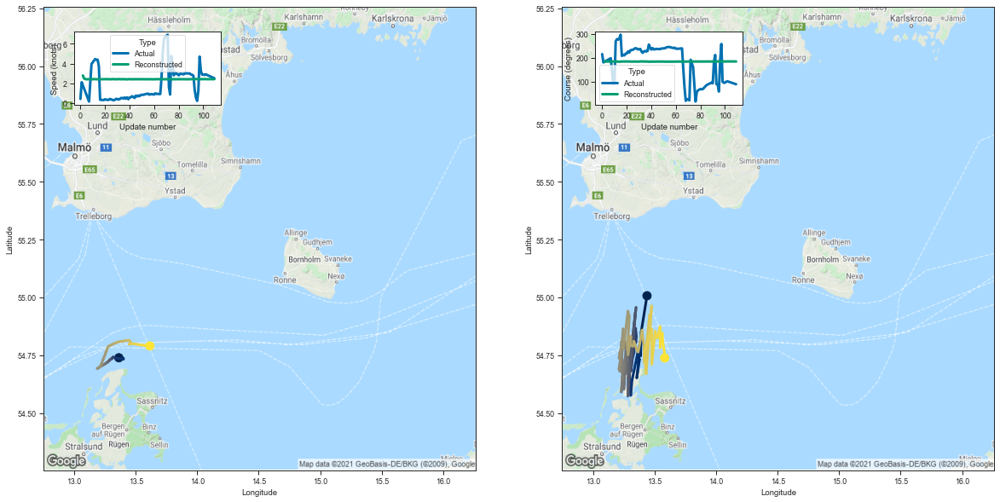

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.438199  55.006950  2.783767  184.011383         0.071403   
3    13.390890  54.850082  2.472104  184.051224         0.028717   
4    13.386432  54.747997  2.415505  183.895523         0.023679   
5    13.385435  54.765171  2.401962  183.829742         0.022986   
6    13.383669  54.807362  2.398299  183.980286         0.023256   
..         ...        ...       ...         ...              ...   
105  13.545584  54.782150  2.409268  184.153732         0.021243   
106  13.562922  54.845093  2.411253  184.414276         0.021043   
107  13.567631  54.802044  2.411108  184.201797         0.020994   
108  13.580364  54.761032  2.407477  184.150452         0.020848   
109  13.582115  54.737751  2.408999  184.085052         0.020748   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.178288     3.877190     98.526985                 1   
3          0.084675     3.704125     98.642616 

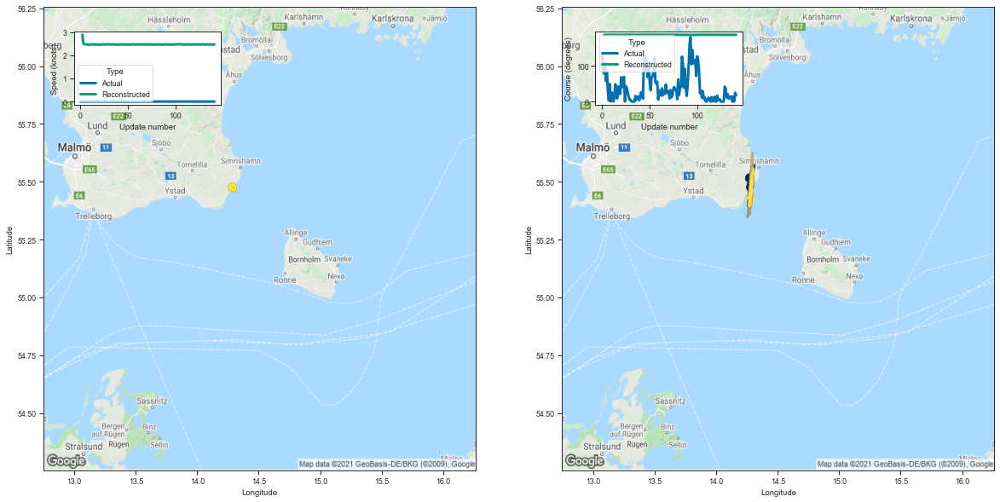

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.271946  55.516060  2.894229  186.767319         0.054037   
3    14.253261  55.475079  2.531667  187.127594         0.019651   
4    14.282458  55.440407  2.480834  187.194046         0.016282   
5    14.284173  55.472988  2.477114  187.268723         0.015977   
6    14.284006  55.493885  2.470607  187.282181         0.015707   
..         ...        ...       ...         ...              ...   
137  14.275753  55.435608  2.462519  187.067383         0.015532   
138  14.291047  55.506798  2.477328  187.361176         0.015736   
139  14.279260  55.434368  2.461830  187.117935         0.015677   
140  14.267920  55.428295  2.473627  187.100037         0.015705   
141  14.276229  55.423157  2.468415  187.078766         0.015550   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.154873     3.568984    100.071716                 1   
3          0.069648     3.371663    100.369179 

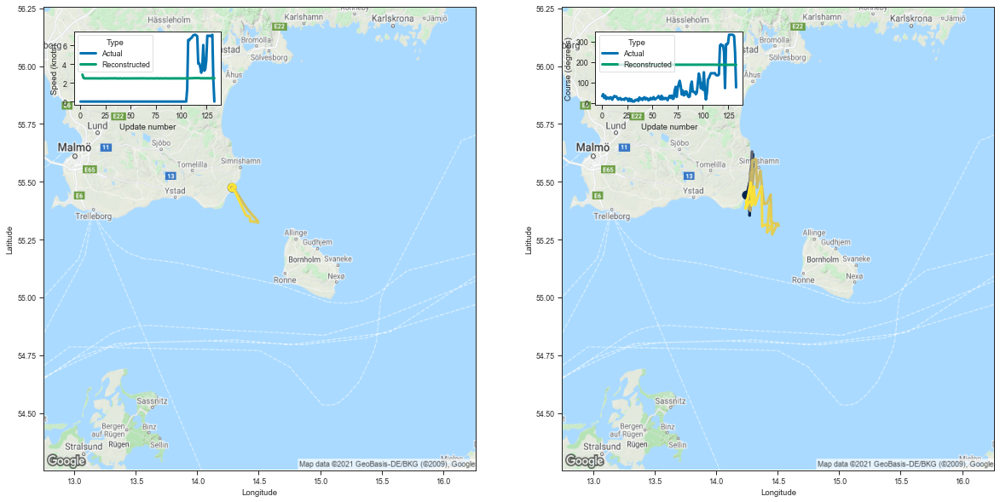

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.248256  55.441959  2.878774  186.420685         0.053395   
3    14.276145  55.508083  2.523395  187.340607         0.019082   
4    14.271814  55.354019  2.471890  186.852753         0.016125   
5    14.294691  55.527924  2.474521  187.446045         0.015892   
6    14.279046  55.440254  2.471982  187.130173         0.015762   
..         ...        ...       ...         ...              ...   
129  14.306818  55.478886  2.483179  187.299606         0.016141   
130  14.289855  55.397228  2.489343  187.061340         0.016127   
131  14.281904  55.495827  2.484629  187.332703         0.016157   
132  14.238480  55.384129  2.469959  186.956680         0.016335   
133  14.271165  55.413883  2.486665  187.067230         0.015817   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.155801     3.552585     99.892700                 1   
3          0.068865     3.363047    100.476860 

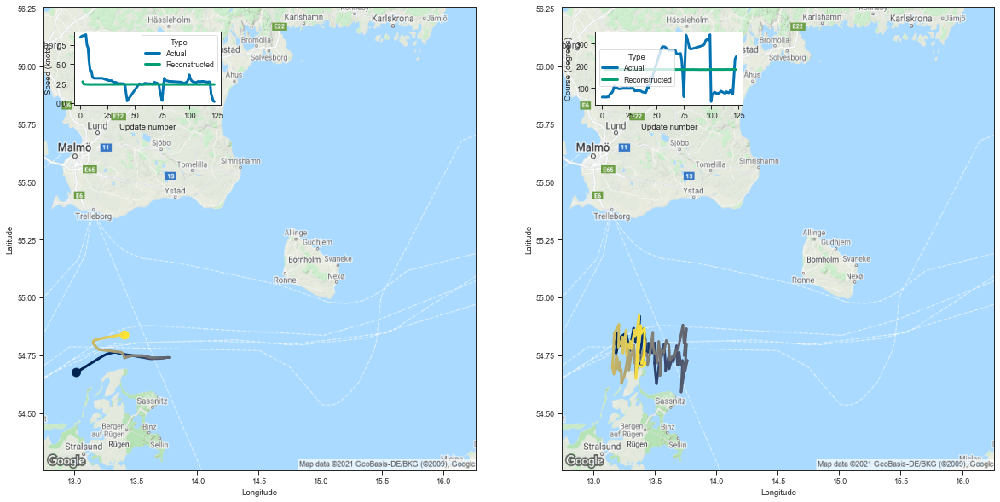

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.209064  54.805084  2.769163  183.022583         0.077395   
3    13.186663  54.758904  2.462626  183.433365         0.032027   
4    13.197710  54.847351  2.421315  183.874252         0.027268   
5    13.209697  54.823120  2.416713  183.856934         0.026123   
6    13.222492  54.828247  2.414774  183.884583         0.025846   
..         ...        ...       ...         ...              ...   
119  13.391665  54.843922  2.417187  184.181625         0.023209   
120  13.416737  54.866039  2.415166  184.251999         0.022757   
121  13.418675  54.850349  2.406966  184.179611         0.022930   
122  13.416217  54.753681  2.409892  183.903839         0.022597   
123  13.394655  54.714966  2.406474  183.716324         0.022840   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.185566     3.970789     97.991348                 1   
3          0.089585     3.804273     98.294373 

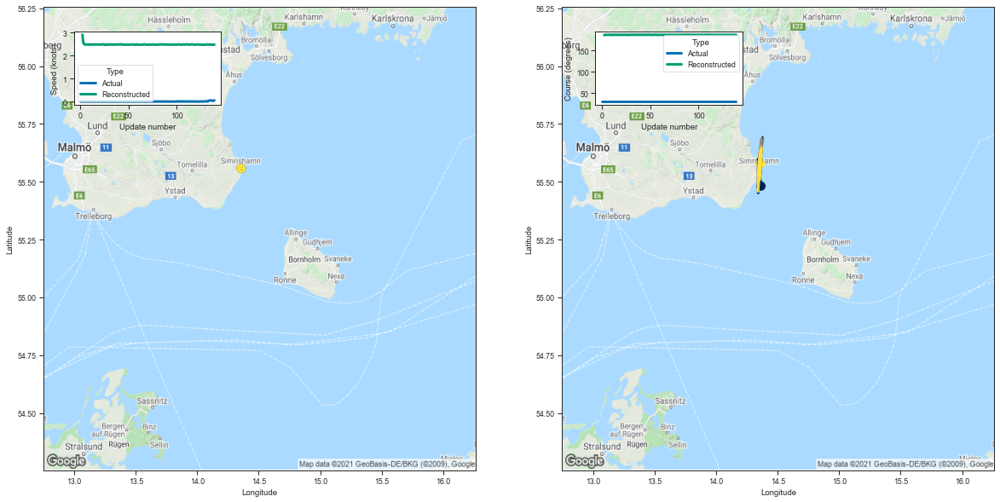

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.365260  55.481174  2.913014  186.864441         0.052628   
3    14.340491  55.597069  2.555150  187.662170         0.019526   
4    14.363138  55.601299  2.497032  187.751236         0.015910   
5    14.351751  55.529514  2.477571  187.512802         0.015353   
6    14.360250  55.575428  2.481542  187.634125         0.015408   
..         ...        ...       ...         ...              ...   
135  14.347980  55.539913  2.481549  187.565414         0.015305   
136  14.340103  55.530308  2.475647  187.498444         0.015420   
137  14.365403  55.642315  2.475192  187.841003         0.015441   
138  14.351399  55.526344  2.474239  187.467087         0.015324   
139  14.360802  55.578388  2.479096  187.713242         0.015288   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.151014     3.541799    100.139938                 1   
3          0.069993     3.359867    100.655106 

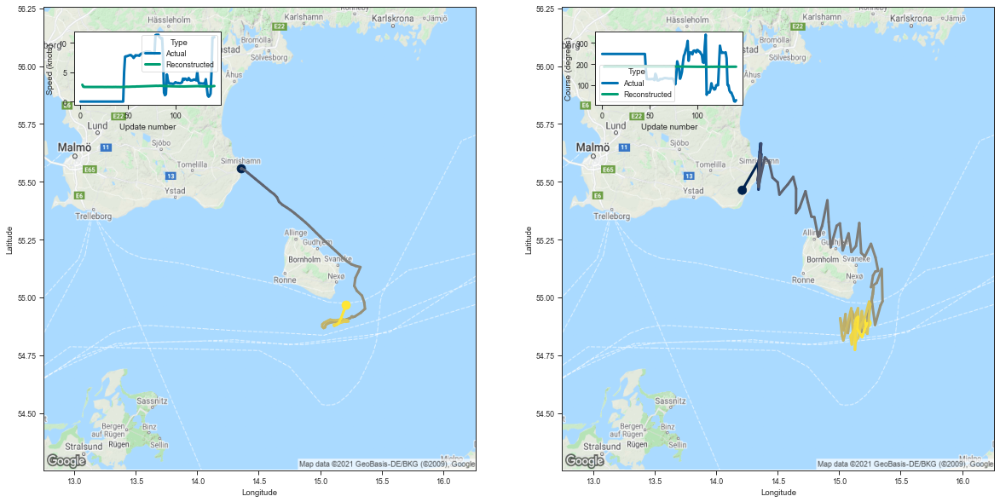

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.212729  55.463280  2.864083  186.436371         0.052847   
3    14.340559  55.582066  2.526530  187.604263         0.018834   
4    14.344237  55.514225  2.484806  187.475815         0.015799   
5    14.365645  55.578083  2.482797  187.708603         0.015290   
6    14.366600  55.620232  2.492876  187.846817         0.015305   
..         ...        ...       ...         ...              ...   
137  15.144045  54.911366  2.581314  186.823242         0.012119   
138  15.155326  54.915646  2.593084  186.834991         0.012253   
139  15.148981  54.862591  2.593719  186.691193         0.012320   
140  15.186426  54.828171  2.633462  186.682709         0.012743   
141  15.227522  54.888321  2.642923  186.906219         0.013076   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.154683     3.548944     99.891106                 1   
3          0.068725     3.339786    100.628563 

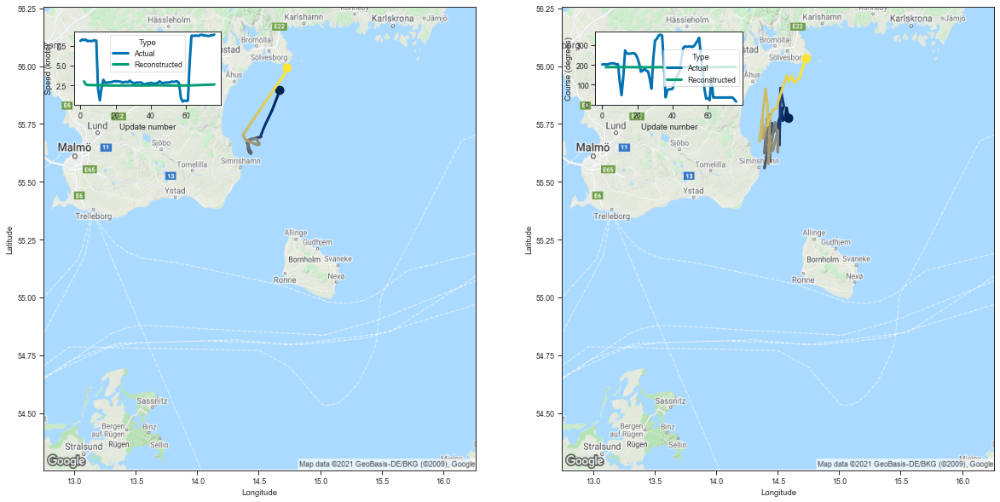

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.590022  55.774525  3.012067  187.912109         0.056857   
3   14.572534  55.819744  2.622046  188.665680         0.019735   
4   14.556774  55.770012  2.560274  188.554535         0.016275   
5   14.559366  55.772434  2.547240  188.563629         0.015920   
6   14.542238  55.764641  2.551848  188.544724         0.015723   
..        ...        ...       ...         ...              ...   
72  14.612033  55.955730  2.584688  189.297943         0.016200   
73  14.638059  55.928726  2.592411  189.205673         0.016245   
74  14.686831  55.955769  2.606128  189.428711         0.016143   
75  14.686784  55.970406  2.601630  189.440674         0.016233   
76  14.731989  56.032688  2.620645  189.696991         0.016306   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.163479     3.539596    100.722099                 1   
3         0.070911     3.347609    101.222878                

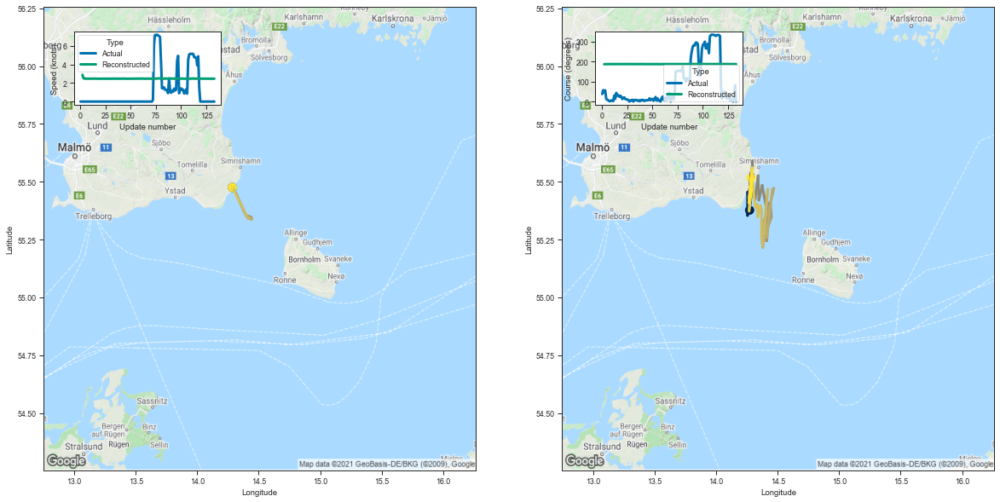

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.272057  55.377113  2.892316  186.353775         0.053032   
3    14.256236  55.455425  2.524770  187.124786         0.019274   
4    14.255428  55.353897  2.478734  186.820923         0.016228   
5    14.288953  55.454617  2.469911  187.195374         0.015766   
6    14.293650  55.529213  2.478544  187.450623         0.015801   
..         ...        ...       ...         ...              ...   
129  14.265523  55.408455  2.463670  187.002029         0.015737   
130  14.299845  55.527729  2.477038  187.435547         0.015573   
131  14.283228  55.502460  2.466585  187.323288         0.015524   
132  14.282873  55.434738  2.470902  187.098770         0.015773   
133  14.283429  55.517433  2.465716  187.354706         0.015552   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.151958     3.562041     99.866104                 1   
3          0.067708     3.368199    100.370651 

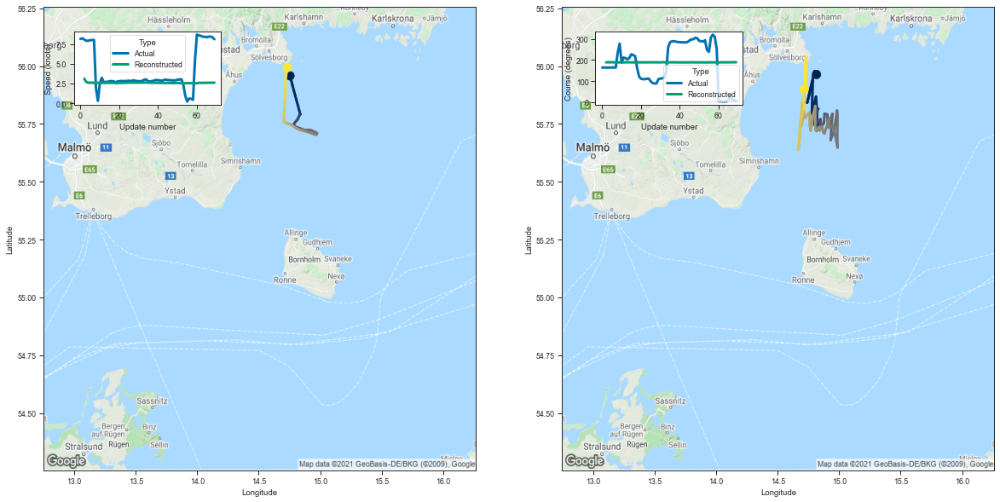

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.815896  55.963779  3.106183  188.844116         0.060487   
3   14.800092  55.978619  2.695694  189.513977         0.019831   
4   14.740748  55.841805  2.615410  189.119965         0.016007   
5   14.786151  55.937679  2.607650  189.454849         0.015490   
6   14.778286  55.796211  2.600824  189.004440         0.015297   
..        ...        ...       ...         ...              ...   
65  14.707311  55.848652  2.599692  189.064850         0.015820   
66  14.722421  55.906265  2.599345  189.296799         0.015772   
67  14.730157  55.907536  2.609258  189.321320         0.015975   
68  14.730345  56.037815  2.604232  189.649902         0.016101   
69  14.716180  55.899349  2.613754  189.289413         0.016099   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.171571     3.527064    101.228035                 1   
3         0.071402     3.315908    101.692154                

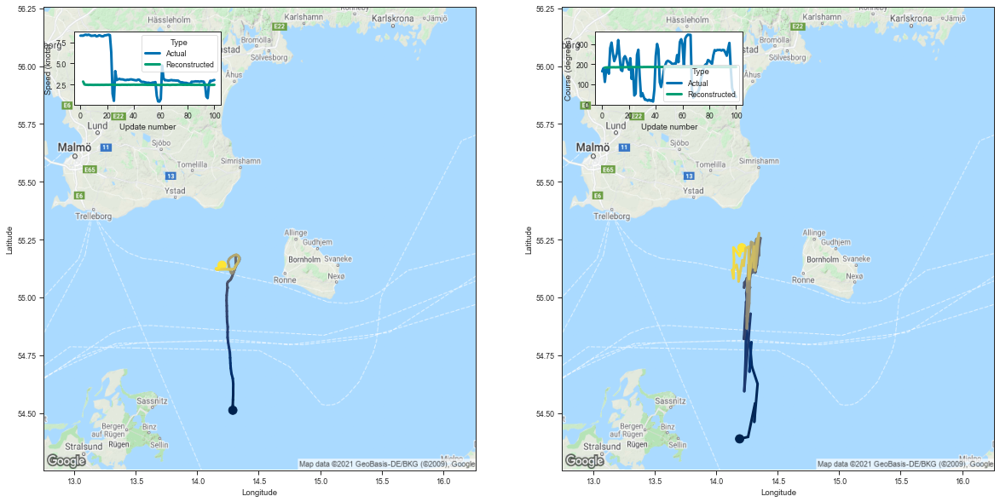

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.191113  54.387993  2.848776  183.301773         0.049462   
3    14.259915  54.396469  2.504484  183.919449         0.018262   
4    14.316185  54.541092  2.466594  184.455811         0.015617   
5    14.310705  54.461548  2.461851  184.224472         0.015157   
6    14.337307  54.625767  2.448666  184.768311         0.015116   
..         ...        ...       ...         ...              ...   
96   14.145639  55.164909  2.451639  186.165756         0.016207   
97   14.140287  55.215328  2.445413  186.275986         0.016261   
98   14.176938  55.190895  2.448458  186.183731         0.016195   
99   14.190869  55.179150  2.450573  186.236862         0.015859   
100  14.209100  55.214558  2.459094  186.350388         0.016009   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146702     3.401747     98.252419                 1   
3          0.067012     3.182456     98.680588 

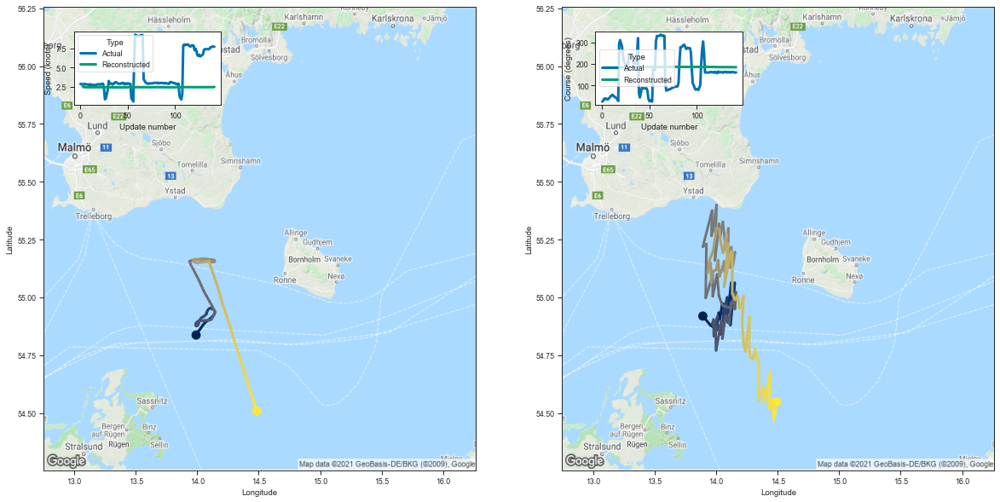

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.891715  54.919018  2.799950  184.371414         0.055687   
3    13.953758  54.879749  2.481527  184.916092         0.020975   
4    13.994128  54.863129  2.449152  184.952454         0.017651   
5    14.020867  54.910004  2.446397  185.159012         0.017275   
6    14.020988  54.933643  2.436140  185.275223         0.017116   
..         ...        ...       ...         ...              ...   
138  14.431717  54.518017  2.458952  184.540344         0.014250   
139  14.451621  54.555370  2.468777  184.670303         0.014098   
140  14.463179  54.504948  2.467153  184.588928         0.014133   
141  14.469784  54.467365  2.454518  184.455734         0.013871   
142  14.492697  54.548073  2.484781  184.762634         0.014153   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.158197     3.624951     98.783356                 1   
3          0.072033     3.399612     99.168457 

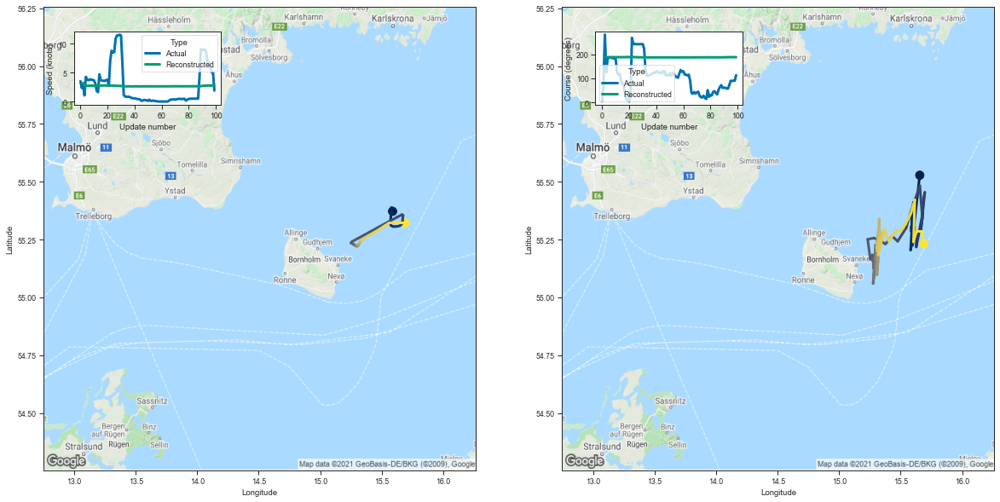

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.655584  55.528149  3.252344  188.732834         0.049420   
3   15.608014  55.307587  2.868522  188.681778         0.017384   
4   15.591894  55.311932  2.769097  188.821274         0.013301   
5   15.593553  55.349823  2.758225  188.892822         0.012881   
6   15.590981  55.295841  2.755722  188.723724         0.012948   
..        ...        ...       ...         ...              ...   
95  15.615469  55.421246  2.776331  189.174637         0.013360   
96  15.604512  55.239788  2.767333  188.622513         0.013035   
97  15.629653  55.286171  2.772467  188.716766         0.013061   
98  15.672557  55.284851  2.784509  188.842392         0.012957   
99  15.688162  55.231667  2.783166  188.716019         0.012955   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.158095     3.149024    101.277916                 1   
3         0.068073     2.934288    101.353218                

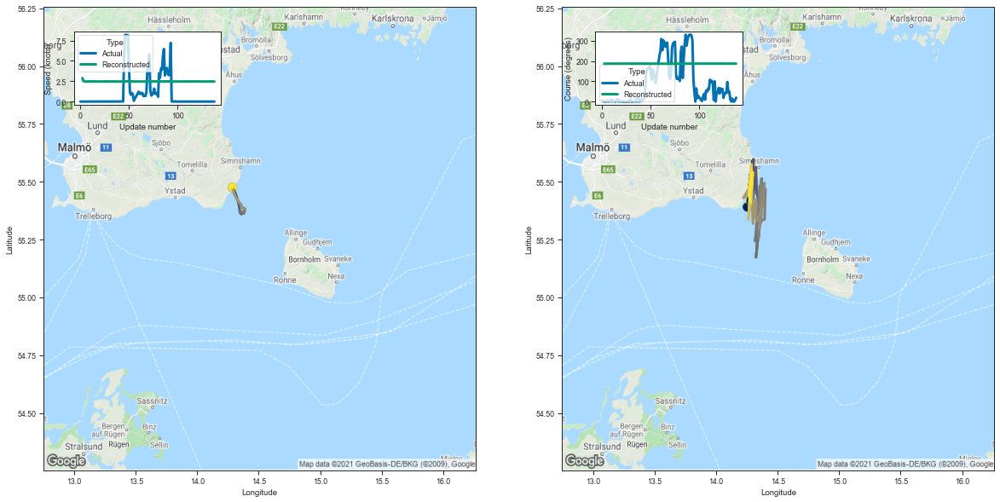

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.254322  55.390755  2.886492  186.448776         0.052616   
3    14.257758  55.423908  2.527738  187.031693         0.019228   
4    14.279873  55.443264  2.483495  187.179367         0.016329   
5    14.291217  55.463699  2.468378  187.198975         0.015646   
6    14.295243  55.491081  2.464670  187.330200         0.015665   
..         ...        ...       ...         ...              ...   
134  14.293368  55.491486  2.468996  187.303497         0.015737   
135  14.274220  55.459732  2.477275  187.258133         0.015665   
136  14.291994  55.535873  2.477253  187.463867         0.015754   
137  14.270673  55.476044  2.456075  187.224869         0.015703   
138  14.277608  55.413662  2.467293  187.035858         0.015658   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150820     3.554380     99.903549                 1   
3          0.068180     3.355157    100.320229 

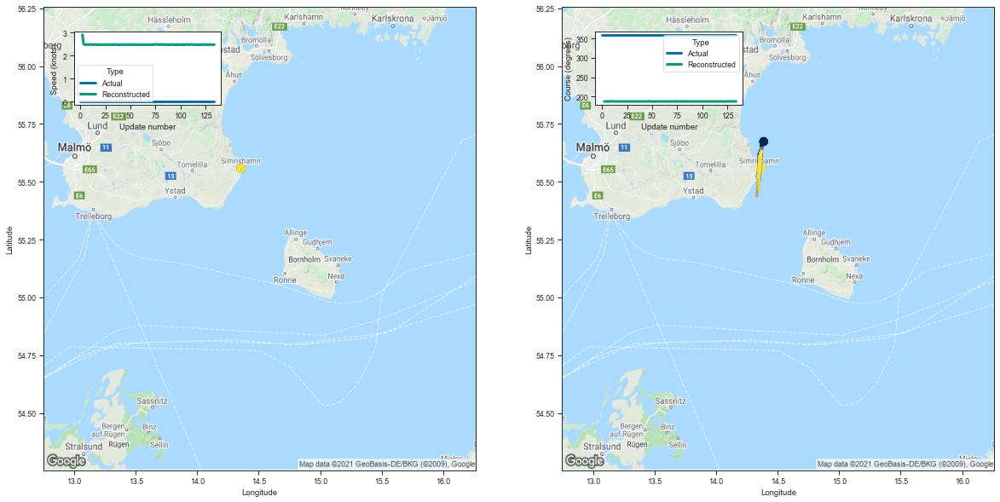

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.386426  55.673813  2.913408  187.313110         0.054291   
3    14.347301  55.618519  2.536002  187.745361         0.019024   
4    14.345000  55.512333  2.475907  187.473709         0.015816   
5    14.363299  55.586330  2.481527  187.696335         0.015295   
6    14.355144  55.554939  2.485567  187.598633         0.015445   
..         ...        ...       ...         ...              ...   
130  14.356233  55.559826  2.473102  187.571594         0.015296   
131  14.349020  55.572903  2.482080  187.625732         0.015383   
132  14.369056  55.631969  2.479443  187.839783         0.015263   
133  14.348330  55.541309  2.475185  187.474792         0.015343   
134  14.360833  55.559597  2.474854  187.577072         0.015376   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.159386     3.556157    100.373375                 1   
3          0.068802     3.355247    100.700836 

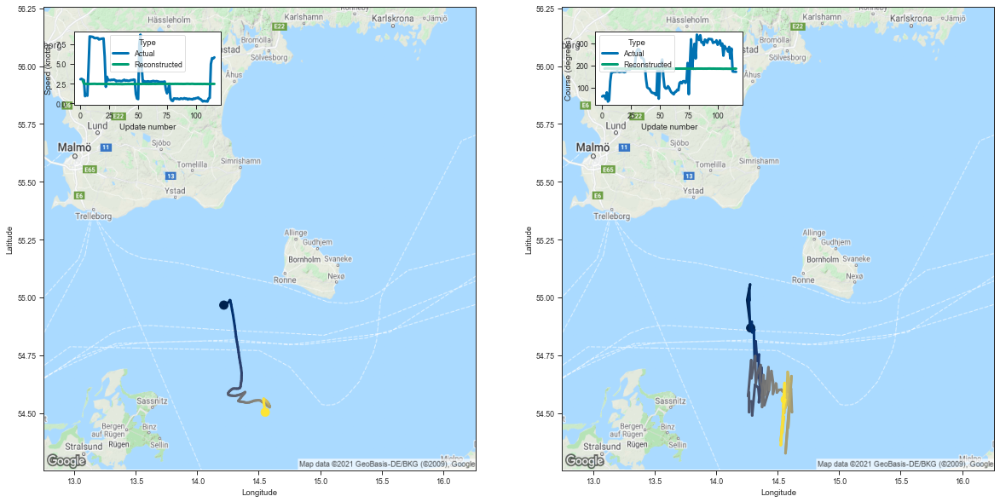

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.281219  54.867599  2.879178  184.823837         0.050922   
3    14.252325  54.988689  2.516135  185.689911         0.019009   
4    14.276369  55.055832  2.469565  185.995514         0.016041   
5    14.271096  55.038292  2.469135  185.893646         0.015426   
6    14.272293  54.987301  2.441728  185.742462         0.015232   
..         ...        ...       ...         ...              ...   
112  14.525237  54.360828  2.452896  184.157898         0.013184   
113  14.555634  54.572598  2.455197  184.886642         0.013269   
114  14.556307  54.629898  2.463885  185.031509         0.013482   
115  14.545834  54.526424  2.462226  184.720383         0.013468   
116  14.561727  54.558163  2.459601  184.885132         0.013427   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149186     3.455446     99.060989                 1   
3          0.068450     3.284833     99.612701 

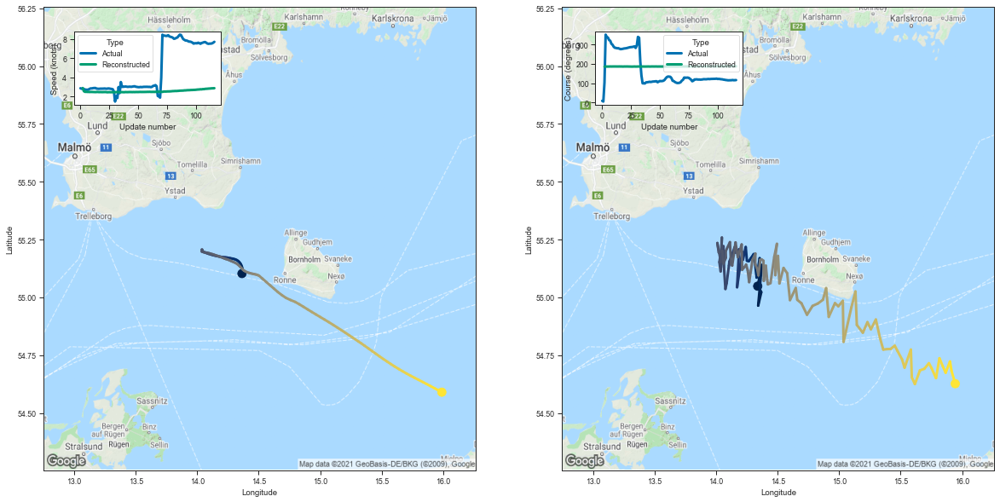

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.338153  55.048473  2.872427  185.354843         0.050710   
3    14.371395  55.139889  2.538120  186.326950         0.018339   
4    14.342037  54.964268  2.475509  185.803360         0.015449   
5    14.367058  55.022465  2.478260  186.018646         0.015084   
6    14.356338  55.034237  2.466745  185.990051         0.014899   
..         ...        ...       ...         ...              ...   
112  15.842256  54.702667  2.820718  187.333282         0.012597   
113  15.865885  54.673878  2.830864  187.343231         0.012643   
114  15.901340  54.722748  2.842520  187.470627         0.012759   
115  15.913704  54.682274  2.844155  187.362396         0.012867   
116  15.943844  54.626633  2.857089  187.292648         0.012776   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.151890     3.449006     99.343239                 1   
3          0.067230     3.248255     99.950035 

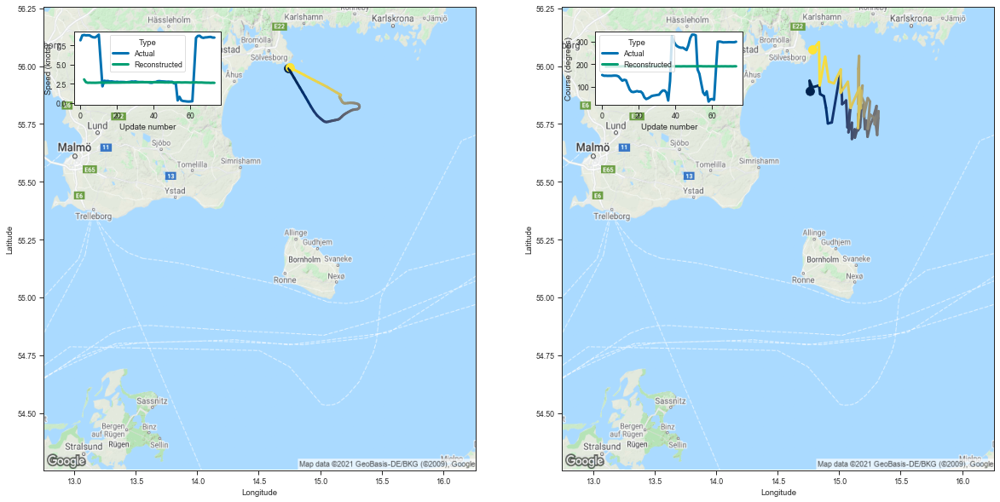

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.765409  55.890797  3.063846  188.686508         0.056192   
3   14.759955  55.936691  2.703818  189.313202         0.020512   
4   14.782994  55.908325  2.628564  189.386612         0.016282   
5   14.837047  55.916313  2.639999  189.500534         0.015715   
6   14.845753  55.879025  2.627487  189.385132         0.015412   
..        ...        ...       ...         ...              ...   
69  14.916973  55.932930  2.630691  189.636398         0.014942   
70  14.886271  56.040791  2.631069  189.925629         0.015187   
71  14.842390  55.916813  2.613967  189.452957         0.015233   
72  14.835613  56.103630  2.628687  190.025925         0.015432   
73  14.785935  56.070431  2.618239  189.899673         0.015572   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.159447     3.531739    101.149101                 1   
3         0.072476     3.340702    101.588654                

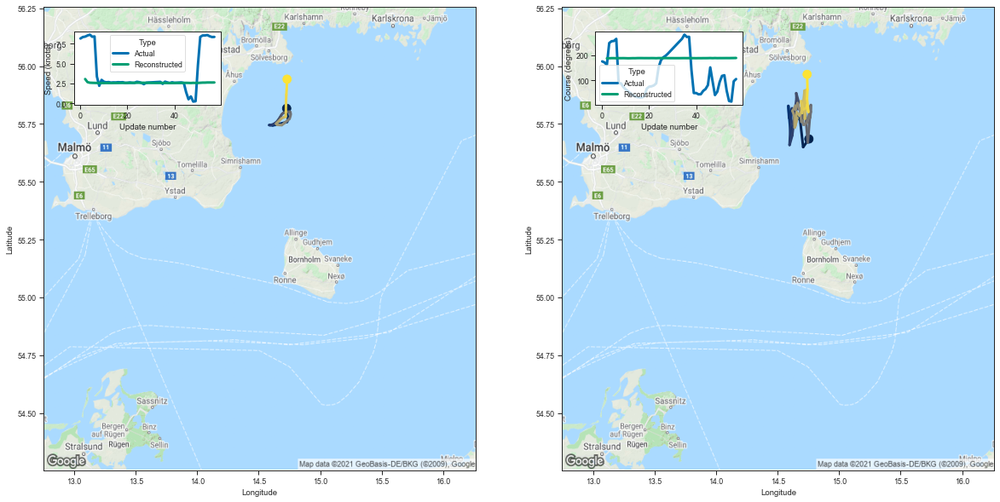

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.754327  55.685009  3.047156  187.897339         0.056077   
3   14.707599  55.649765  2.658617  188.400223         0.019102   
4   14.683185  55.765484  2.581555  188.767578         0.015920   
5   14.643939  55.793758  2.568175  188.781174         0.015574   
6   14.606671  55.700871  2.557546  188.441727         0.015450   
7   14.587374  55.827950  2.550352  188.787216         0.015396   
8   14.592774  55.776222  2.542762  188.639862         0.015144   
9   14.616501  55.817379  2.540102  188.811264         0.014879   
10  14.606890  55.762527  2.537231  188.572525         0.014924   
11  14.597127  55.658947  2.545475  188.254852         0.014897   
12  14.618946  55.700043  2.540933  188.388123         0.014678   
13  14.637926  55.784462  2.541664  188.704102         0.014853   
14  14.626155  55.748974  2.541640  188.590973         0.014907   
15  14.653269  55.859249  2.547737  188.982513         0.01467

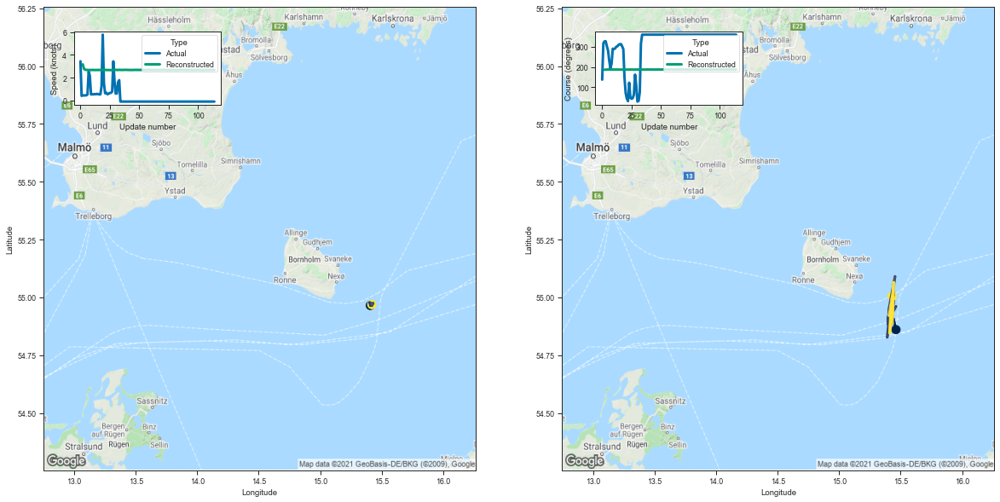

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.462309  54.860394  3.164057  186.395081         0.045605   
3    15.442354  54.906002  2.780054  187.170761         0.015956   
4    15.410480  54.894360  2.686358  187.231628         0.012458   
5    15.435886  55.024929  2.678359  187.642197         0.012155   
6    15.426943  54.999023  2.674752  187.521454         0.012072   
..         ...        ...       ...         ...              ...   
110  15.443697  55.065018  2.677511  187.744888         0.012143   
111  15.434784  54.928005  2.686212  187.367432         0.012148   
112  15.432386  54.936031  2.676866  187.348709         0.012123   
113  15.410549  54.845020  2.677180  187.018814         0.012141   
114  15.430930  55.005116  2.676163  187.520752         0.012029   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.151218     3.056084    100.027695                 1   
3          0.065278     2.870085    100.535637 

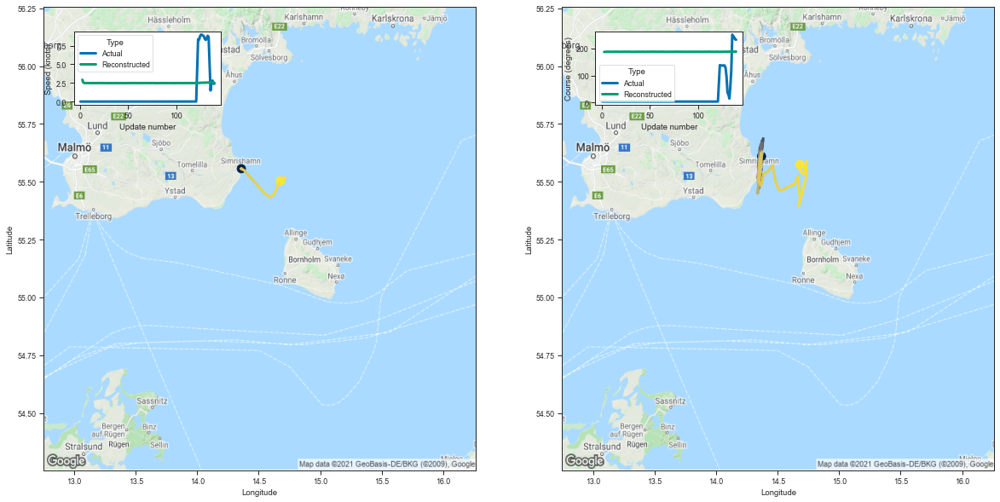

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.369246  55.609772  2.933991  187.028870         0.055971   
3    14.345111  55.470970  2.547497  187.256973         0.019085   
4    14.366416  55.553711  2.490168  187.600418         0.015953   
5    14.353743  55.496258  2.482266  187.413788         0.015524   
6    14.370065  55.621338  2.478174  187.812057         0.015457   
..         ...        ...       ...         ...              ...   
136  14.733959  55.588966  2.566193  188.280853         0.014821   
137  14.710299  55.533550  2.532390  188.016724         0.013810   
138  14.683105  55.547695  2.532111  188.070389         0.014206   
139  14.683230  55.574936  2.526233  188.120941         0.014041   
140  14.679556  55.573963  2.522703  188.115875         0.014034   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.162116     3.572708    100.235909                 1   
3          0.069091     3.335042    100.450188 

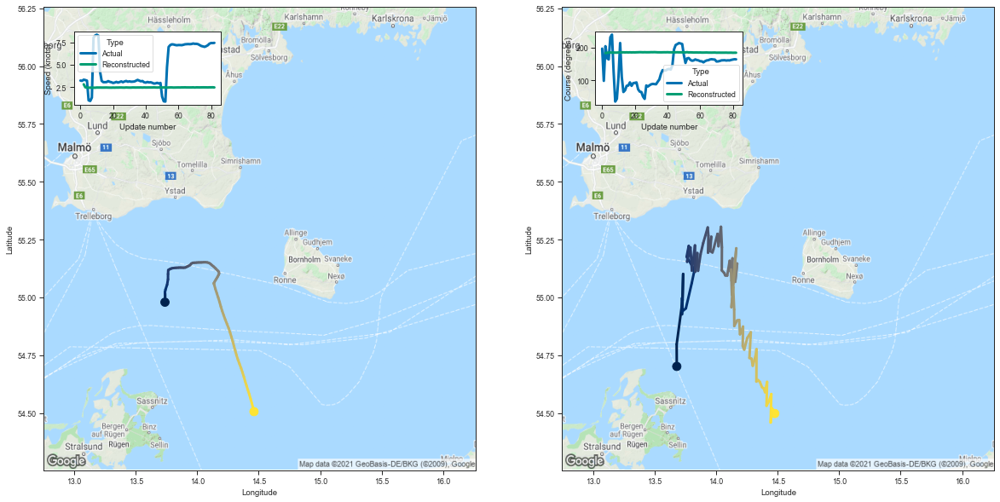

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.680280  54.701340  2.803428  183.429520         0.061239   
3   13.679358  54.797165  2.468368  184.327759         0.023322   
4   13.727772  54.988663  2.431850  185.041306         0.020251   
5   13.732115  55.101048  2.425765  185.336807         0.020032   
6   13.722540  54.926670  2.425412  184.873489         0.019529   
..        ...        ...       ...         ...              ...   
78  14.432241  54.554203  2.453850  184.663269         0.014118   
79  14.448827  54.581867  2.464207  184.785736         0.014167   
80  14.443637  54.458450  2.461786  184.410812         0.014037   
81  14.454811  54.520470  2.468423  184.610168         0.014234   
82  14.476834  54.497627  2.450861  184.565872         0.013849   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.162179     3.677284     98.248772                 1   
3         0.073780     3.531172     98.831360                

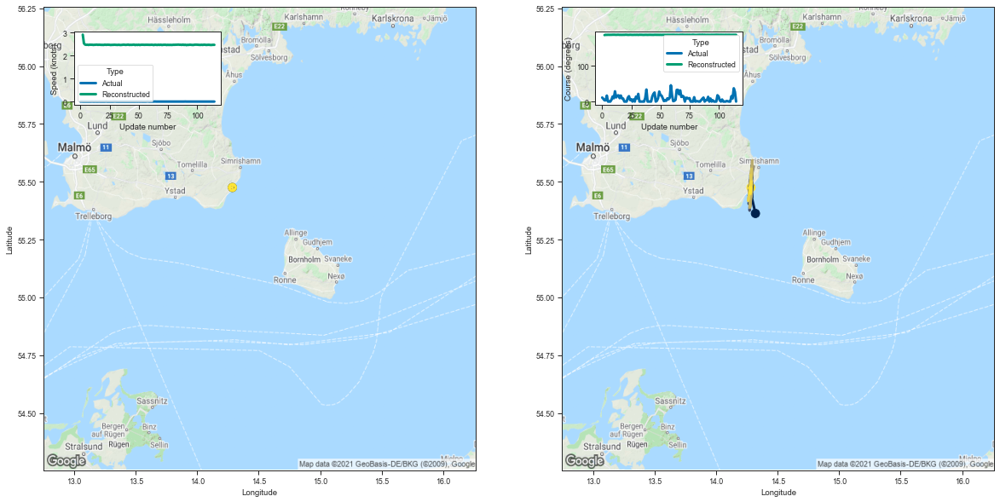

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.319702  55.362831  2.912643  186.389343         0.053128   
3    14.273658  55.470226  2.533255  187.189499         0.019352   
4    14.265455  55.405006  2.478234  187.025360         0.016359   
5    14.296080  55.486828  2.469344  187.283249         0.015771   
6    14.292022  55.432468  2.473843  187.145691         0.015592   
..         ...        ...       ...         ...              ...   
111  14.274514  55.449661  2.467245  187.131287         0.015816   
112  14.275647  55.457161  2.461139  187.167038         0.015569   
113  14.271424  55.476822  2.465113  187.213364         0.015663   
114  14.278980  55.451656  2.469885  187.155777         0.015731   
115  14.284047  55.475048  2.467644  187.239090         0.015615   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.153888     3.528060     99.879707                 1   
3          0.069338     3.361346    100.405823 

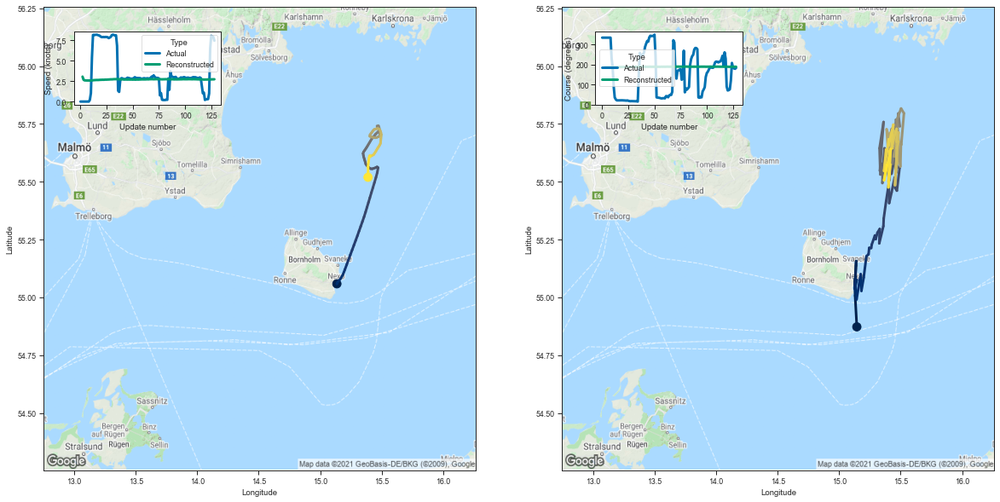

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.143938  54.872444  3.057617  186.049118         0.044481   
3    15.130122  55.006981  2.669775  187.018188         0.015679   
4    15.128105  55.055450  2.599385  187.214066         0.012628   
5    15.138591  55.156918  2.593287  187.532700         0.012333   
6    15.130327  55.050617  2.585664  187.239975         0.012261   
..         ...        ...       ...         ...              ...   
124  15.420075  55.641479  2.709070  189.490051         0.013016   
125  15.381763  55.548912  2.718029  189.197266         0.013368   
126  15.365580  55.505920  2.726565  189.064438         0.013661   
127  15.387147  55.573372  2.726255  189.307236         0.013708   
128  15.388361  55.571434  2.734007  189.337936         0.013713   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.143938     3.148331     99.811623                 1   
3          0.063568     2.967707    100.418335 

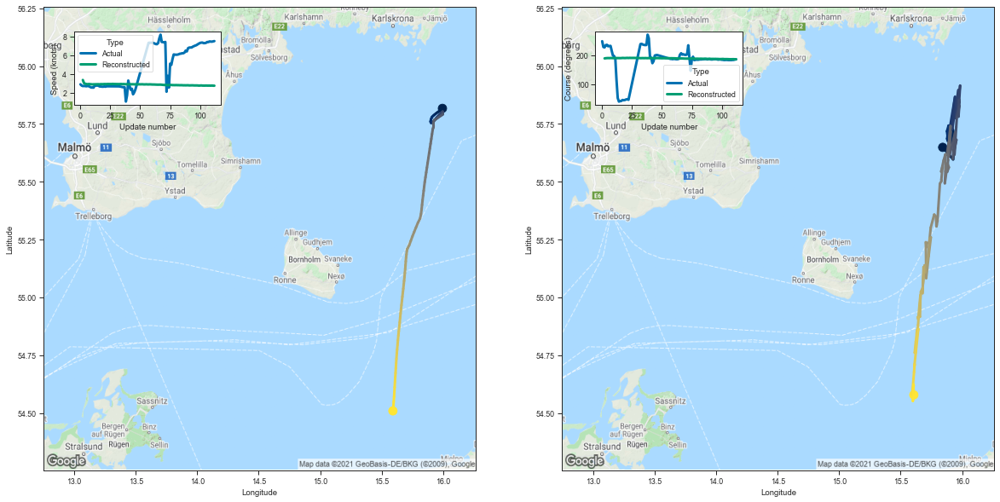

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.842067  55.648766  3.342631  189.481186         0.051910   
3    15.926697  55.596649  3.001731  190.058319         0.018853   
4    15.943517  55.675362  2.931851  190.442322         0.015100   
5    15.924604  55.725979  2.909659  190.642654         0.014230   
6    15.910332  55.670677  2.890259  190.425018         0.014140   
..         ...        ...       ...         ...              ...   
108  15.598880  54.589348  2.739631  186.584991         0.012429   
109  15.606084  54.617451  2.732421  186.715302         0.012231   
110  15.604528  54.623405  2.744798  186.736633         0.012393   
111  15.599442  54.551792  2.728236  186.470627         0.012266   
112  15.607265  54.578323  2.728044  186.572205         0.012238   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.162754     3.137473    101.692223                 1   
3          0.071605     2.940552    102.118935 

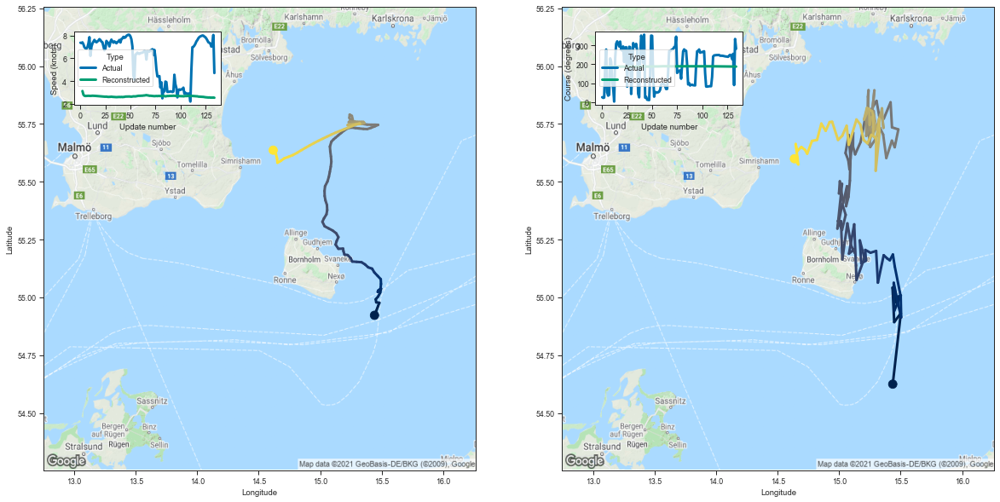

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.435901  54.624676  3.134144  185.811020         0.042891   
3    15.501716  54.931305  2.813105  187.391403         0.016373   
4    15.447825  54.892925  2.718901  187.316849         0.013012   
5    15.434242  55.042034  2.699154  187.715179         0.012884   
6    15.466794  54.976528  2.706382  187.564514         0.012513   
..         ...        ...       ...         ...              ...   
130  14.692892  55.650448  2.558023  188.394150         0.014759   
131  14.658834  55.632149  2.555340  188.255936         0.015071   
132  14.646804  55.663101  2.554392  188.364059         0.014918   
133  14.667824  55.574795  2.562038  188.142456         0.015014   
134  14.636256  55.599609  2.545624  188.134277         0.014981   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.139386     3.035109     99.729340                 1   
3          0.066146     2.888091    100.662827 

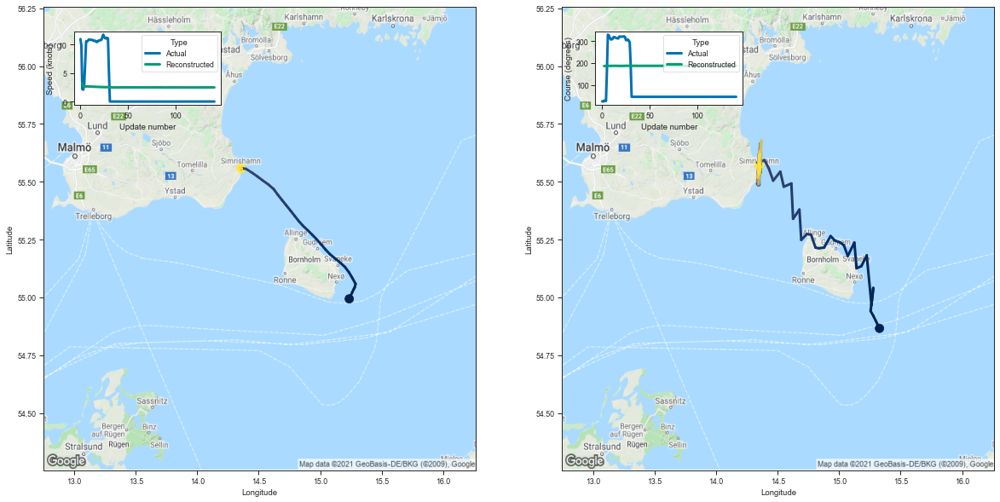

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.328047  54.865887  3.157493  186.357849         0.048693   
3    15.278274  54.919907  2.731002  187.064743         0.015748   
4    15.255964  54.940887  2.650230  187.165741         0.012766   
5    15.277763  55.040516  2.635811  187.450760         0.012327   
6    15.263288  54.966309  2.645959  187.185349         0.012710   
..         ...        ...       ...         ...              ...   
137  14.347134  55.587074  2.483598  187.632874         0.015494   
138  14.346278  55.537289  2.484927  187.552277         0.015416   
139  14.361197  55.565037  2.485930  187.639954         0.015400   
140  14.349453  55.577831  2.472913  187.606033         0.015365   
141  14.349935  55.571964  2.483133  187.621002         0.015409   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.153679     3.133368     99.985397                 1   
3          0.063380     2.924426    100.462051 

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
102,102,2204657,230069190,Fishing,141,-469.092834,-3.326900
4,4,2259131,230069190,Fishing,141,-472.319763,-3.349786
45,45,3713619,261003310,Fishing,92,-309.333252,-3.362318
29,29,6787151,265759000,Fishing,143,-481.006531,-3.363682
70,70,2240973,230069190,Fishing,141,-475.951355,-3.375542
...,...,...,...,...,...,...,...
57,57,4868710,265551874,Fishing,116,-588.650024,-5.074569
80,80,2458890,261001400,Fishing,129,-655.960327,-5.084964
33,33,4352040,261015270,Fishing,113,-576.797668,-5.104404
49,49,1557318,219021428,Fishing,135,-696.588196,-5.159913


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    # print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
    print(tracks['Reconstructed trajectory'])
df_n